# Anomaly detection - Exercise

Sami BOUKEZZOULA

## Context

Aircraft systems are recording values of parameters such as speed, temperature, pressure, electrical current values... The studied dataset (in the file 'dataset.csv') contains 11 parameters recorded: p1, p2, p3, …, p11. More precisely, the dataset is composed of different windows, which are sections of measures of these parameters (up to 100 points by window). Each window is labeled by the parameter 'day_cycle_window' : for instance, the window, whose parameter 'day_cycle_window' is 4_2_1, represents the window 1 of the cycle 2 of the day 4.

*It is asked to "build an algorithm to detect windows that are abnormal".*

## Problem formulation

Analysis of the data provided shows that it is multivariate and temporal, with each “window” comprising up to 100 measurement points of the parameters recorded on each cycle and day. The aim is to detect **abnormal windows**, which means identifying **sets of measurements that differ stastically from the others**.

Indeed, without any more piece of information (among others what are the characteristics of "normal windows"), we can only compare their statiscal characteristics. Thus, in the following notebook, we will name *"anomalous windows"* or *"abnormal windows"* all the windows that have statiscal characteristics (mean, standard deviation, etc.) significantly different from the others (**under the hypothesis that there should be anomalies quite infrequently**).

As mentionned above, there are neither known examples of "normal windows" nor "abnormal windows". Therefore, it limits the use of supervised techniques, that requires a sample of labeled windows to perform supervised classification methods. This is the reason why only **unsupervised techniques** (such as MCD, Isolation Forest, One Class SVM or LOF) will be explored in this notebook. Additionnaly, we will not be able to ensure wether the windows detected by these algorithms as different are "real anomalies" or not. The same issue will happen when it comes to compute some performance metrics of these methods.

Finally, anomalies may be subtle or influenced by complex relationships between parameters (for example, certain temperature values may be normal if pressure is within a certain range, but abnormal otherwise). It is also not possible to take into account some natural variability : since actual flight conditions (temperature, speed, pressure) vary over time, it is difficult to detect anomalies simply by comparing raw values (or even their statistical characteristics).

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.covariance import EllipticEnvelope
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM

In [3]:
### Reading the dataset
df = pd.read_csv("dataset.csv")

A first approach consists in considering the means of each parameter on each window.

In [4]:
### Data preprocessing

# Creating the dataframe containing the means of each parameters within each window
df[['day', 'cycle', 'window']] = df['day_cycle_window'].str.split('_', expand=True)
df[['day', 'cycle', 'window']] = df[['day', 'cycle', 'window']].astype(int)
df_means = df.groupby('day_cycle_window').mean().reset_index()
df_means = df_means.sort_values(by=['day', 'cycle', 'window']).reset_index(drop=True)
df_means = df_means.drop(columns=['day', 'cycle', 'window'])
df_means.head

<bound method NDFrame.head of      day_cycle_window        p1        p2        p3        p4        p5  \
0               1_1_1 -1.926141 -2.456284 -2.487394 -2.481230 -2.388674   
1               1_1_2 -1.714067 -2.217161 -2.530537 -2.515985 -2.544961   
2               1_1_3 -1.534357 -1.779994 -1.938747 -1.835152 -2.053982   
3               1_1_4 -1.415197 -1.453962 -1.888438 -2.249327 -2.206560   
4               1_1_5 -0.732715 -0.634379 -0.963247 -1.871178 -2.048933   
...               ...       ...       ...       ...       ...       ...   
1632          4_4_156 -0.956537 -1.347865 -1.277796 -1.489708 -1.259816   
1633          4_4_157 -0.984032 -1.350121 -1.296572 -1.473924 -1.277888   
1634          4_4_158 -1.006301 -1.363260 -1.319295 -1.484471 -1.289714   
1635          4_4_159 -1.013992 -1.368401 -1.323755 -1.506278 -1.304717   
1636          4_4_160 -0.485387 -0.623397 -0.630989 -0.841035 -0.861749   

            p6        p7        p8        p9       p10       p11  
0 

In [5]:
colors = ['#FF0000','#FF8000','#FFFF00','#80FF00','#00FF80','#00FFFF','#0000FF','#7F00FF','#FF00FF','#FF007F','#000000']
parameters = ['p1','p2','p3','p4','p5','p6','p7','p8','p9','p10','p11']

In [6]:
def plot_time_series(df,param):
    """
    Plot the time series of the parameter param (str : 'p1','p2',...,'p11')
    """
    fig, ax = plt.subplots()
    ax.scatter(df['day_cycle_window'],df[param],marker='.',c=colors[int(param[1:])-1])
    ax.set_xlabel('day_cycle_window')
    ax.set_ylabel(f"Average value of {param} by window")
    ax.set_xticks(df['day_cycle_window'][::100])
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

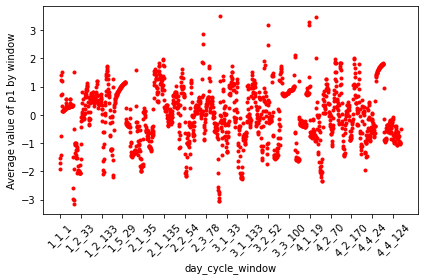

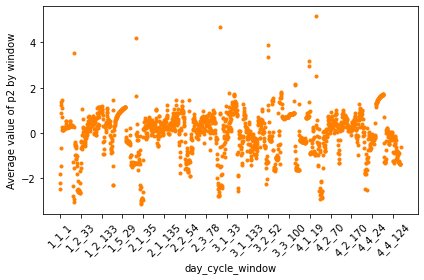

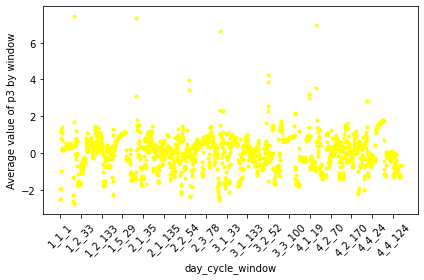

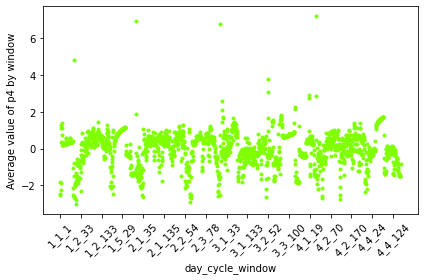

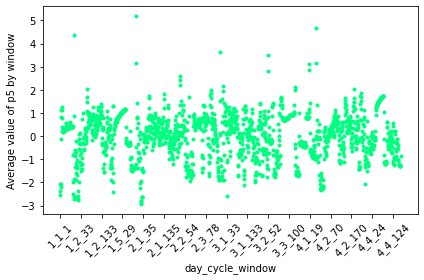

...

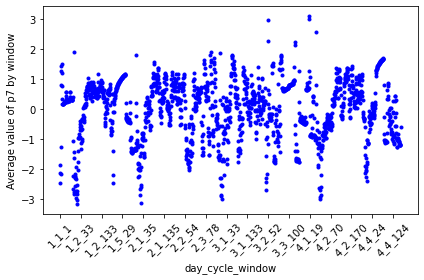

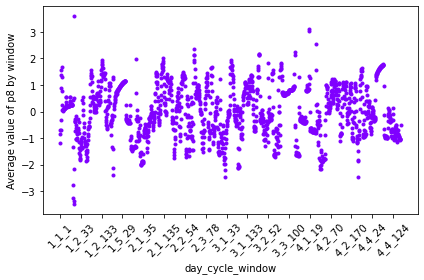

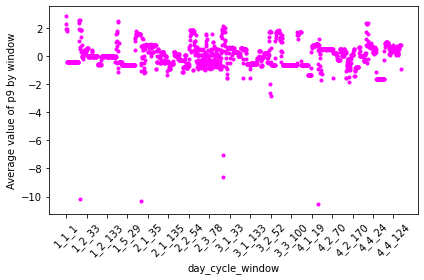

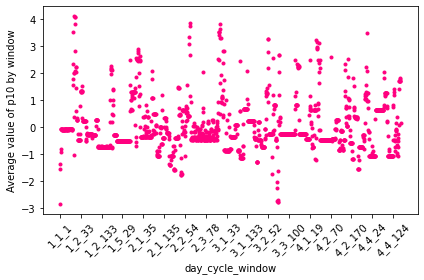

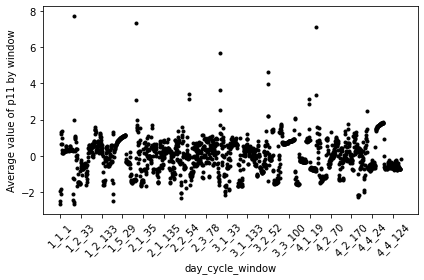

In [7]:
# Visualize the time series of the means by window for each parameter
for k in range(1,12):
    plot_time_series(df_means,f'p{k}')

Let's tune the hyperparameters for each method

In [8]:
# Elliptic envelope (MCD)

# Hyperparameters tuning
contamination = [0.01, 0.05, 0.1]

for c in contamination:
    # Initializing model with current values of tested hyperparameters
    model = EllipticEnvelope(contamination=c,random_state=42)

    # Model fitting and anomaly prediction
    predictions = model.fit_predict(df_means[parameters])

    # Displaying results
    print(f"contamination={c}")
    print(f"Anomalies détectées: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

contamination=0.01
Anomalies détectées: 17 / 1636

contamination=0.05
Anomalies détectées: 82 / 1636

contamination=0.1
Anomalies détectées: 164 / 1636



In [9]:
# Isolation Forest

import warnings
warnings.filterwarnings('ignore')

# Hyperparameters tuning
n_estimators = [5,10,100]
max_samples = [0.5, 0.75, 1.0]
contamination = [0.01, 0.05, 0.1]
max_features = [5, 8, 11]

# Iterating on hyperparameters values
for n in n_estimators:
    for sample in max_samples:
        for contam in contamination:
            for features in max_features:
                # Initializing model with current values of tested hyperparameters
                model = IsolationForest(n_estimators=n, max_samples=sample,
                                        contamination=contam, max_features=features,random_state=42)
                # Model fitting
                model.fit(df_means[parameters])
                
                # Anomaly detection
                predictions = model.predict(df_means[parameters])
                
                # Displaying results
                print(f"n_estimators={n}, max_samples={sample}, contamination={contam}, max_features={features}")
                print(f"Anomalies détectées: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

n_estimators=5, max_samples=0.5, contamination=0.01, max_features=5
Anomalies détectées: 17 / 1636

n_estimators=5, max_samples=0.5, contamination=0.01, max_features=8
Anomalies détectées: 17 / 1636

n_estimators=5, max_samples=0.5, contamination=0.01, max_features=11
Anomalies détectées: 17 / 1636

n_estimators=5, max_samples=0.5, contamination=0.05, max_features=5
Anomalies détectées: 82 / 1636

n_estimators=5, max_samples=0.5, contamination=0.05, max_features=8
Anomalies détectées: 82 / 1636

n_estimators=5, max_samples=0.5, contamination=0.05, max_features=11
Anomalies détectées: 82 / 1636

n_estimators=5, max_samples=0.5, contamination=0.1, max_features=5
Anomalies détectées: 164 / 1636

n_estimators=5, max_samples=0.5, contamination=0.1, max_features=8
Anomalies détectées: 164 / 1636

n_estimators=5, max_samples=0.5, contamination=0.1, max_features=11
Anomalies détectées: 164 / 1636

n_estimators=5, max_samples=0.75, contamination=0.01, max_features=5
Anomalies détectées: 17 / 16

In [10]:
# Local Outlier Factor (LOF)

# Hyperparameters tuning
contamination = [0.01, 0.05, 0.1]
n_neighbors = [5,10,15,30,50,100]

# Iterating on hyperparameters values
for n in n_neighbors:
    for c in contamination:
        # Initializing model with current tested hyperparameters values
        model = LocalOutlierFactor(n_neighbors=n, contamination=c, novelty=False)

        # Model fitting and anomaly detection
        predictions = model.fit_predict(df_means[parameters])

        # Displaying results
        print(f"n_neighbors={n}, contamination={c}")
        print(f"Anomalies détectées: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

n_neighbors=5, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=5, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=5, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=10, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=10, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=10, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=15, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=15, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=15, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=30, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=30, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=30, contamination=0.1
Anomalies détectées: 164 / 1636

n_neighbors=50, contamination=0.01
Anomalies détectées: 17 / 1636

n_neighbors=50, contamination=0.05
Anomalies détectées: 82 / 1636

n_neighbors=50, contamination=0.1
Anomalies détectées: 164 / 1636

In [11]:
# One Class SVM

# Hyperparameters tuning
nu = [0.01, 0.05, 0.1]
gamma = ['auto',0.01,0.05,0.1]

# Iterating on hyperparameters values
for n in nu:
    for g in gamma:
        # Initializing model with current values of hyperparameters
        model = OneClassSVM(nu=n, kernel="rbf", gamma=g)
        
        # Training model
        model.fit(df_means[parameters])

        # Anomaly prediction
        predictions = model.predict(df_means[parameters])

        # Displaying results
        print(f"nu={n}, gamma={g}")
        print(f"Anomalies détectées: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

nu=0.01, gamma=auto
Anomalies détectées: 38 / 1636

nu=0.01, gamma=0.01
Anomalies détectées: 18 / 1636

nu=0.01, gamma=0.05
Anomalies détectées: 22 / 1636

nu=0.01, gamma=0.1
Anomalies détectées: 38 / 1636

nu=0.05, gamma=auto
Anomalies détectées: 83 / 1636

nu=0.05, gamma=0.01
Anomalies détectées: 83 / 1636

nu=0.05, gamma=0.05
Anomalies détectées: 83 / 1636

nu=0.05, gamma=0.1
Anomalies détectées: 81 / 1636

nu=0.1, gamma=auto
Anomalies détectées: 162 / 1636

nu=0.1, gamma=0.01
Anomalies détectées: 165 / 1636

nu=0.1, gamma=0.05
Anomalies détectées: 164 / 1636

nu=0.1, gamma=0.1
Anomalies détectées: 165 / 1636



Let's visualize the results

In [12]:
def plotAnomalyScore(df, clf_name, clf, param):
    """
        df: Pandas DataFrame containing all the points to plot (for features p1 to p11)
        clf_name: String value - name of the outlier detection model
        clf: Scikit Learn model instance - the trained outlier detection model
        
        return: Pandas DataFrame containing the abnormal windows according to the outlier detection model (format day_cycle_window)
    """
    if clf_name == 'Local Outlier Factor':
        score = clf.negative_outlier_factor_
        is_anomaly = clf.fit_predict(df[param])
    else:
        score = clf.decision_function(df[param])
        is_anomaly = clf.predict(df[param])
        
    x_anomaly = df['day_cycle_window'][is_anomaly == -1]
    
    for p in param:
        y_anomaly = df[p][is_anomaly == -1]
        fig, ax = plt.subplots(figsize=(30, 10))
        sc = ax.scatter(df['day_cycle_window'],df[p],marker='.',c=-score, cmap='rainbow')
        ax.scatter(x_anomaly,y_anomaly,marker='s',facecolors='none',edgecolor='blue', s=75,label='Abnormal window')
        plt.colorbar(sc, label='anomaly score')
        ax.set_xlabel('Time')
        ax.set_ylabel(p)
        ax.set_xticks(df['day_cycle_window'][::100])
        plt.xticks(rotation=45)
        plt.legend()
        plt.title(f'{clf_name} - {p}')
        plt.show(block=True)
        
    return is_anomaly

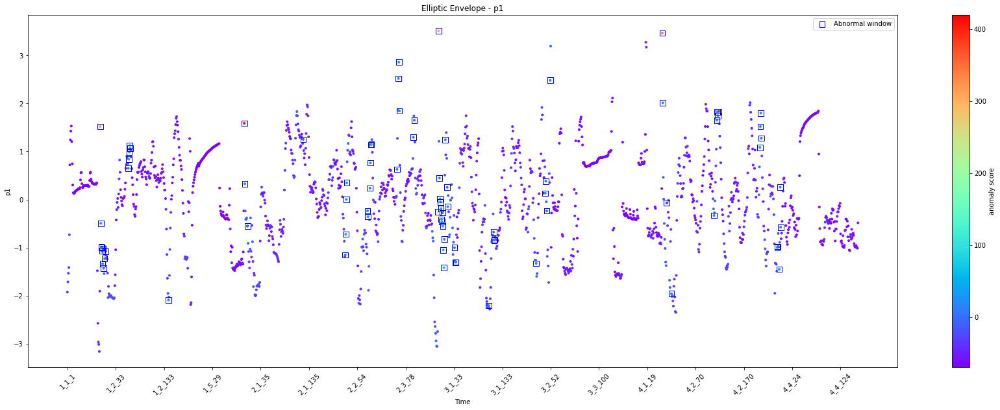

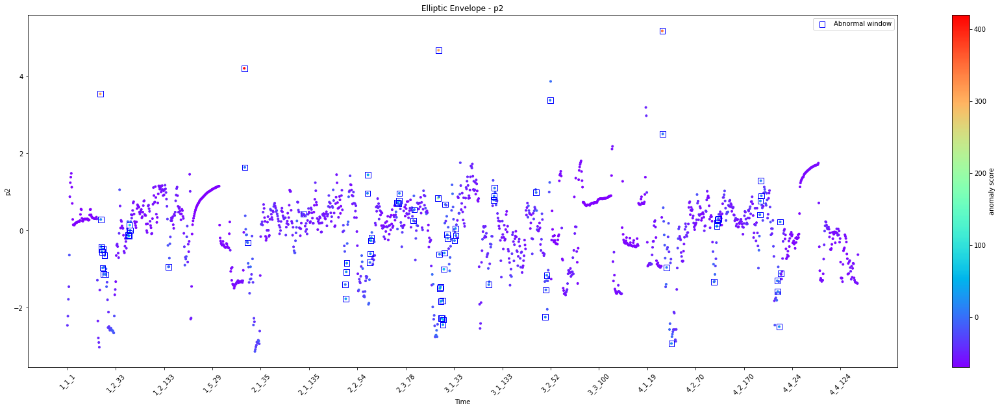

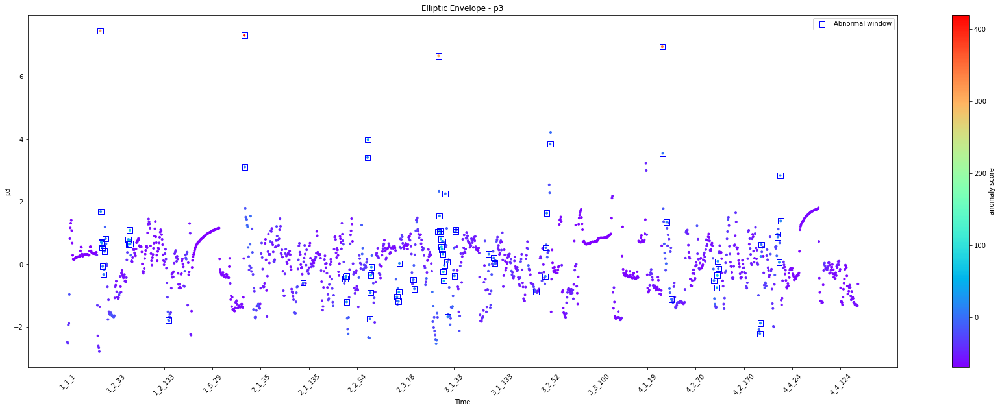

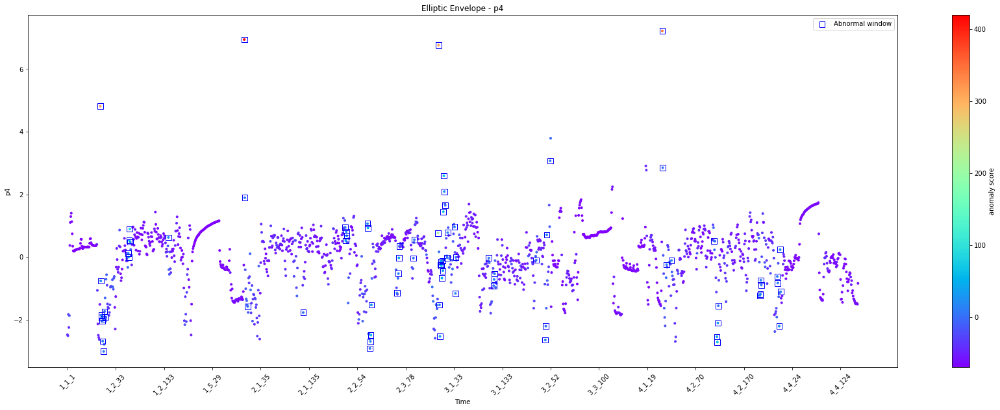

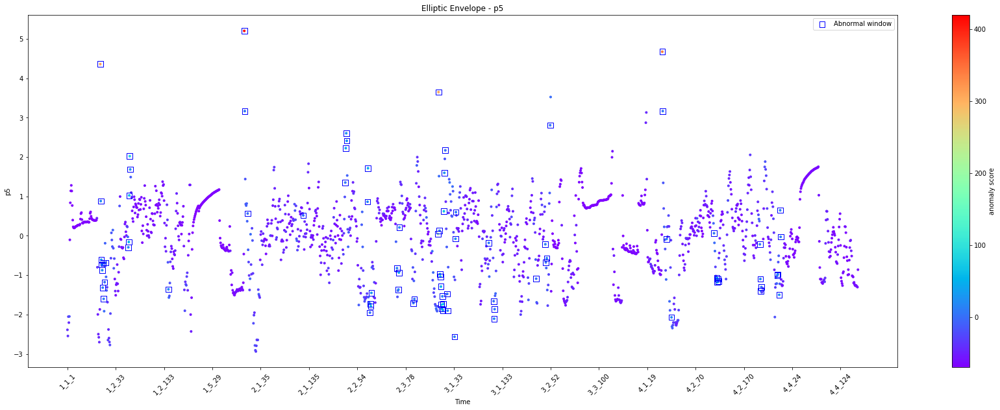

...

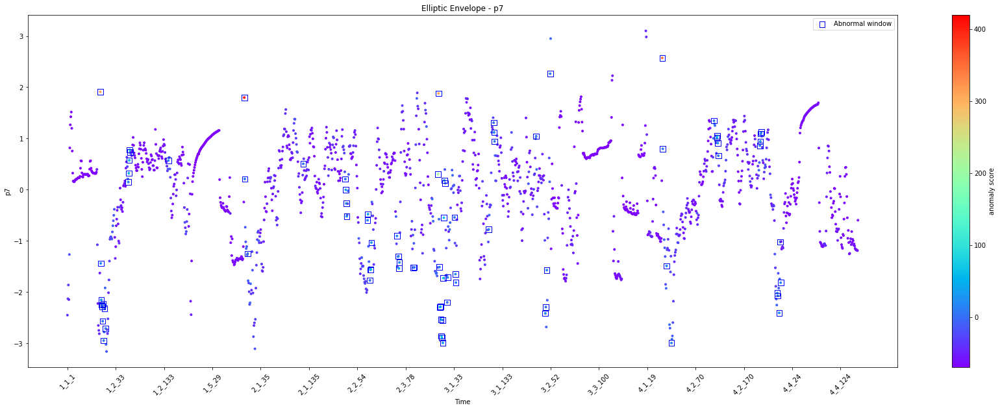

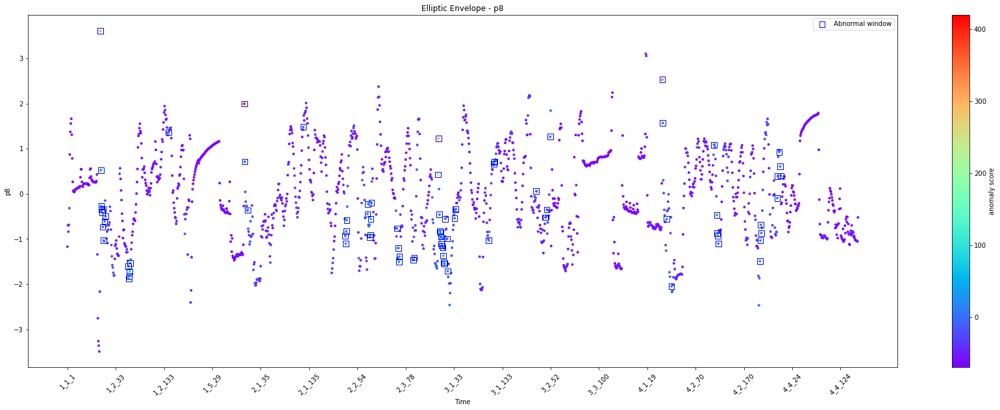

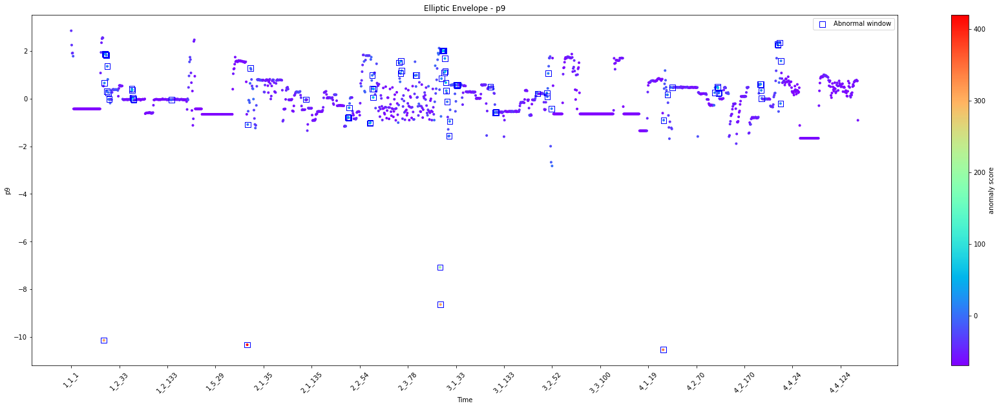

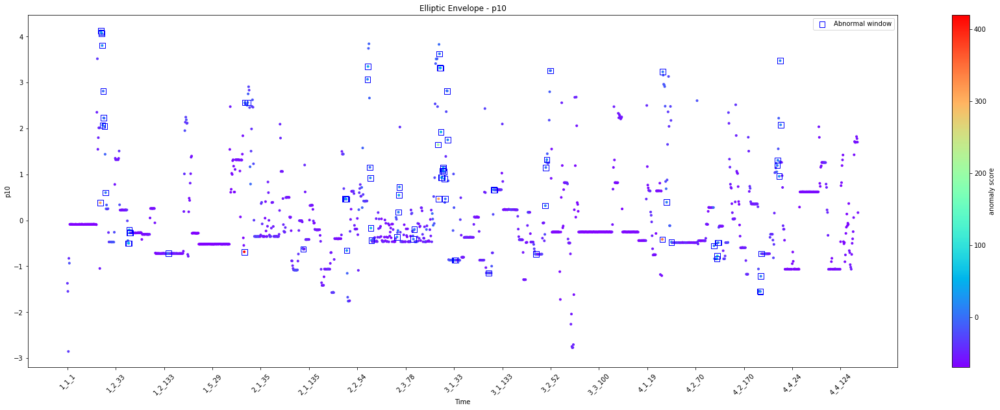

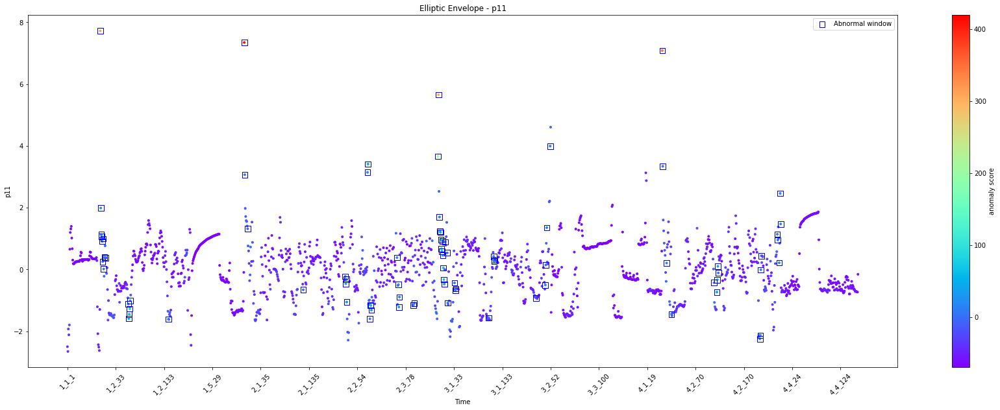

Detected abnormal windows: 82 / 1636

['1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_10'
 '1_2_12' '1_2_59' '1_2_60' '1_2_61' '1_2_62' '1_2_63' '1_2_142' '2_1_1'
 '2_1_2' '2_1_8' '2_1_123' '2_2_29' '2_2_30' '2_2_31' '2_2_32' '2_2_75'
 '2_2_76' '2_3_4' '2_3_5' '2_3_6' '2_3_7' '2_3_60' '2_3_63' '2_3_64'
 '2_3_65' '2_3_94' '2_3_96' '2_3_145' '3_1_1' '3_1_3' '3_1_4' '3_1_5'
 '3_1_6' '3_1_7' '3_1_8' '3_1_9' '3_1_10' '3_1_11' '3_1_12' '3_1_13'
 '3_1_15' '3_1_19' '3_1_20' '3_1_34' '3_1_36' '3_1_37' '3_1_105' '3_1_115'
 '3_1_116' '3_1_117' '3_2_22' '3_2_41' '3_2_42' '3_2_44' '3_2_51' '4_2_1'
 '4_2_2' '4_2_10' '4_2_20' '4_2_108' '4_2_114' '4_2_115' '4_2_116'
 '4_2_117' '4_3_22' '4_3_23' '4_3_24' '4_3_25' '4_3_58' '4_3_59' '4_3_62'
 '4_3_64' '4_3_65']


In [13]:
clf_name = 'Elliptic Envelope'
clf = EllipticEnvelope(contamination=0.05,random_state=42)
clf.fit(df_means[parameters])
is_anomaly_elliptic = plotAnomalyScore(df_means, clf_name, clf, parameters)
abnormal_windows_elliptic = df_means['day_cycle_window'][is_anomaly_elliptic==-1]
print(f"Detected abnormal windows: {abnormal_windows_elliptic.count()} / {df_means.shape[0]-1}\n")
print(abnormal_windows_elliptic.to_numpy())

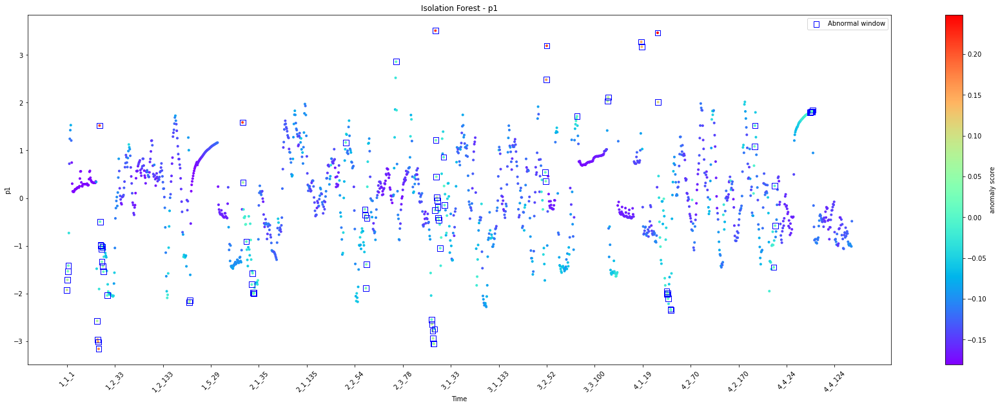

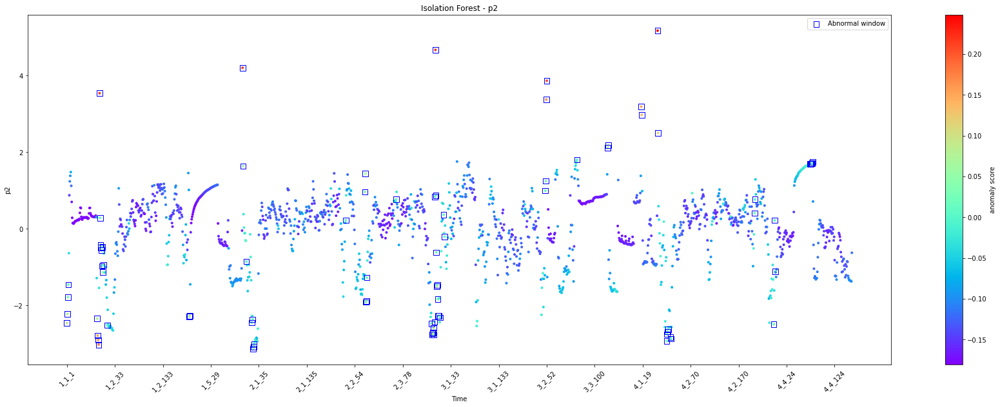

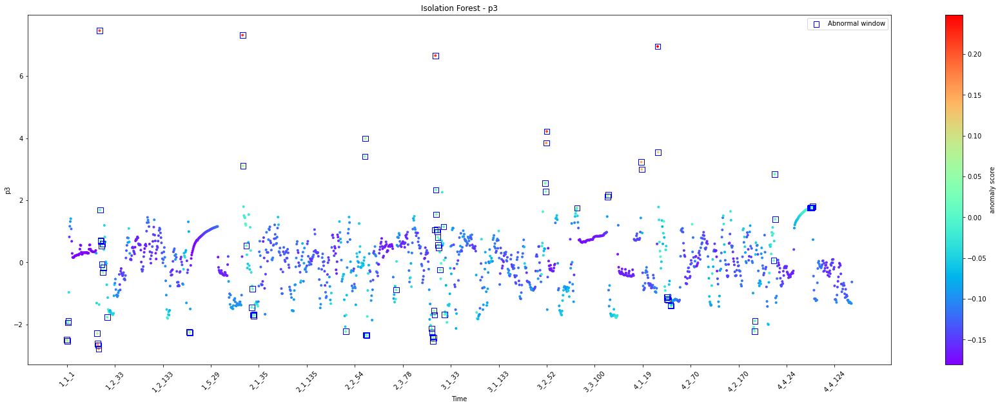

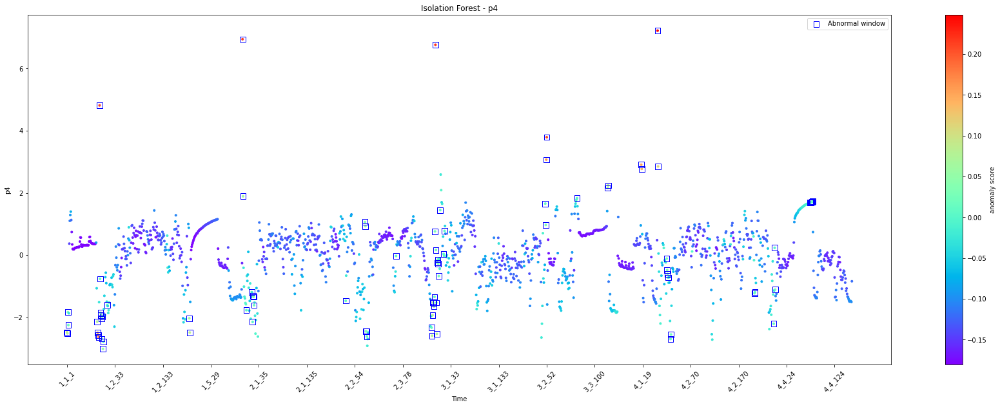

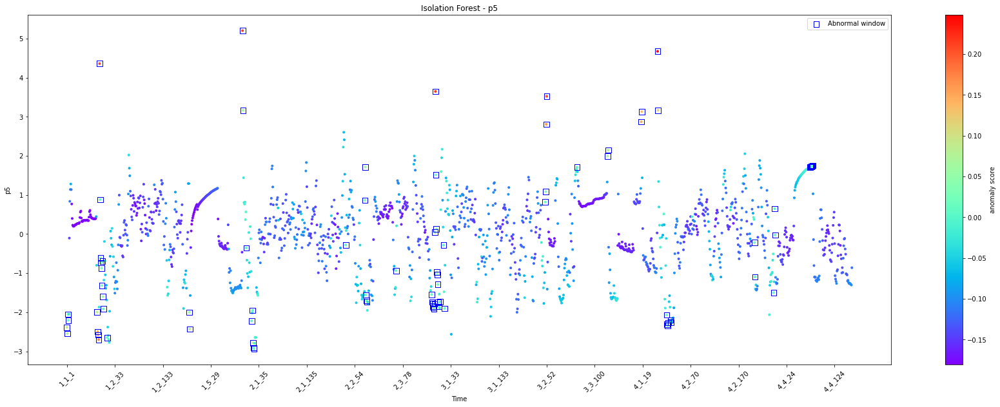

...

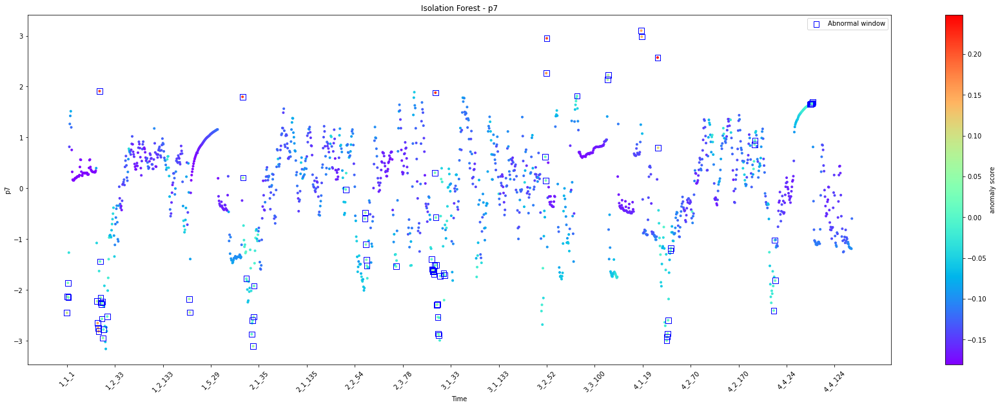

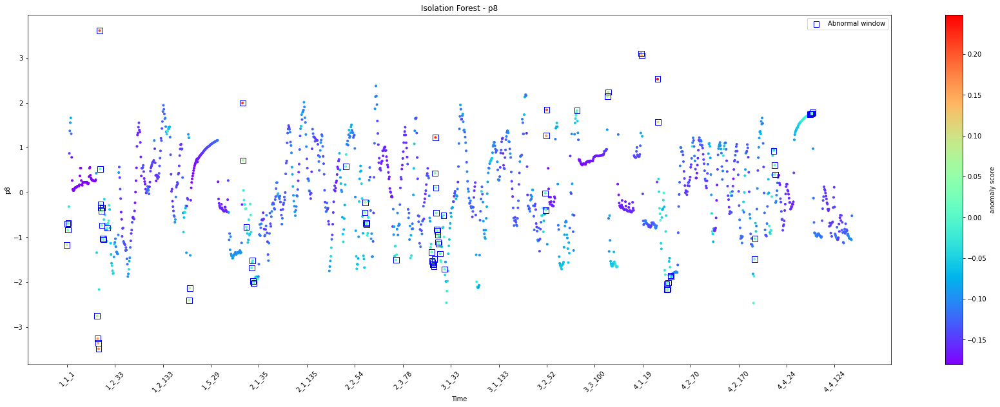

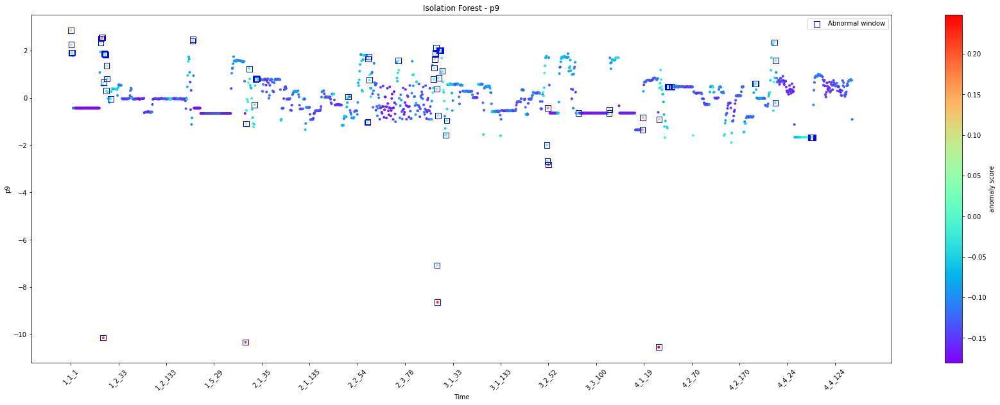

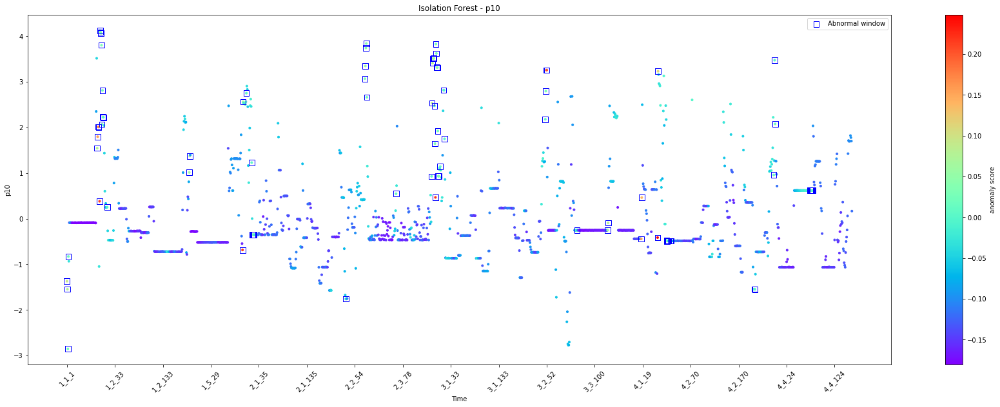

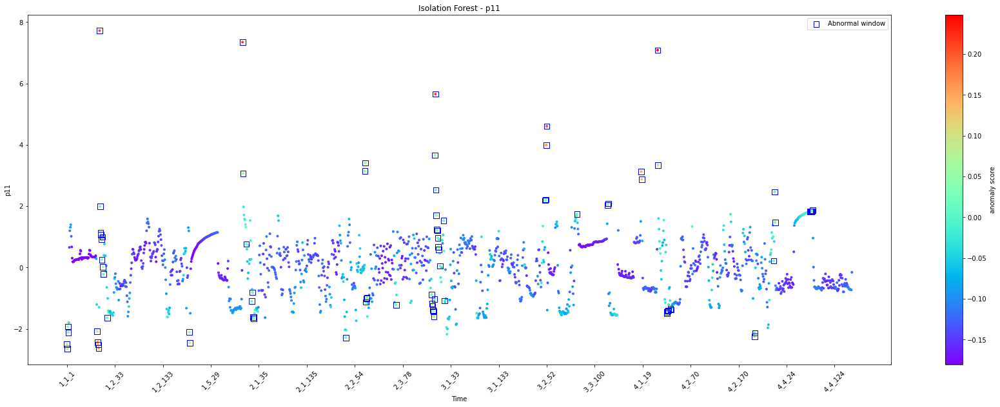

Detected abnormal windows: 82 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_4' '1_1_64' '1_1_65' '1_1_66' '1_1_67'
 '1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_9'
 '1_2_17' '1_4_1' '1_4_2' '2_1_1' '2_1_2' '2_1_9' '2_1_20' '2_1_22'
 '2_1_23' '2_1_24' '2_1_25' '2_2_35' '2_2_75' '2_2_76' '2_3_1' '2_3_2'
 '2_3_3' '2_3_64' '2_3_138' '2_3_139' '2_3_140' '2_3_141' '2_3_142'
 '2_3_143' '2_3_144' '2_3_145' '3_1_1' '3_1_2' '3_1_3' '3_1_4' '3_1_5'
 '3_1_6' '3_1_7' '3_1_8' '3_1_11' '3_1_18' '3_1_20' '3_2_49' '3_2_50'
 '3_2_51' '3_2_52' '3_3_63' '3_3_127' '3_3_128' '4_1_16' '4_1_17' '4_2_1'
 '4_2_2' '4_2_20' '4_2_21' '4_2_22' '4_2_23' '4_2_28' '4_2_29' '4_3_22'
 '4_3_23' '4_3_62' '4_3_64' '4_3_65' '4_4_73' '4_4_74' '4_4_75' '4_4_76'
 '4_4_77' '4_4_78']


In [14]:
clf_name = 'Isolation Forest'
clf = IsolationForest(n_estimators=100, contamination=0.05,random_state=42)
clf.fit(df_means[parameters])
is_anomaly_isoforest = plotAnomalyScore(df_means, clf_name, clf, parameters)
abnormal_windows_isoforest = df_means['day_cycle_window'][is_anomaly_isoforest==-1]
print(f"Detected abnormal windows: {abnormal_windows_isoforest.count()} / {df_means.shape[0]-1}\n")
print(abnormal_windows_isoforest.to_numpy())

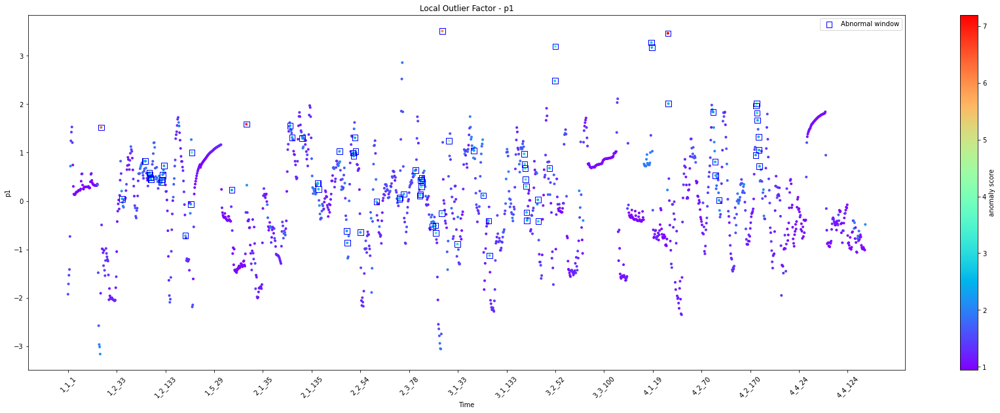

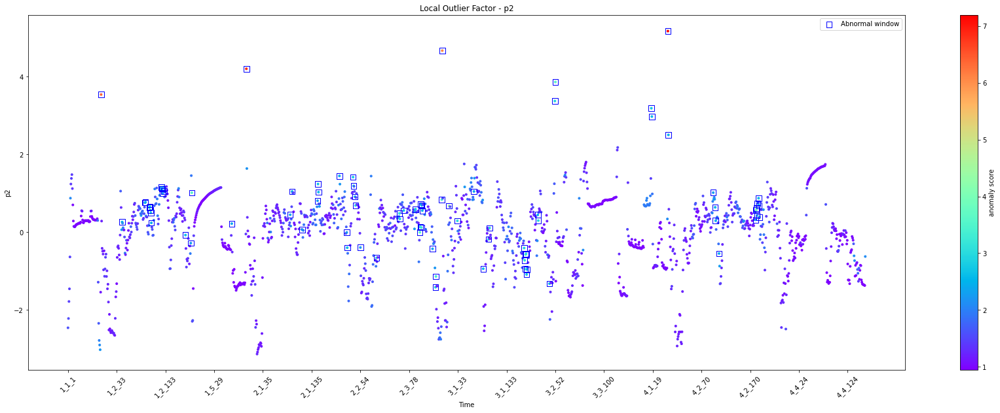

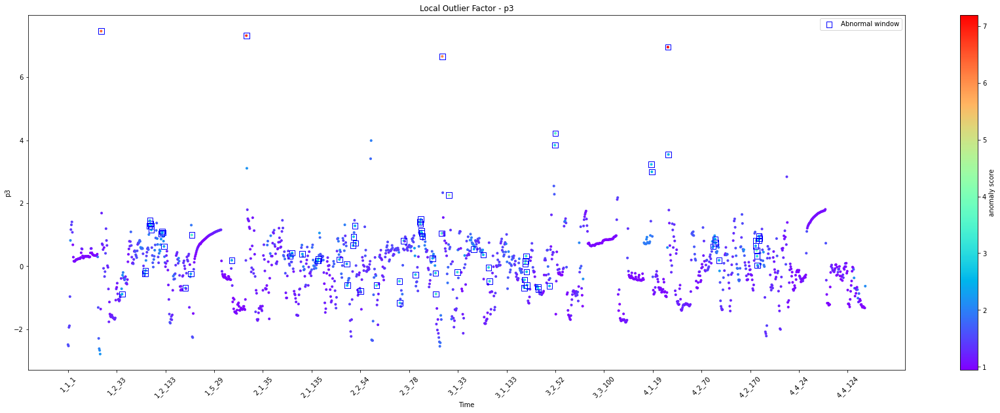

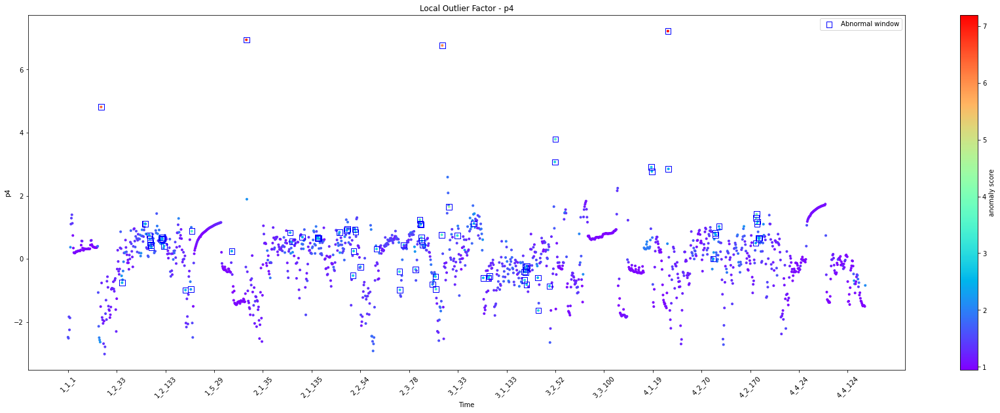

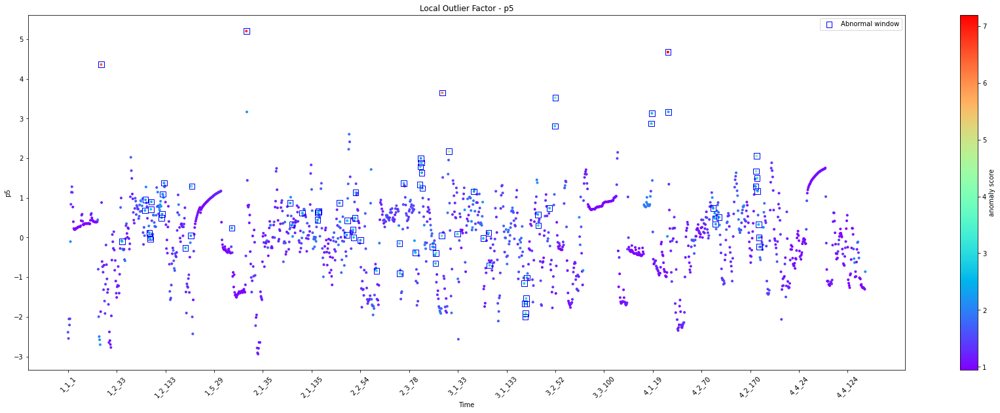

...

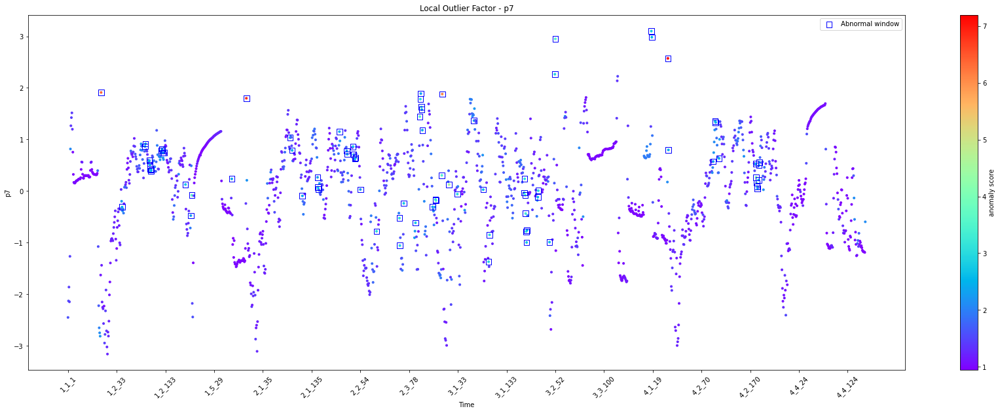

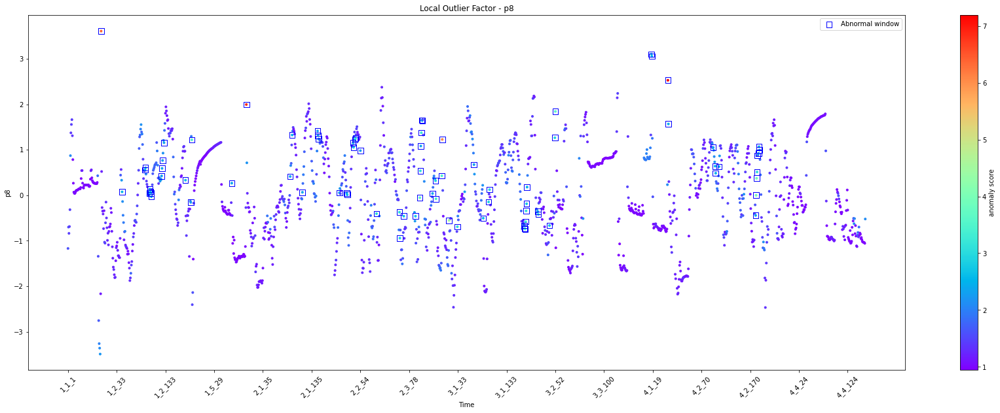

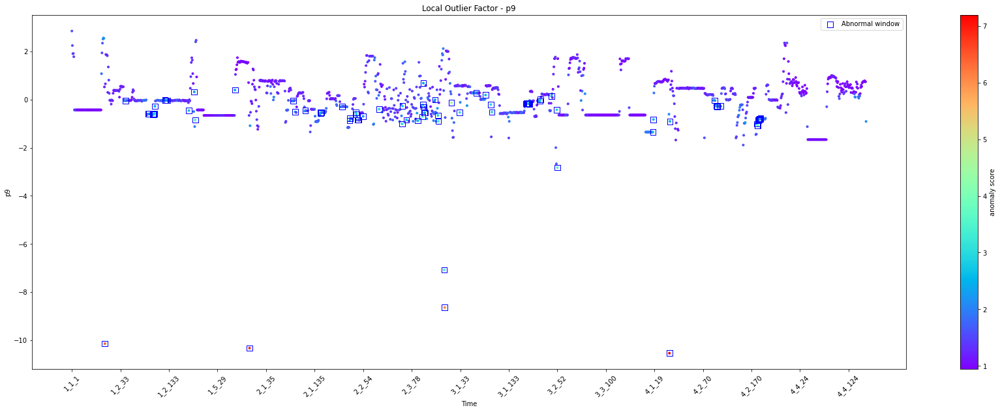

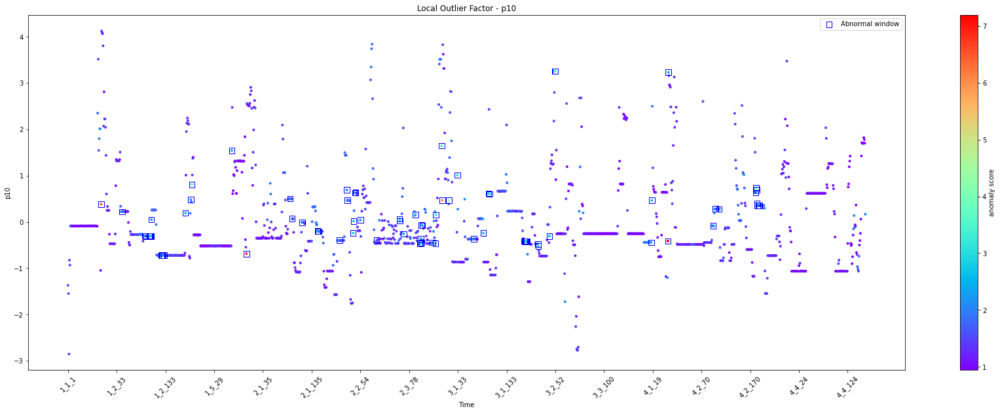

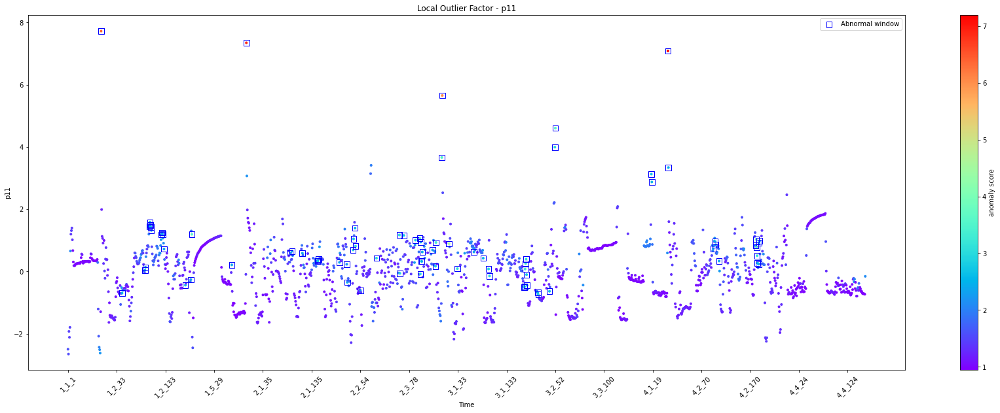

Detected abnormal windows: 82 / 1636

['1_2_1' '1_2_44' '1_2_91' '1_2_92' '1_2_100' '1_2_101' '1_2_102'
 '1_2_103' '1_2_104' '1_2_125' '1_2_126' '1_2_127' '1_2_130' '1_2_174'
 '1_3_4' '1_3_6' '1_5_65' '2_1_1' '2_1_91' '2_1_95' '2_1_116' '2_1_147'
 '2_1_148' '2_1_149' '2_2_11' '2_2_26' '2_2_27' '2_2_39' '2_2_40' '2_2_43'
 '2_2_44' '2_2_54' '2_3_11' '2_3_58' '2_3_59' '2_3_67' '2_3_91' '2_3_100'
 '2_3_101' '2_3_102' '2_3_103' '2_3_104' '2_3_105' '2_3_126' '2_3_132'
 '2_3_133' '2_3_145' '3_1_1' '3_1_15' '3_1_32' '3_1_66' '3_1_85' '3_1_96'
 '3_1_98' '3_1_169' '3_1_170' '3_1_171' '3_1_172' '3_1_173' '3_1_174'
 '3_1_175' '3_2_16' '3_2_17' '3_2_40' '3_2_51' '3_2_52' '4_1_16' '4_1_17'
 '4_2_1' '4_2_2' '4_2_94' '4_2_98' '4_2_99' '4_2_106' '4_2_181' '4_3_1'
 '4_3_2' '4_3_3' '4_3_4' '4_3_6' '4_3_7' '4_3_8']


In [15]:
from sklearn.neighbors import LocalOutlierFactor

clf_name = 'Local Outlier Factor'
clf = LocalOutlierFactor(n_neighbors=50, contamination=0.05, novelty=False)
clf.fit(df_means[parameters])
is_anomaly_lof = plotAnomalyScore(df_means, clf_name, clf, parameters)
abnormal_windows_lof = df_means['day_cycle_window'][is_anomaly_lof==-1]
print(f"Detected abnormal windows: {abnormal_windows_lof.count()} / {df_means.shape[0]-1}\n")
print(abnormal_windows_lof.to_numpy())

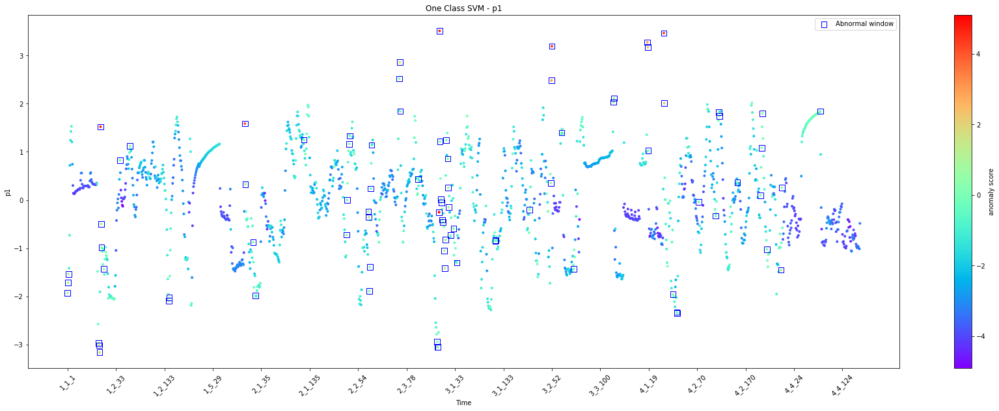

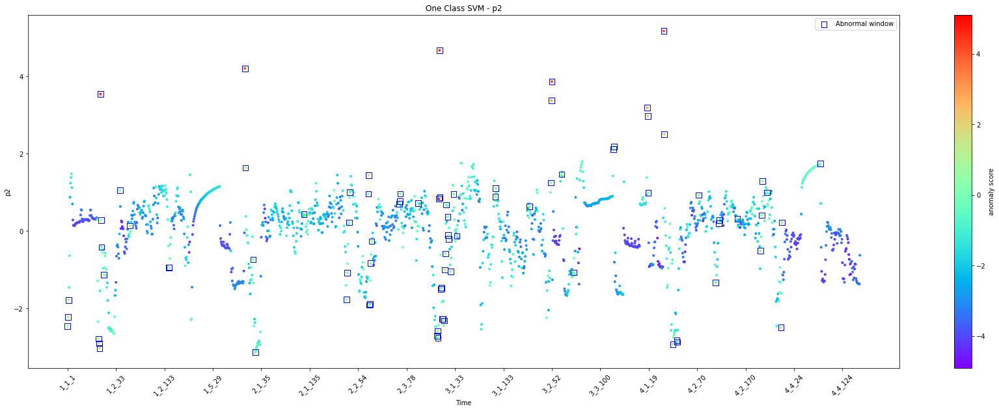

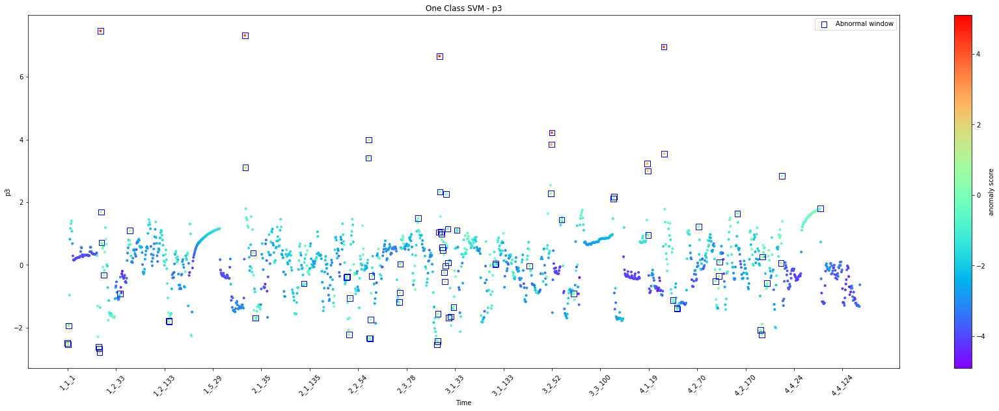

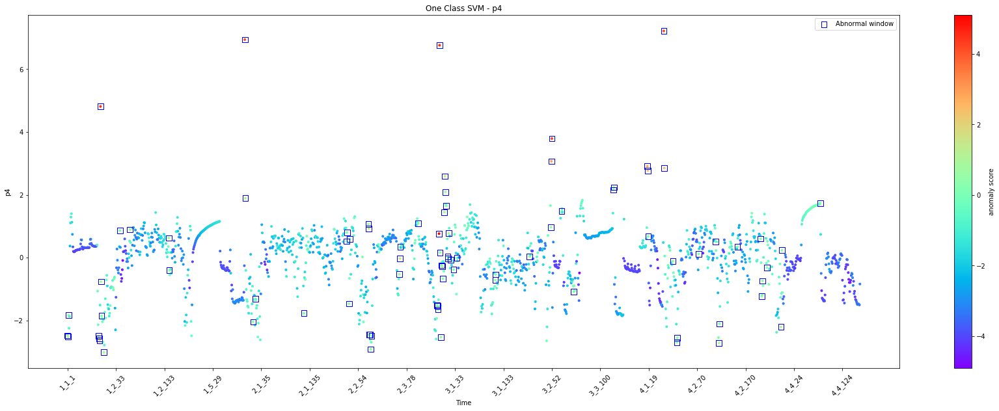

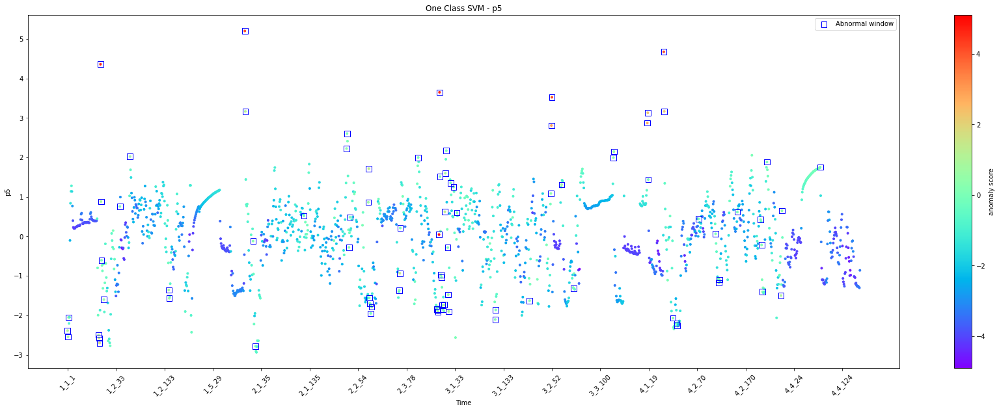

...

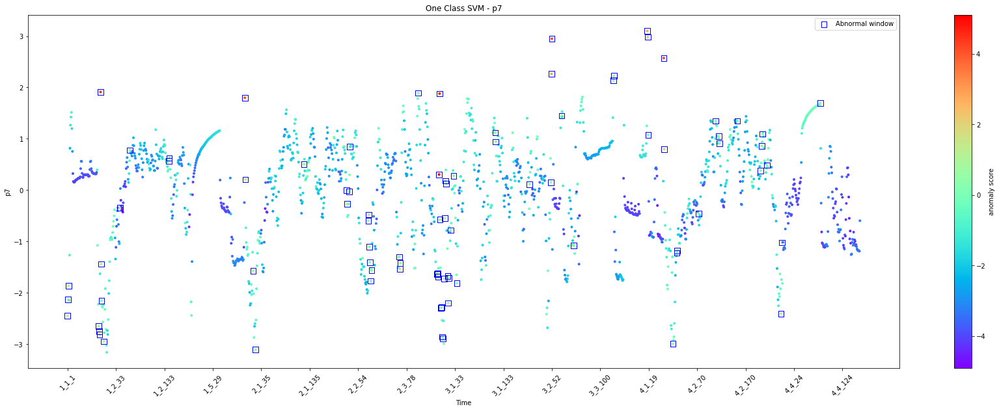

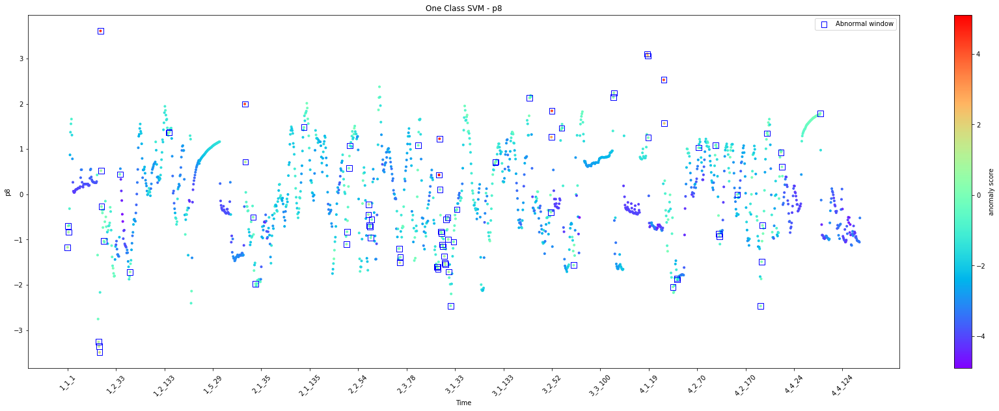

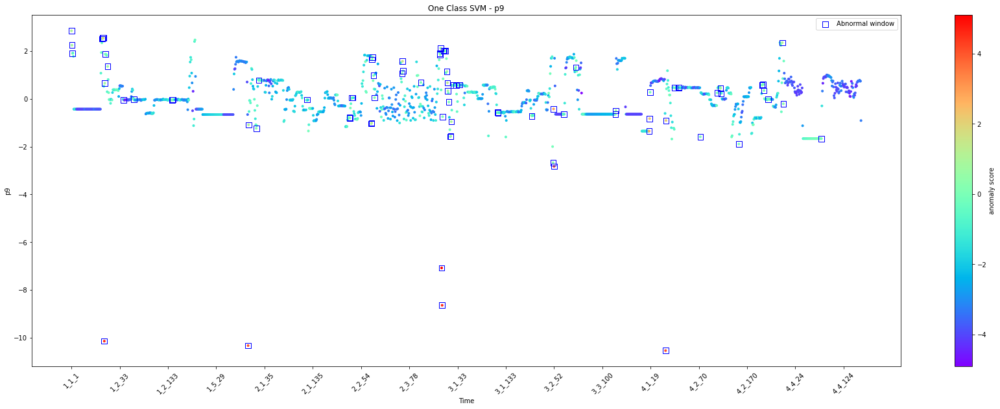

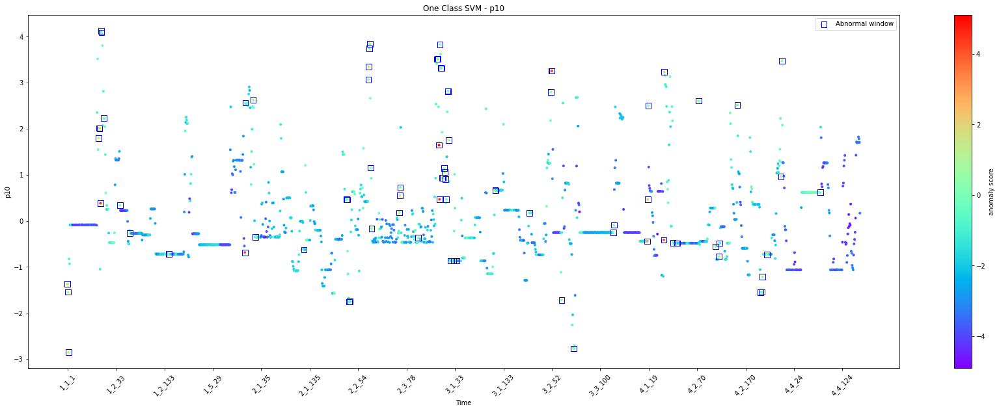

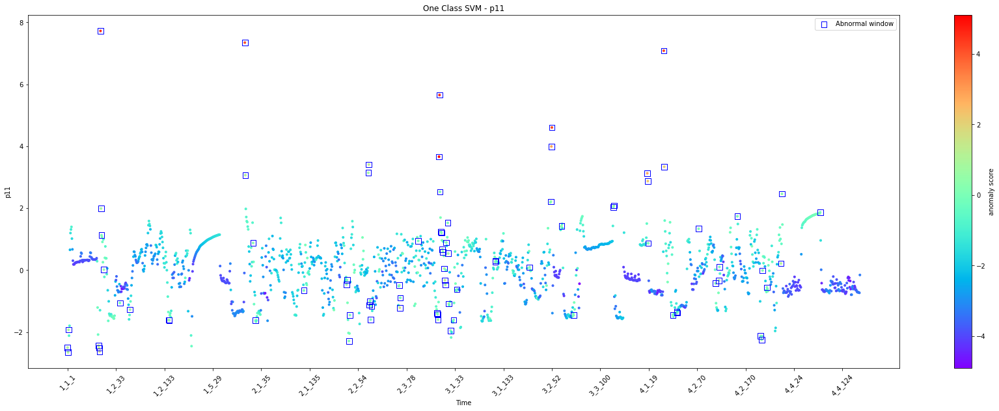

Detected abnormal windows: 83 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_65' '1_1_66' '1_1_67' '1_2_1' '1_2_2'
 '1_2_3' '1_2_8' '1_2_41' '1_2_62' '1_2_142' '1_2_143' '2_1_1' '2_1_2'
 '2_1_18' '2_1_23' '2_1_123' '2_2_30' '2_2_31' '2_2_35' '2_2_37' '2_2_75'
 '2_2_76' '2_3_1' '2_3_2' '2_3_4' '2_3_6' '2_3_63' '2_3_64' '2_3_65'
 '2_3_102' '2_3_141' '2_3_142' '2_3_143' '2_3_145' '3_1_1' '3_1_2' '3_1_4'
 '3_1_5' '3_1_7' '3_1_8' '3_1_11' '3_1_12' '3_1_13' '3_1_15' '3_1_18'
 '3_1_19' '3_1_20' '3_1_24' '3_1_30' '3_1_37' '3_1_116' '3_1_117' '3_2_6'
 '3_2_50' '3_2_51' '3_2_52' '3_3_20' '3_3_45' '3_3_127' '3_3_128' '4_1_16'
 '4_1_17' '4_1_18' '4_2_1' '4_2_2' '4_2_20' '4_2_28' '4_2_29' '4_2_73'
 '4_2_108' '4_2_115' '4_2_116' '4_2_153' '4_3_20' '4_3_22' '4_3_24'
 '4_3_33' '4_3_62' '4_3_64' '4_4_78']


In [16]:
clf_name = 'One Class SVM'
clf = OneClassSVM(nu=0.05, kernel="rbf", gamma='auto') # nu corresponds to contamination
clf.fit(df_means[parameters])
is_anomaly_oneclasssvm = plotAnomalyScore(df_means, clf_name, clf, parameters)
abnormal_windows_oneclasssvm = df_means['day_cycle_window'][is_anomaly_oneclasssvm==-1]
print(f"Detected abnormal windows: {abnormal_windows_oneclasssvm.count()} / {df_means.shape[0]-1}\n")
print(abnormal_windows_oneclasssvm.to_numpy())

Now let's visualize which windows have been considered as anomalies

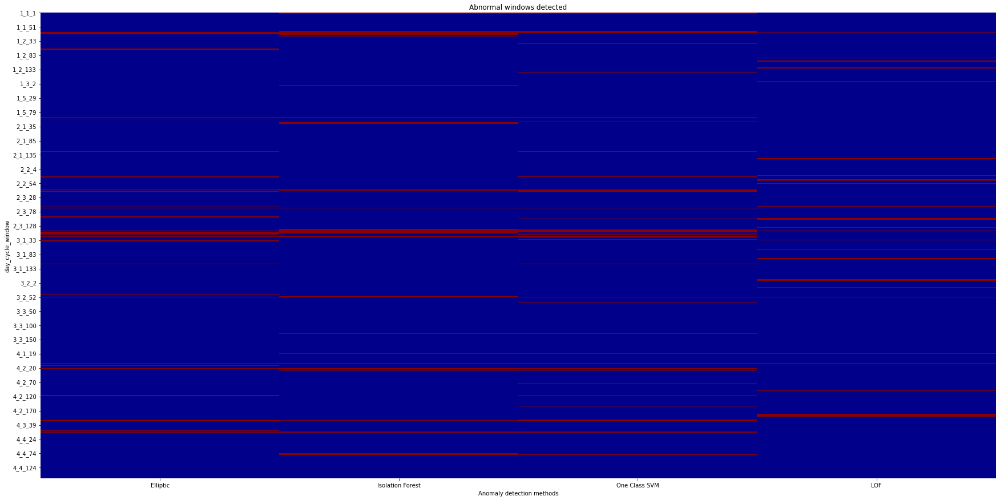

In [17]:
from matplotlib.colors import ListedColormap

# Tested methods
detected_anomalies_by_method = {
    'Elliptic': is_anomaly_elliptic,
    'Isolation Forest': is_anomaly_isoforest,
    'One Class SVM': is_anomaly_oneclasssvm,
    'LOF': is_anomaly_lof
}

# Creating dataframe with the results
df_anomalies = pd.DataFrame(detected_anomalies_by_method)

# Displaying method comparaison with a heat map (red line = outlier detected)
plt.figure(figsize=(30, 15))
cmap = ListedColormap(['darkred', 'darkblue'])
sns.heatmap(df_anomalies, cmap=cmap, cbar=False)
plt.title("Abnormal windows detected")
step = 50
ticks_to_display = range(0, len(df_anomalies), step)
labels_to_display = df_means['day_cycle_window'][ticks_to_display]
plt.yticks(ticks=ticks_to_display, labels=labels_to_display, rotation=0)
plt.xlabel("Anomaly detection methods")
plt.ylabel("day_cycle_window")
plt.show()

Now let's see the impact of dimension

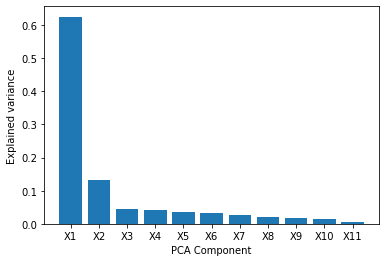

Explained variance by component : [0.62505772 0.13145368 0.04613769 0.04255174 0.03642465 0.0332041
 0.0273608  0.02069174 0.01825657 0.01414218 0.00471914]
Cumulated explained variance : [0.62505772 0.7565114  0.80264909 0.84520084 0.88162548 0.91482958
 0.94219037 0.96288211 0.98113868 0.99528086 1.        ]


Components kept : ['X1', 'X2'] 
	 Cumulated explained variance = 0.7565114004702078


In [18]:
### PCA
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# data selection
X = df_means[parameters]
parameters_pca = ['X1','X2','X3','X4','X5','X6','X7','X8','X9','X10','X11']

# data standardization
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# running PCA
pca = PCA(n_components=11)
X_pca = pca.fit_transform(X_scaled)
df_pca = pd.DataFrame(X_pca, columns=parameters_pca)
df_pca['day_cycle_window']=df_means['day_cycle_window']

# Displaying results
plt.figure()
plt.bar(np.arange(1, 12),pca.explained_variance_ratio_)
plt.xticks(np.arange(1, 12),parameters_pca)
plt.xlabel('PCA Component')
plt.ylabel('Explained variance')
plt.show()
print("Explained variance by component :", pca.explained_variance_ratio_)
print("Cumulated explained variance :", pca.explained_variance_ratio_.cumsum())

# Component selection
parameters_pca_means = ['X1','X2']
print("\n====================================================\n")
print(f"Components kept : {parameters_pca_means} \n\t Cumulated explained variance = {pca.explained_variance_ratio_.cumsum()[len(parameters_pca_means)-1]}")

In [19]:
def plotAnomalies2D(df, clf_name, clf):
    """
        df: Pandas DataFrame containing all the points to plot (for features X1 and X2)
        clf_name: String value - name of the outlier detection model
        clf: Scikit Learn model instance - the trained outlier detection model
    """
    plt.figure()
    plt.plot(df['X1'],df['X2'], '.')
    plt.xlabel('X1')
    plt.ylabel('X2')
    plt.xlim([df['X1'].min()-3,df['X1'].max()+3])
    plt.ylim([df['X2'].min()-3,df['X2'].max()+3])
    plt.title(clf_name)
    
    if clf_name == 'Local Outlier Factor':
        ypred = clf.fit_predict(df[['X1','X2']])
        plt.plot(df['X1'][ypred==-1],df['X2'][ypred==-1],'ro')
    else:
        xx, yy = np.meshgrid(np.linspace(df['X1'].min()-3,df['X1'].max()+3, 500), np.linspace(df['X2'].min()-3,df['X2'].max()+3, 500))
        Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()])
        Z = Z.reshape(xx.shape)
        plt.contour(xx, yy, Z, levels=[0], linewidths=2, colors='r')
    
    plt.show(block=True)

In [20]:
# Elliptic envelope (MCD)

# Hyperparameters tuning
contamination = [0.01, 0.05, 0.1]

for c in contamination:
    # Model initialization with current hyperparameters
    model = EllipticEnvelope(contamination=c,random_state=42)

    # Anomaly prediction
    predictions = model.fit_predict(df_pca[parameters_pca_means])

    # Displaying results
    print(f"contamination={c}")
    print(f"Detected anomalies: {np.sum(predictions == -1)} / {X_pca.shape[0]-1}\n")

contamination=0.01
Detected anomalies: 17 / 1636

contamination=0.05
Detected anomalies: 82 / 1636

contamination=0.1
Detected anomalies: 164 / 1636



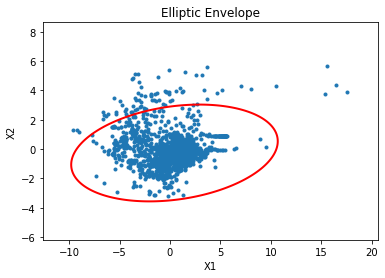

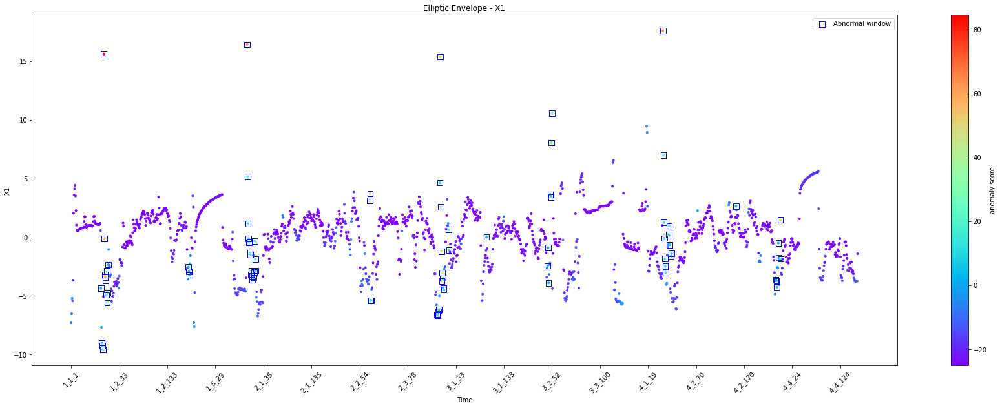

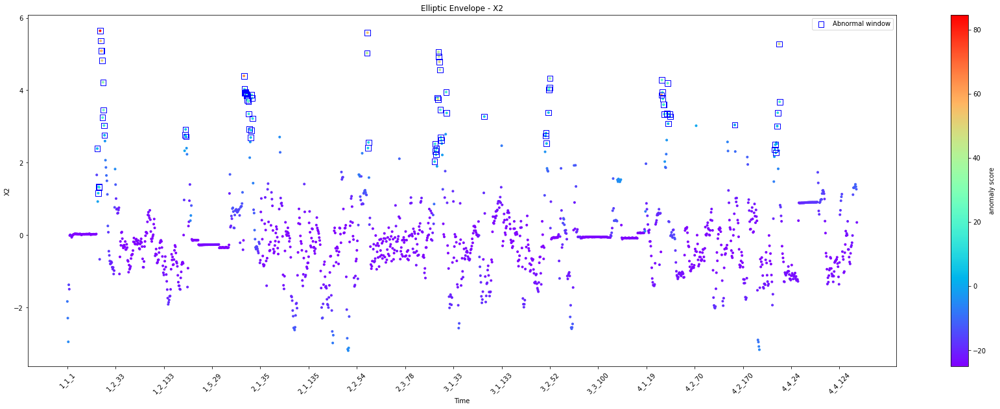

Detected abnormal windows: 82 / 1636

['1_1_63' '1_1_65' '1_1_66' '1_1_67' '1_2_1' '1_2_2' '1_2_3' '1_2_4'
 '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_9' '1_2_10' '1_2_177' '1_2_178'
 '1_2_179' '2_1_1' '2_1_2' '2_1_3' '2_1_4' '2_1_5' '2_1_6' '2_1_7' '2_1_8'
 '2_1_9' '2_1_10' '2_1_11' '2_1_12' '2_1_15' '2_1_16' '2_1_17' '2_1_18'
 '2_1_19' '2_2_75' '2_2_76' '2_3_1' '2_3_2' '2_3_139' '2_3_140' '2_3_141'
 '2_3_142' '2_3_143' '2_3_145' '3_1_1' '3_1_2' '3_1_3' '3_1_4' '3_1_5'
 '3_1_6' '3_1_7' '3_1_8' '3_1_18' '3_1_19' '3_1_97' '3_2_43' '3_2_44'
 '3_2_45' '3_2_49' '3_2_50' '3_2_51' '3_2_52' '4_2_1' '4_2_2' '4_2_3'
 '4_2_4' '4_2_5' '4_2_6' '4_2_7' '4_2_13' '4_2_14' '4_2_15' '4_2_18'
 '4_2_19' '4_2_153' '4_3_55' '4_3_56' '4_3_57' '4_3_60' '4_3_61' '4_3_64'
 '4_3_65']


In [21]:
clf_name = 'Elliptic Envelope'
clf = EllipticEnvelope(contamination=0.05,random_state=42)
clf.fit(df_pca[parameters_pca_means])
if len(parameters_pca_means)==2:
    plotAnomalies2D(df_pca, clf_name, clf)
is_anomaly_elliptic_pca = plotAnomalyScore(df_pca, clf_name, clf, parameters_pca_means)
abnormal_windows_elliptic_pca = df_pca['day_cycle_window'][is_anomaly_elliptic_pca==-1]
print(f"Detected abnormal windows: {abnormal_windows_elliptic_pca.count()} / {df_means.shape[0]-1}\n")
print(abnormal_windows_elliptic_pca.to_numpy())

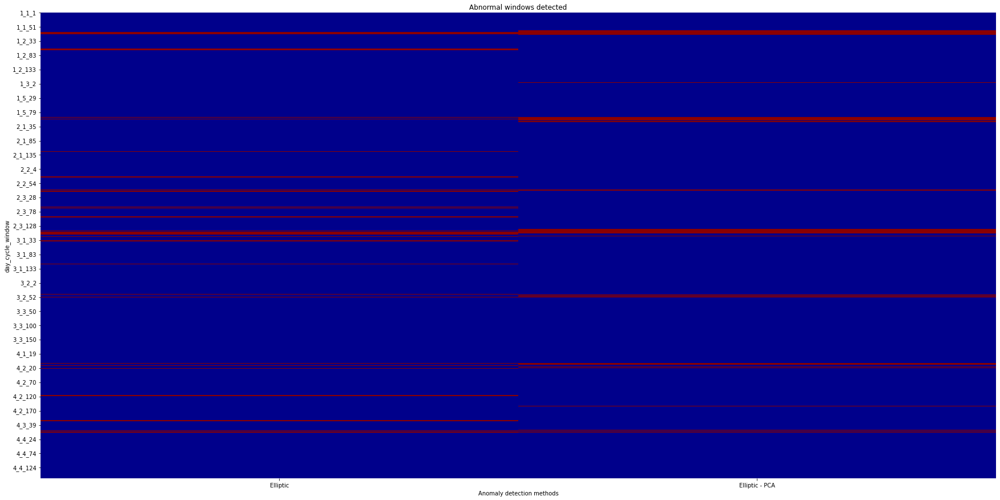

In [22]:
# Comparaison of anomaly detection with and without PCA
detected_anomalies_pca_comparaison = {
    'Elliptic': is_anomaly_elliptic,
    'Elliptic - PCA': is_anomaly_elliptic_pca
}

# Créer un DataFrame
df_anomalies = pd.DataFrame(detected_anomalies_pca_comparaison)

# Créer une heatmap
plt.figure(figsize=(30, 15))
cmap = ListedColormap(['darkred', 'darkblue'])
sns.heatmap(df_anomalies, cmap=cmap, cbar=False)
plt.title("Abnormal windows detected")
step = 50  # Choisissez le nombre de ticks à afficher
ticks_to_display = range(0, len(df_anomalies), step)
labels_to_display = df_means['day_cycle_window'][ticks_to_display]
plt.yticks(ticks=ticks_to_display, labels=labels_to_display, rotation=0)
plt.xlabel("Anomaly detection methods")
plt.ylabel("day_cycle_window")
plt.show()

In [23]:
# Isolation Forest

# Hyperparameters tuning
n_estimators = [5,10,100]
max_samples = [0.5, 0.75, 1.0]
contamination = [0.01, 0.05, 0.1]

# Iterating on hyperparameters values
for n in n_estimators:
    for sample in max_samples:
        for contam in contamination:
            # Initializing model with current values of tested hyperparameters
            model = IsolationForest(n_estimators=n, max_samples=sample,
                                    contamination=contam,random_state=42)
            # Model fitting
            model.fit(df_pca[parameters_pca_means])

            # Anomaly detection
            predictions = model.predict(df_pca[parameters_pca_means])

            # Displaying results
            print(f"n_estimators={n}, max_samples={sample}, contamination={contam}")
            print(f"Anomalies détectées: {np.sum(predictions == -1)} / {df_pca.shape[0]-1}\n")

n_estimators=5, max_samples=0.5, contamination=0.01
Anomalies détectées: 17 / 1636

n_estimators=5, max_samples=0.5, contamination=0.05
Anomalies détectées: 81 / 1636

n_estimators=5, max_samples=0.5, contamination=0.1
Anomalies détectées: 164 / 1636

n_estimators=5, max_samples=0.75, contamination=0.01
Anomalies détectées: 17 / 1636

n_estimators=5, max_samples=0.75, contamination=0.05
Anomalies détectées: 82 / 1636

n_estimators=5, max_samples=0.75, contamination=0.1
Anomalies détectées: 163 / 1636

n_estimators=5, max_samples=1.0, contamination=0.01
Anomalies détectées: 17 / 1636

n_estimators=5, max_samples=1.0, contamination=0.05
Anomalies détectées: 82 / 1636

n_estimators=5, max_samples=1.0, contamination=0.1
Anomalies détectées: 164 / 1636

n_estimators=10, max_samples=0.5, contamination=0.01
Anomalies détectées: 17 / 1636

n_estimators=10, max_samples=0.5, contamination=0.05
Anomalies détectées: 82 / 1636

n_estimators=10, max_samples=0.5, contamination=0.1
Anomalies détectées

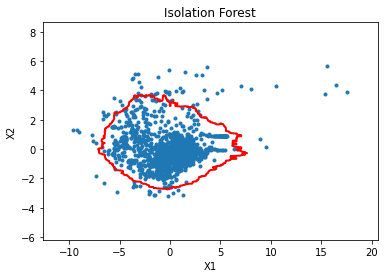

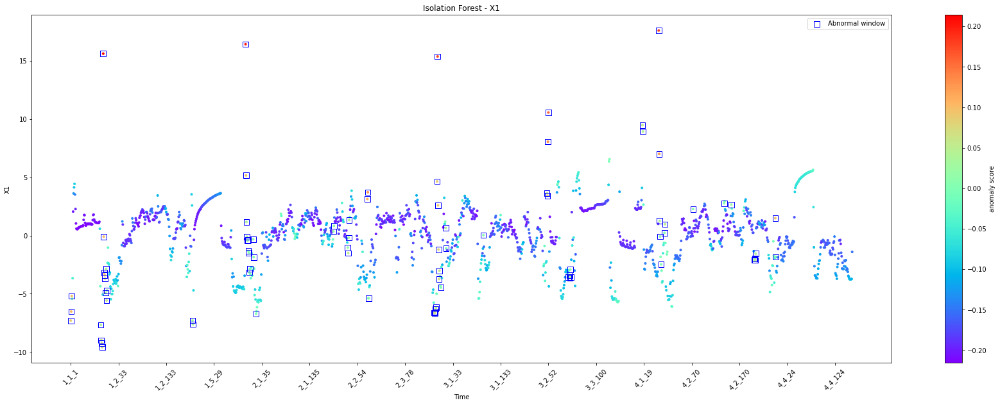

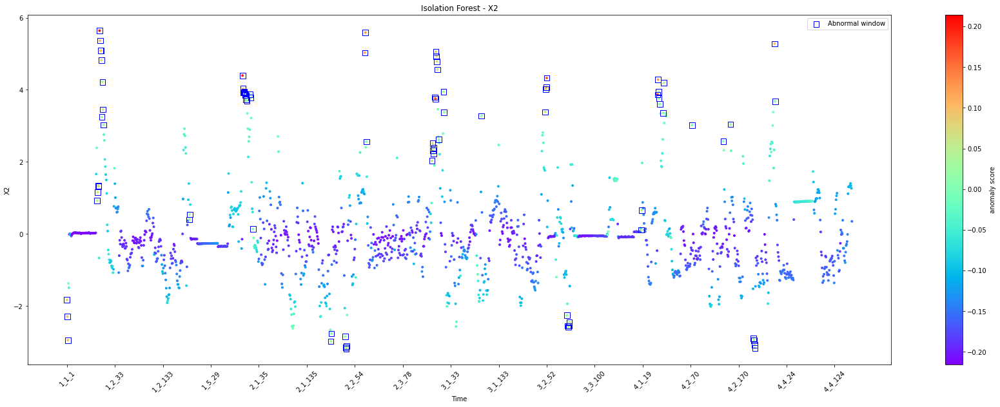

Detected abnormal windows: 82 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_64' '1_1_65' '1_1_66' '1_1_67' '1_2_1'
 '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_9' '1_4_1'
 '1_4_2' '2_1_1' '2_1_2' '2_1_3' '2_1_4' '2_1_5' '2_1_6' '2_1_7' '2_1_8'
 '2_1_9' '2_1_10' '2_1_17' '2_1_18' '2_1_23' '2_2_4' '2_2_5' '2_2_34'
 '2_2_35' '2_2_36' '2_2_37' '2_2_75' '2_2_76' '2_3_2' '2_3_139' '2_3_140'
 '2_3_141' '2_3_142' '2_3_143' '2_3_145' '3_1_1' '3_1_2' '3_1_3' '3_1_4'
 '3_1_5' '3_1_8' '3_1_18' '3_1_19' '3_1_97' '3_2_49' '3_2_50' '3_2_51'
 '3_2_52' '3_3_42' '3_3_44' '3_3_45' '3_3_46' '3_3_47' '4_1_16' '4_1_17'
 '4_2_1' '4_2_2' '4_2_3' '4_2_4' '4_2_6' '4_2_13' '4_2_14' '4_2_73'
 '4_2_138' '4_2_153' '4_3_20' '4_3_21' '4_3_22' '4_3_23' '4_3_64' '4_3_65']


In [24]:
clf_name = 'Isolation Forest'
clf = IsolationForest(n_estimators=100, contamination=0.05,random_state=42)
clf.fit(df_pca[parameters_pca_means])
if len(parameters_pca_means)==2:
    plotAnomalies2D(df_pca, clf_name, clf)
is_anomaly_isoforest_pca = plotAnomalyScore(df_pca, clf_name, clf, parameters_pca_means)
abnormal_windows_isoforest_pca = df_pca['day_cycle_window'][is_anomaly_isoforest_pca==-1]
print(f"Detected abnormal windows: {abnormal_windows_isoforest_pca.count()} / {df_pca.shape[0]-1}\n")
print(abnormal_windows_isoforest_pca.to_numpy())

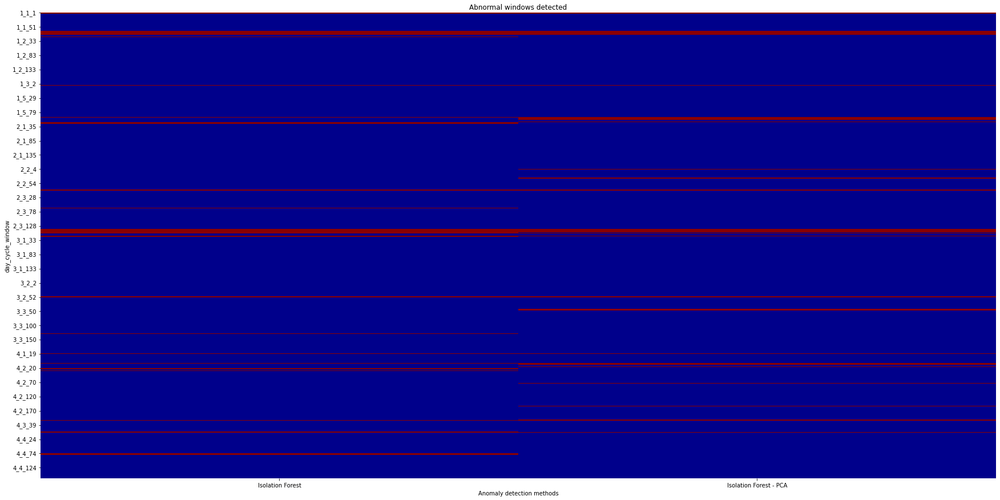

In [25]:
# Comparaison of anomaly detection with and without PCA
detected_anomalies_pca_comparaison = {
    'Isolation Forest': is_anomaly_isoforest,
    'Isolation Forest - PCA': is_anomaly_isoforest_pca
}

# Créer un DataFrame
df_anomalies = pd.DataFrame(detected_anomalies_pca_comparaison)

# Créer une heatmap
plt.figure(figsize=(30, 15))
cmap = ListedColormap(['darkred', 'darkblue'])
sns.heatmap(df_anomalies, cmap=cmap, cbar=False)
plt.title("Abnormal windows detected")
step = 50  # Choisissez le nombre de ticks à afficher
ticks_to_display = range(0, len(df_anomalies), step)
labels_to_display = df_means['day_cycle_window'][ticks_to_display]
plt.yticks(ticks=ticks_to_display, labels=labels_to_display, rotation=0)
plt.xlabel("Anomaly detection methods")
plt.ylabel("day_cycle_window")
plt.show()

In [26]:
def pca_comparaison(clf_name, clf, df, param, df_pca, param_pca):
    """
        df: Pandas DataFrame containing all the points to plot (for features X1 and X2)
        clf_name: String value - name of the outlier detection model
        clf: Scikit Learn model instance - the trained outlier detection model
    """
    # Detecting anomalies (without using PCA)
    print("DETECTING ANOMALIES WITHOUT PCA...\n")
    clf.fit(df[param])
    is_anomaly = plotAnomalyScore(df, clf_name, clf, param)
    abnormal_windows = df['day_cycle_window'][is_anomaly==-1]
    print(f"Detected abnormal windows: {abnormal_windows.count()} / {df.shape[0]-1}\n")
    print(abnormal_windows.to_numpy())
    
    print("\n=====================================\n")
    
    # Detecting anomalies (without using PCA)
    print("DETECTING ANOMALIES WITH PCA...\n")
    clf.fit(df_pca[param_pca])
    if len(param_pca)==2:
        plotAnomalies2D(df_pca, clf_name, clf)
    is_anomaly_pca = plotAnomalyScore(df_pca, clf_name, clf, param_pca)
    abnormal_windows_pca = df_pca['day_cycle_window'][is_anomaly_pca==-1]
    print(f"Detected abnormal windows: {abnormal_windows_pca.count()} / {df_pca.shape[0]-1}\n")
    print(abnormal_windows_pca.to_numpy())
    
    print("\n=====================================\n")
    
    print("COMPARING THE METHODS...\n")
    # Tested methods
    detected_anomalies_pca_comparaison = {
    clf_name: is_anomaly,
    f'{clf_name} - PCA': is_anomaly_pca
    }

    # Creating dataframe with the results
    df_anomalies = pd.DataFrame(detected_anomalies_pca_comparaison)

    # Displaying method comparaison with a heat map (red line = outlier detected)
    plt.figure(figsize=(30, 15))
    cmap = ListedColormap(['darkred', 'darkblue'])
    sns.heatmap(df_anomalies, cmap=cmap, cbar=False)
    plt.title("Abnormal windows detected")
    step = 50
    ticks_to_display = range(0, len(df_anomalies), step)
    labels_to_display = df['day_cycle_window'][ticks_to_display]
    plt.yticks(ticks=ticks_to_display, labels=labels_to_display, rotation=0)
    plt.xlabel("Anomaly detection methods")
    plt.ylabel("day_cycle_window")
    plt.show()
    
    return is_anomaly,is_anomaly_pca

DETECTING ANOMALIES WITHOUT PCA...



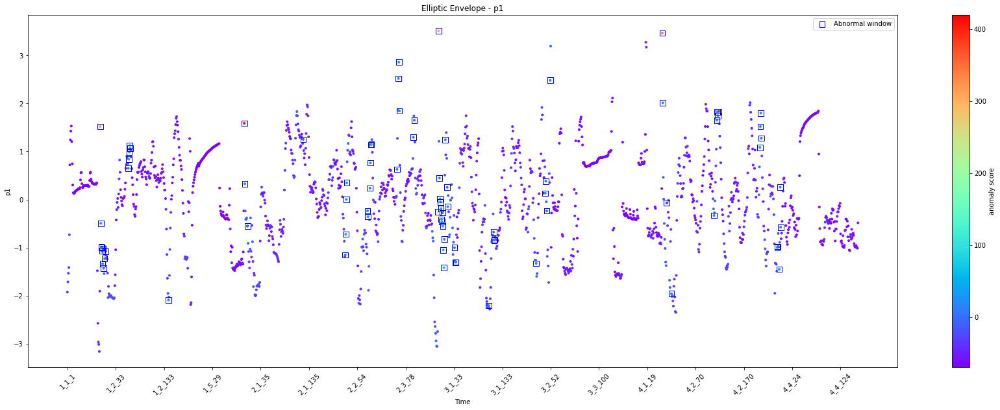

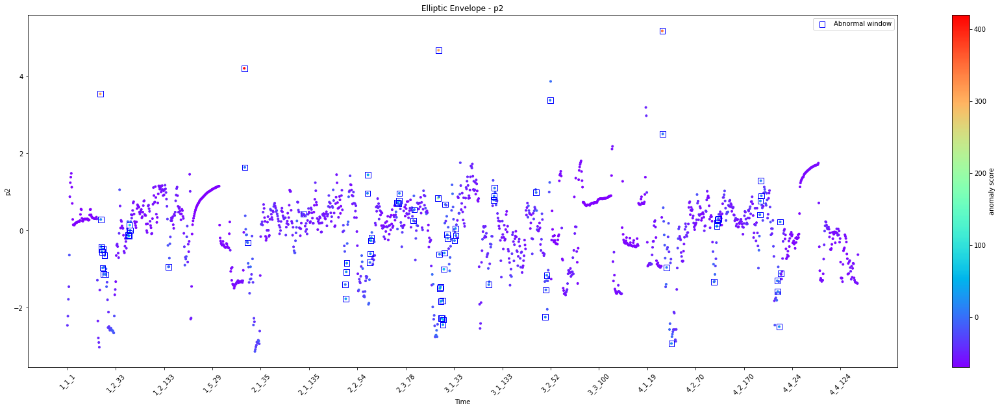

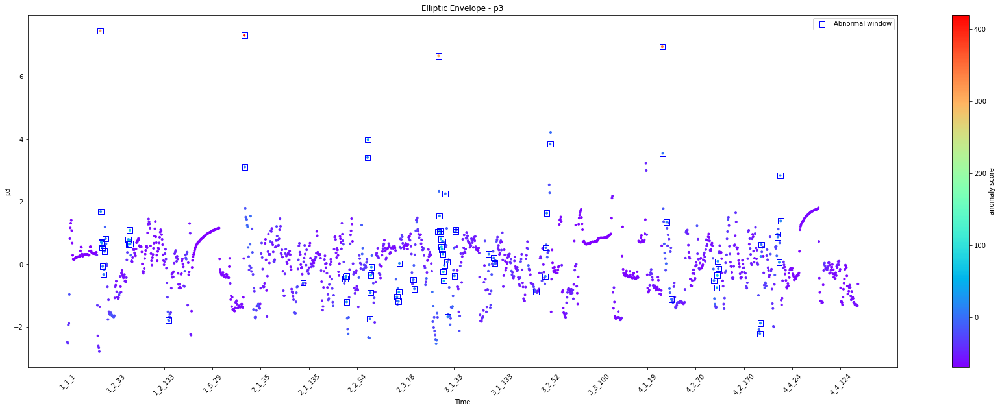

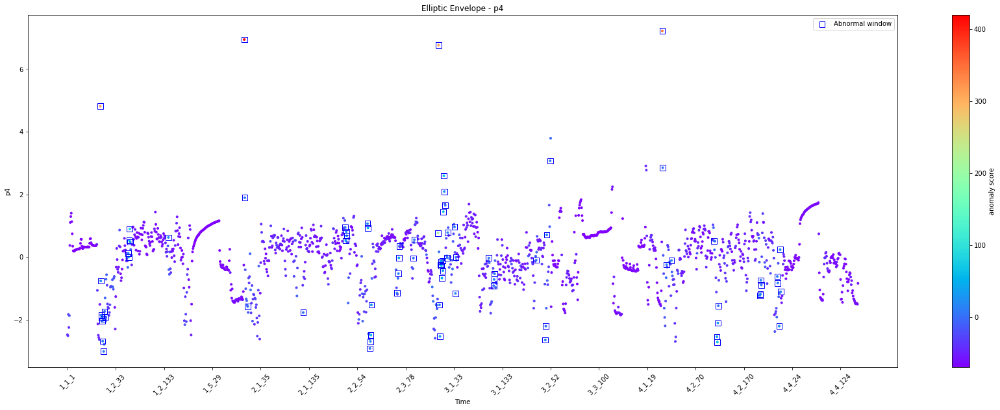

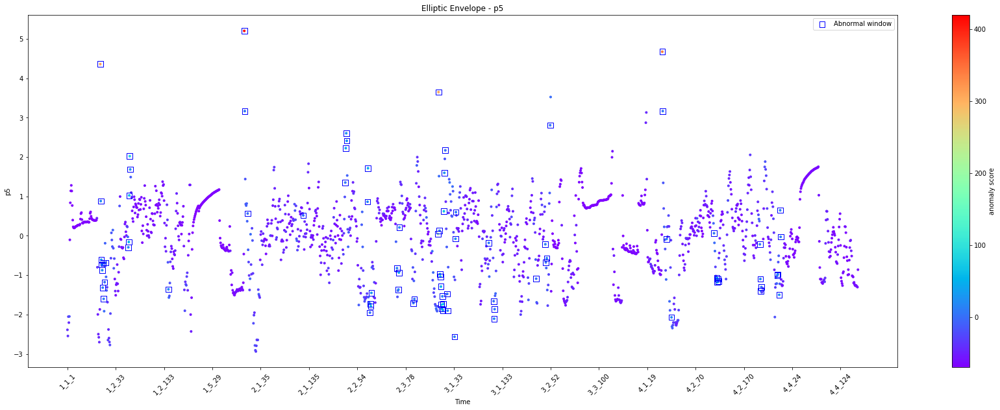

...

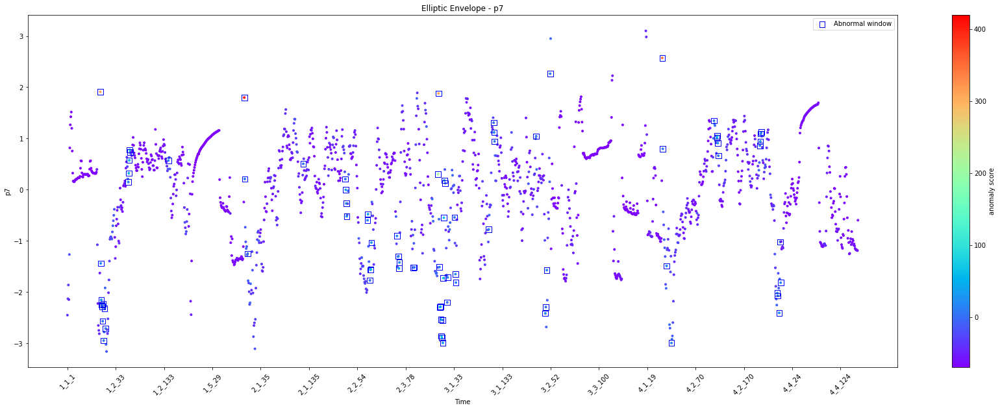

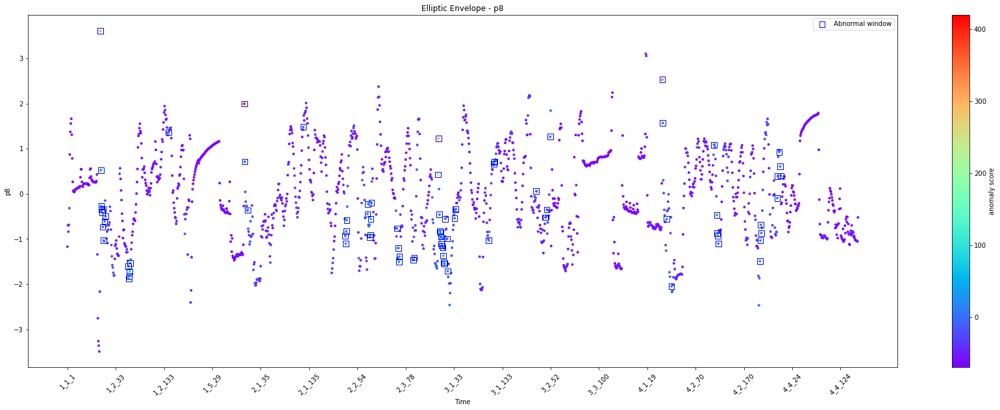

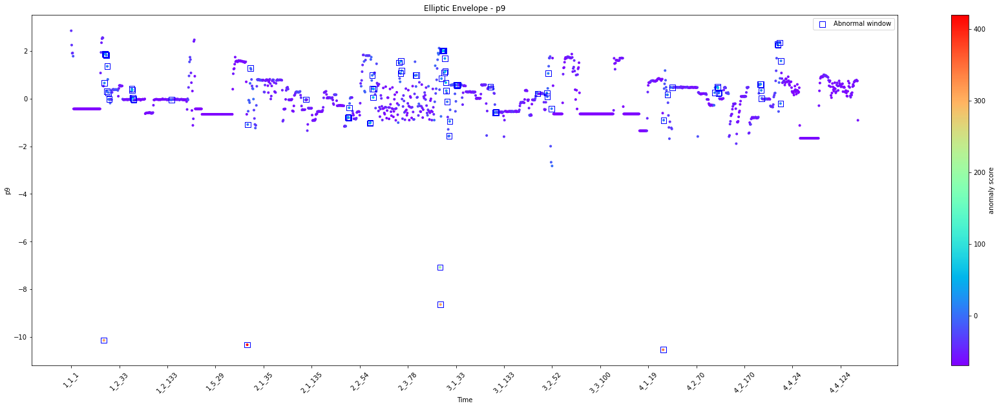

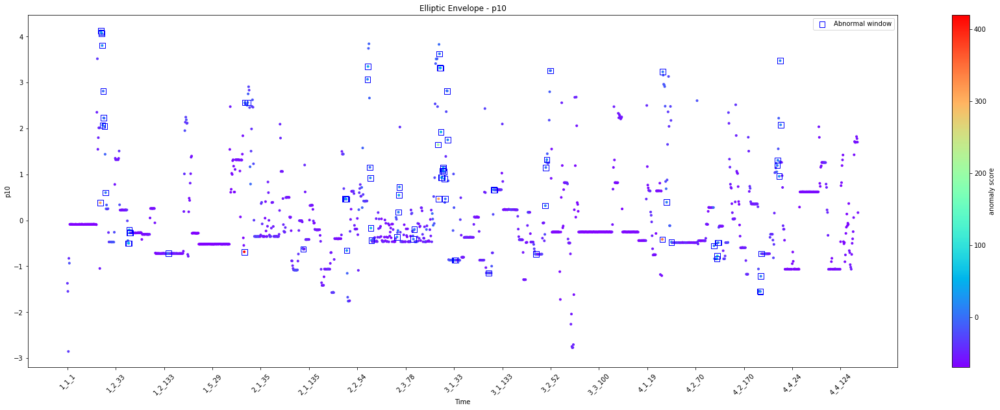

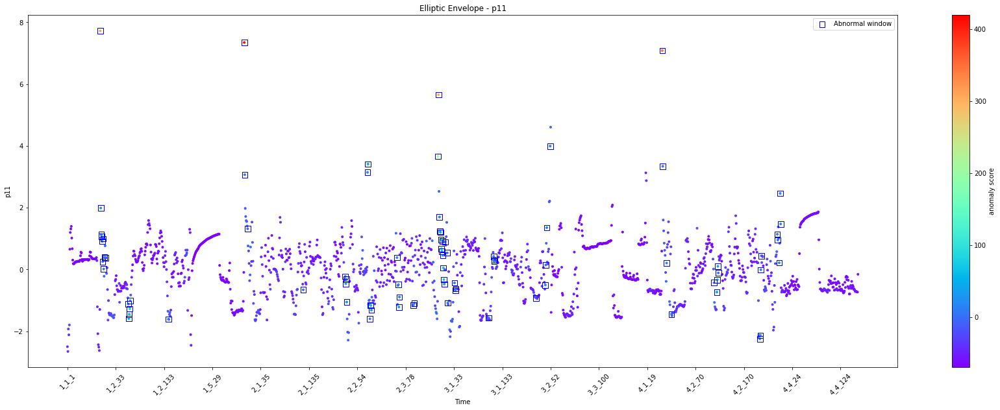

Detected abnormal windows: 82 / 1636

['1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_10'
 '1_2_12' '1_2_59' '1_2_60' '1_2_61' '1_2_62' '1_2_63' '1_2_142' '2_1_1'
 '2_1_2' '2_1_8' '2_1_123' '2_2_29' '2_2_30' '2_2_31' '2_2_32' '2_2_75'
 '2_2_76' '2_3_4' '2_3_5' '2_3_6' '2_3_7' '2_3_60' '2_3_63' '2_3_64'
 '2_3_65' '2_3_94' '2_3_96' '2_3_145' '3_1_1' '3_1_3' '3_1_4' '3_1_5'
 '3_1_6' '3_1_7' '3_1_8' '3_1_9' '3_1_10' '3_1_11' '3_1_12' '3_1_13'
 '3_1_15' '3_1_19' '3_1_20' '3_1_34' '3_1_36' '3_1_37' '3_1_105' '3_1_115'
 '3_1_116' '3_1_117' '3_2_22' '3_2_41' '3_2_42' '3_2_44' '3_2_51' '4_2_1'
 '4_2_2' '4_2_10' '4_2_20' '4_2_108' '4_2_114' '4_2_115' '4_2_116'
 '4_2_117' '4_3_22' '4_3_23' '4_3_24' '4_3_25' '4_3_58' '4_3_59' '4_3_62'
 '4_3_64' '4_3_65']


DETECTING ANOMALIES WITH PCA...



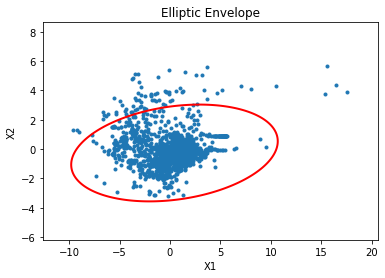

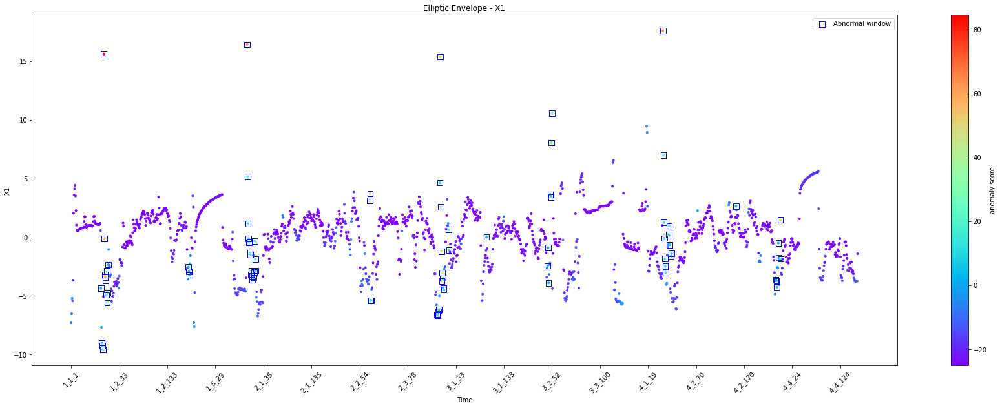

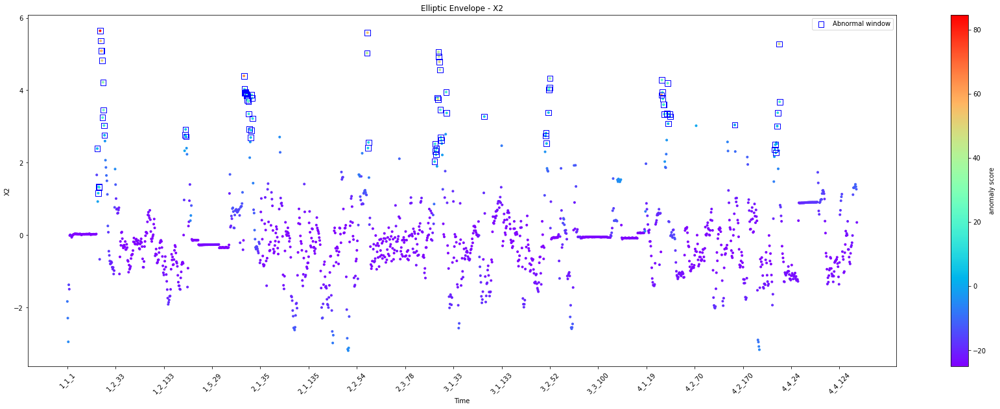

Detected abnormal windows: 82 / 1636

['1_1_63' '1_1_65' '1_1_66' '1_1_67' '1_2_1' '1_2_2' '1_2_3' '1_2_4'
 '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_9' '1_2_10' '1_2_177' '1_2_178'
 '1_2_179' '2_1_1' '2_1_2' '2_1_3' '2_1_4' '2_1_5' '2_1_6' '2_1_7' '2_1_8'
 '2_1_9' '2_1_10' '2_1_11' '2_1_12' '2_1_15' '2_1_16' '2_1_17' '2_1_18'
 '2_1_19' '2_2_75' '2_2_76' '2_3_1' '2_3_2' '2_3_139' '2_3_140' '2_3_141'
 '2_3_142' '2_3_143' '2_3_145' '3_1_1' '3_1_2' '3_1_3' '3_1_4' '3_1_5'
 '3_1_6' '3_1_7' '3_1_8' '3_1_18' '3_1_19' '3_1_97' '3_2_43' '3_2_44'
 '3_2_45' '3_2_49' '3_2_50' '3_2_51' '3_2_52' '4_2_1' '4_2_2' '4_2_3'
 '4_2_4' '4_2_5' '4_2_6' '4_2_7' '4_2_13' '4_2_14' '4_2_15' '4_2_18'
 '4_2_19' '4_2_153' '4_3_55' '4_3_56' '4_3_57' '4_3_60' '4_3_61' '4_3_64'
 '4_3_65']


COMPARING THE METHODS...



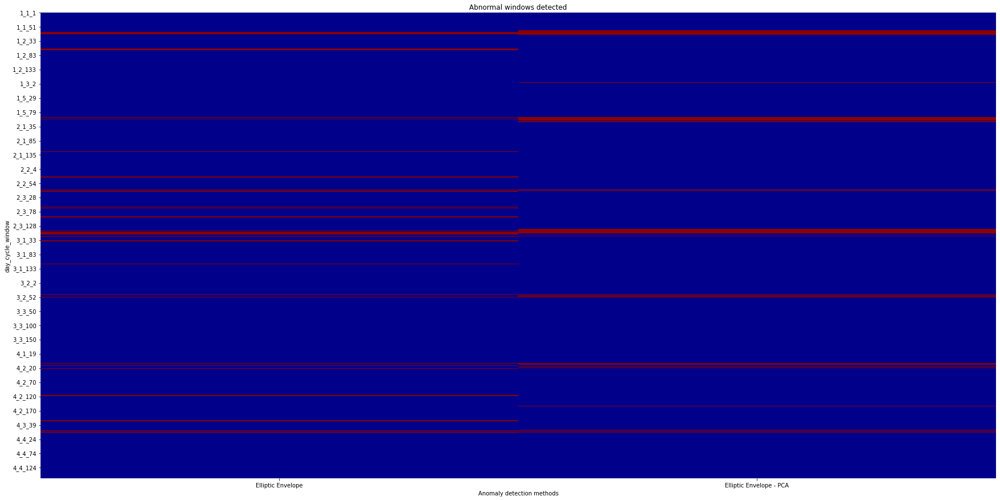

(array([1, 1, 1, ..., 1, 1, 1]), array([1, 1, 1, ..., 1, 1, 1]))

In [27]:
clf_name = 'Elliptic Envelope'
clf = EllipticEnvelope(contamination=0.05,random_state=42)
pca_comparaison(clf_name,clf,df_means,parameters,df_pca,parameters_pca_means)

DETECTING ANOMALIES WITHOUT PCA...



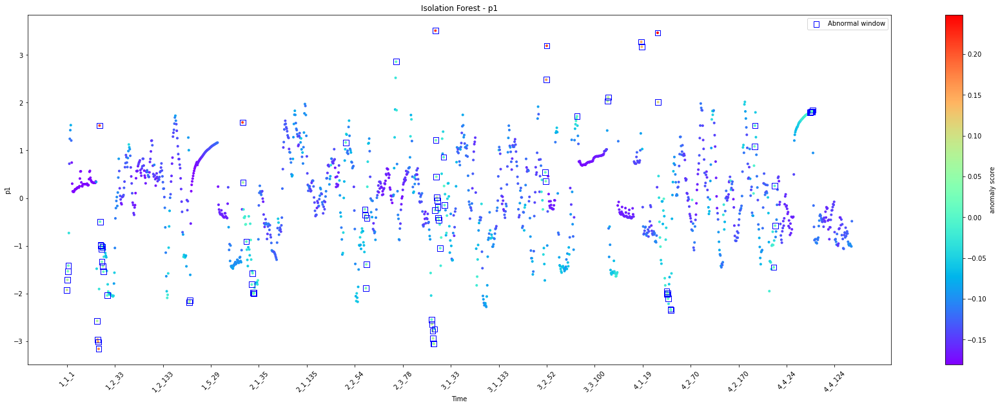

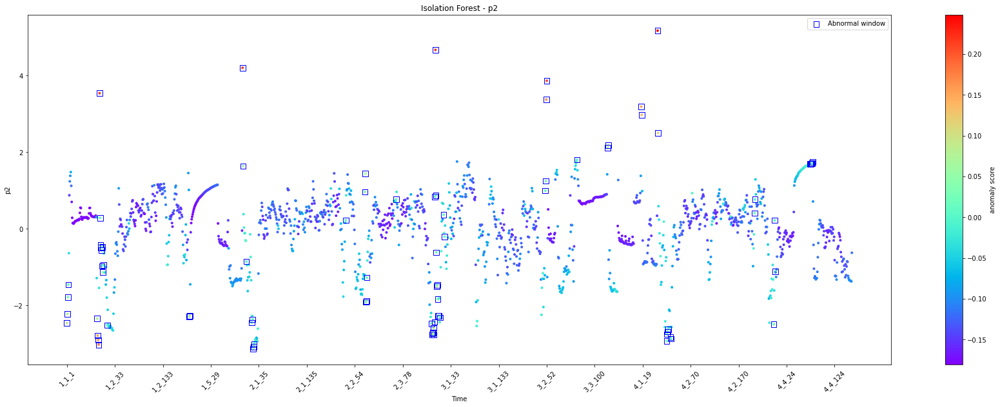

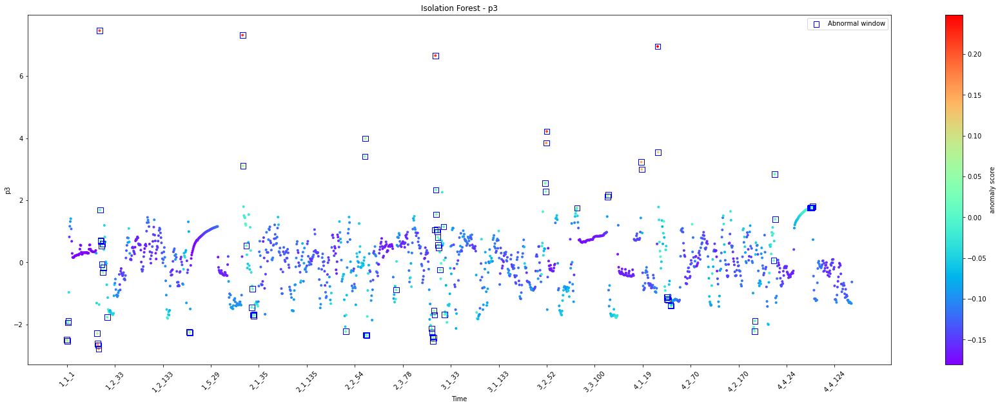

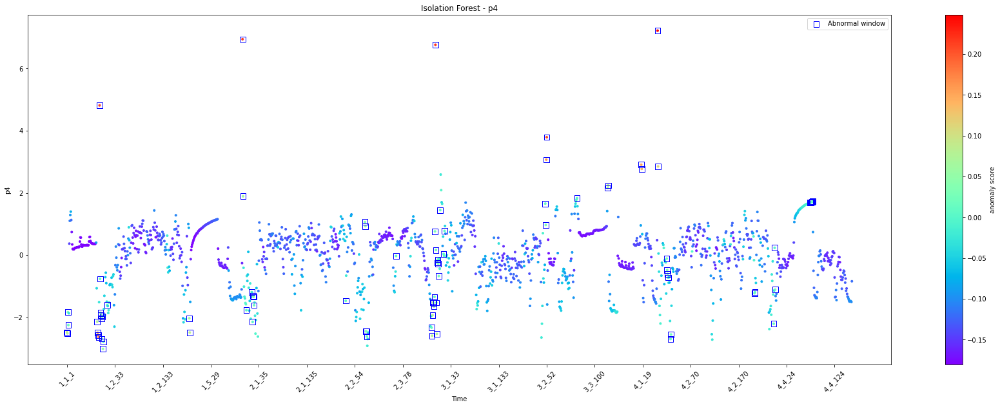

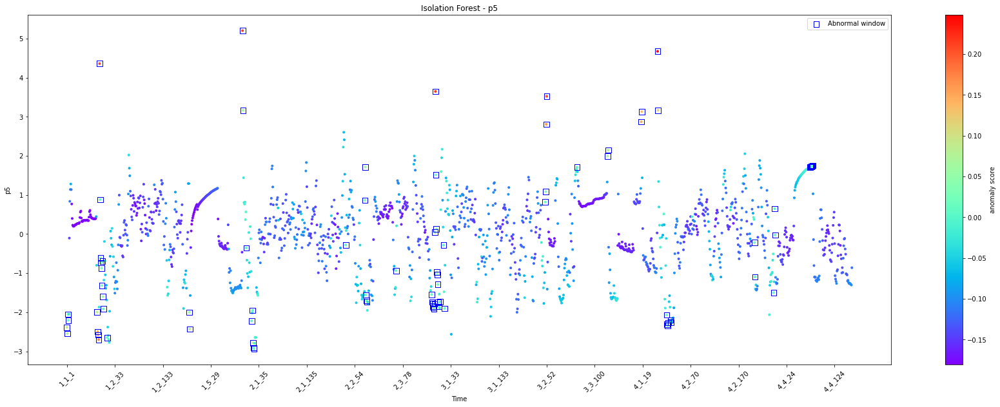

...

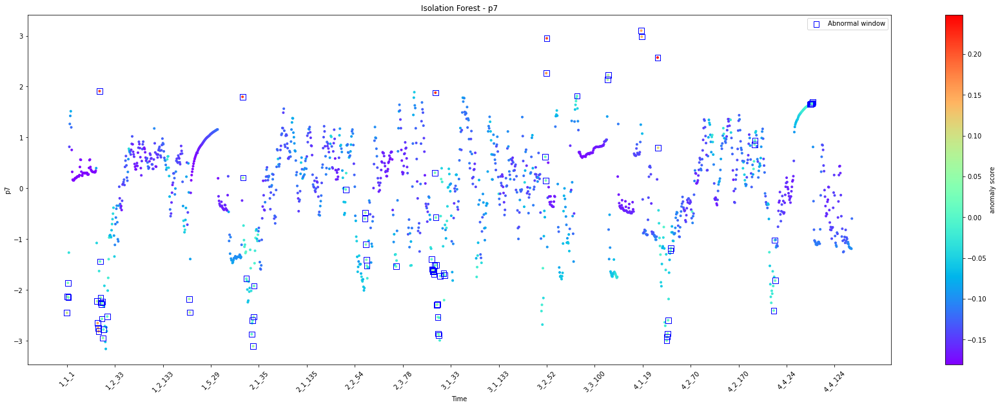

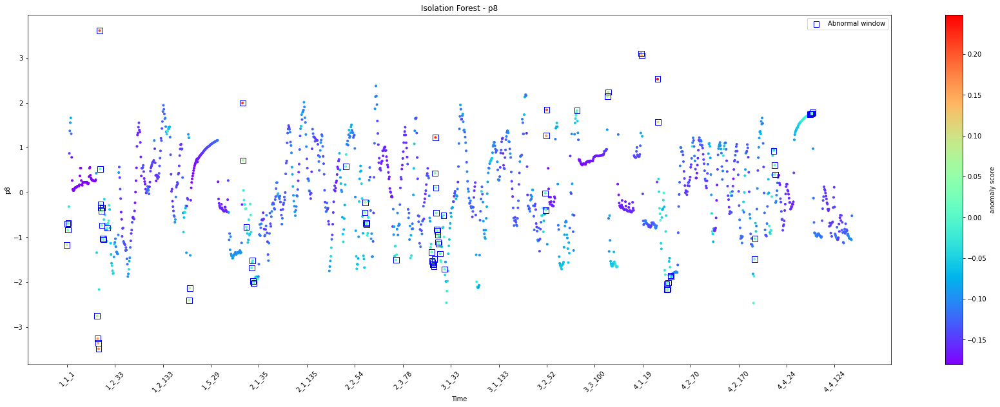

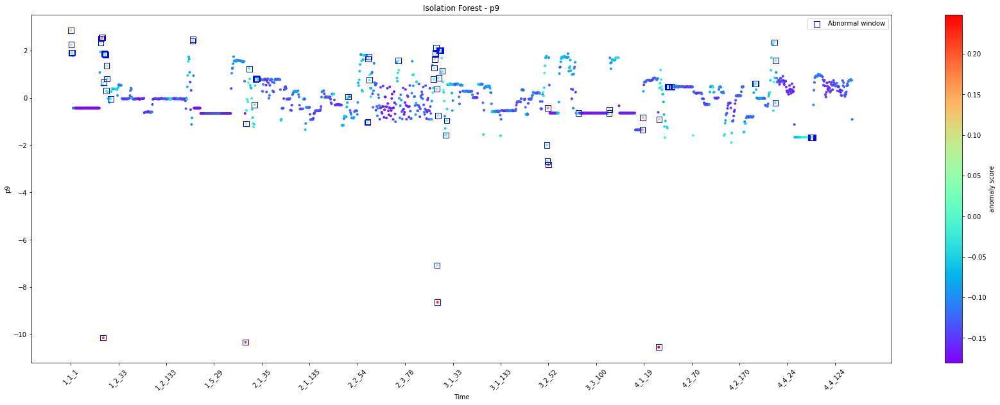

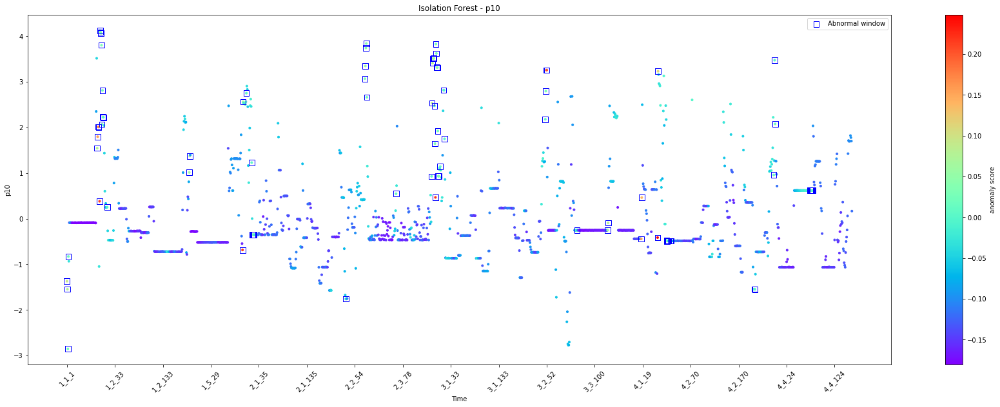

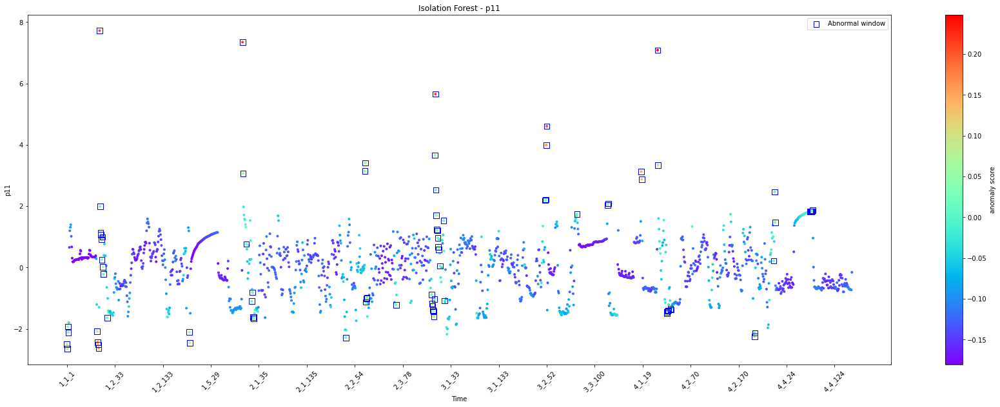

Detected abnormal windows: 82 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_4' '1_1_64' '1_1_65' '1_1_66' '1_1_67'
 '1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_9'
 '1_2_17' '1_4_1' '1_4_2' '2_1_1' '2_1_2' '2_1_9' '2_1_20' '2_1_22'
 '2_1_23' '2_1_24' '2_1_25' '2_2_35' '2_2_75' '2_2_76' '2_3_1' '2_3_2'
 '2_3_3' '2_3_64' '2_3_138' '2_3_139' '2_3_140' '2_3_141' '2_3_142'
 '2_3_143' '2_3_144' '2_3_145' '3_1_1' '3_1_2' '3_1_3' '3_1_4' '3_1_5'
 '3_1_6' '3_1_7' '3_1_8' '3_1_11' '3_1_18' '3_1_20' '3_2_49' '3_2_50'
 '3_2_51' '3_2_52' '3_3_63' '3_3_127' '3_3_128' '4_1_16' '4_1_17' '4_2_1'
 '4_2_2' '4_2_20' '4_2_21' '4_2_22' '4_2_23' '4_2_28' '4_2_29' '4_3_22'
 '4_3_23' '4_3_62' '4_3_64' '4_3_65' '4_4_73' '4_4_74' '4_4_75' '4_4_76'
 '4_4_77' '4_4_78']


DETECTING ANOMALIES WITH PCA...



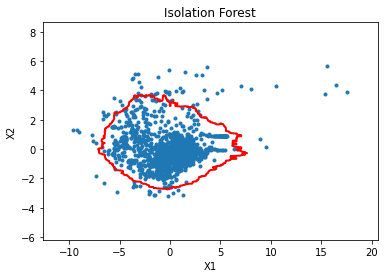

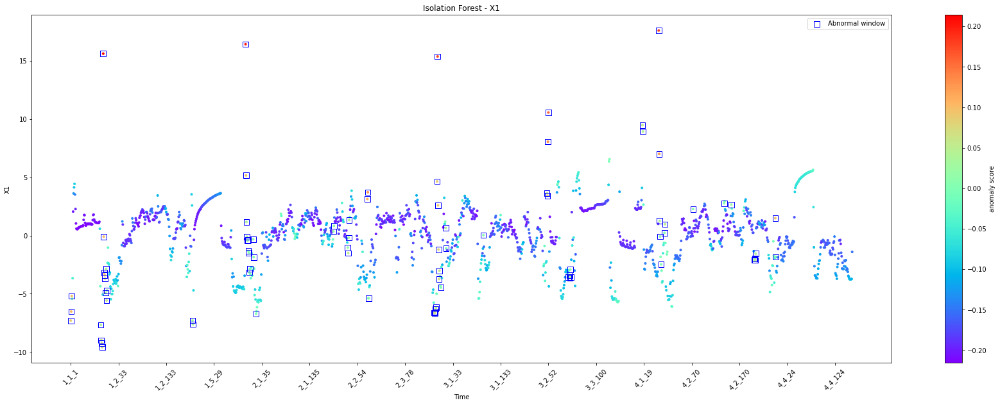

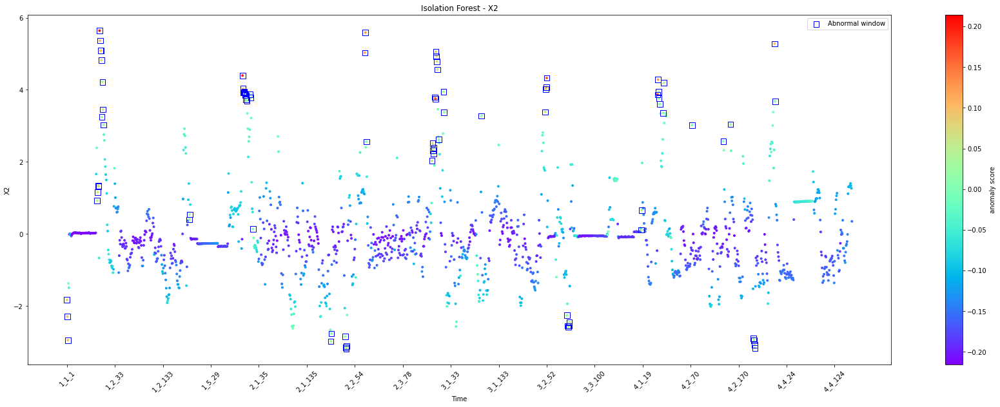

Detected abnormal windows: 82 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_64' '1_1_65' '1_1_66' '1_1_67' '1_2_1'
 '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_9' '1_4_1'
 '1_4_2' '2_1_1' '2_1_2' '2_1_3' '2_1_4' '2_1_5' '2_1_6' '2_1_7' '2_1_8'
 '2_1_9' '2_1_10' '2_1_17' '2_1_18' '2_1_23' '2_2_4' '2_2_5' '2_2_34'
 '2_2_35' '2_2_36' '2_2_37' '2_2_75' '2_2_76' '2_3_2' '2_3_139' '2_3_140'
 '2_3_141' '2_3_142' '2_3_143' '2_3_145' '3_1_1' '3_1_2' '3_1_3' '3_1_4'
 '3_1_5' '3_1_8' '3_1_18' '3_1_19' '3_1_97' '3_2_49' '3_2_50' '3_2_51'
 '3_2_52' '3_3_42' '3_3_44' '3_3_45' '3_3_46' '3_3_47' '4_1_16' '4_1_17'
 '4_2_1' '4_2_2' '4_2_3' '4_2_4' '4_2_6' '4_2_13' '4_2_14' '4_2_73'
 '4_2_138' '4_2_153' '4_3_20' '4_3_21' '4_3_22' '4_3_23' '4_3_64' '4_3_65']


COMPARING THE METHODS...



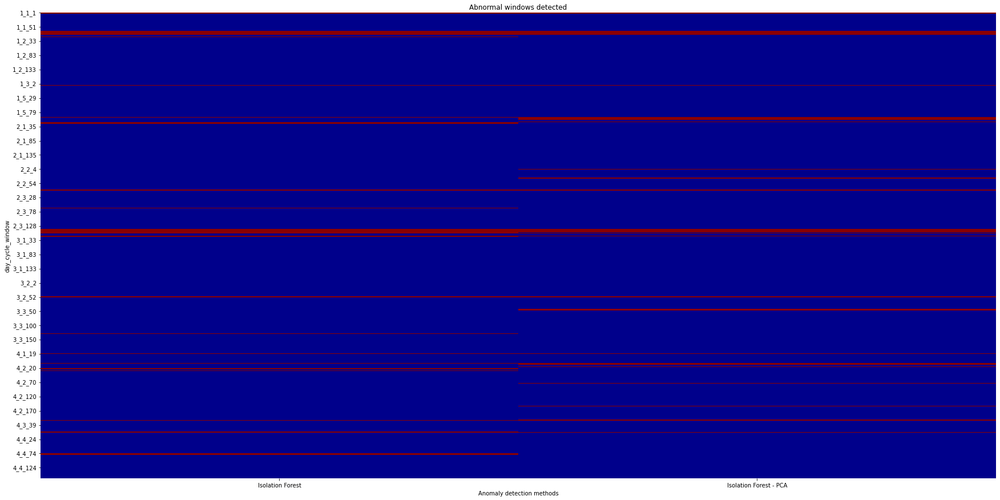

(array([-1, -1, -1, ...,  1,  1,  1]), array([-1, -1, -1, ...,  1,  1,  1]))

In [28]:
clf_name = 'Isolation Forest'
clf = IsolationForest(n_estimators=100, contamination=0.05,random_state=42)
pca_comparaison(clf_name,clf,df_means,parameters,df_pca,parameters_pca_means)

DETECTING ANOMALIES WITHOUT PCA...



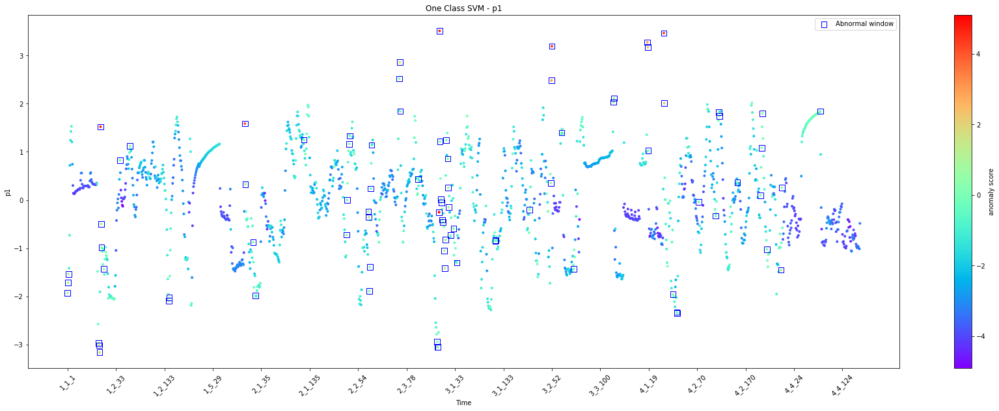

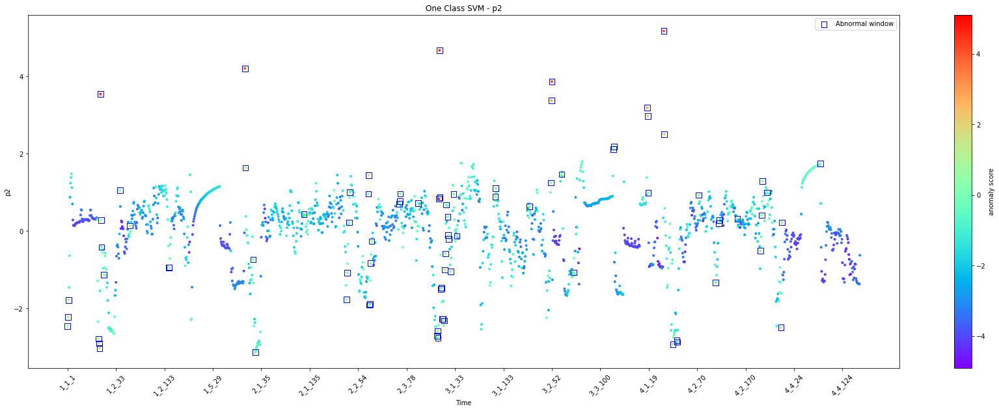

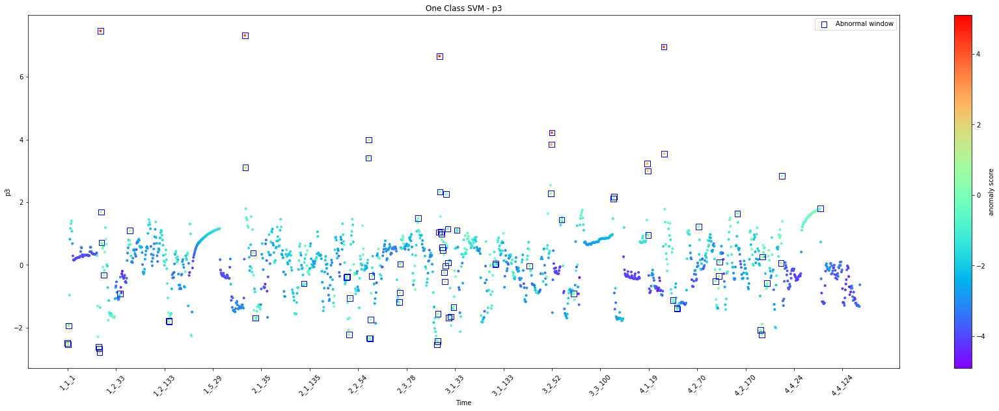

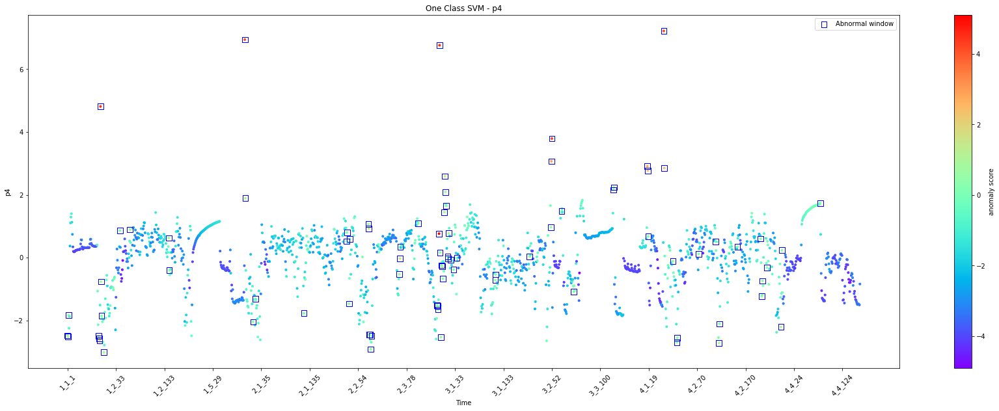

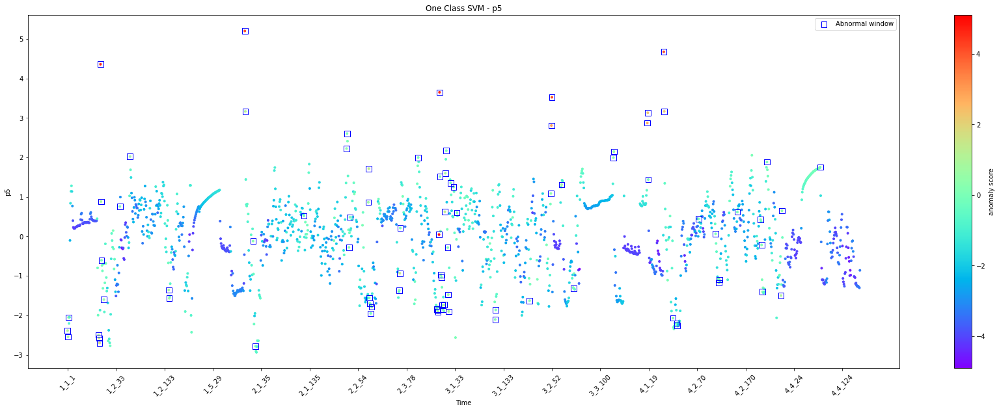

...

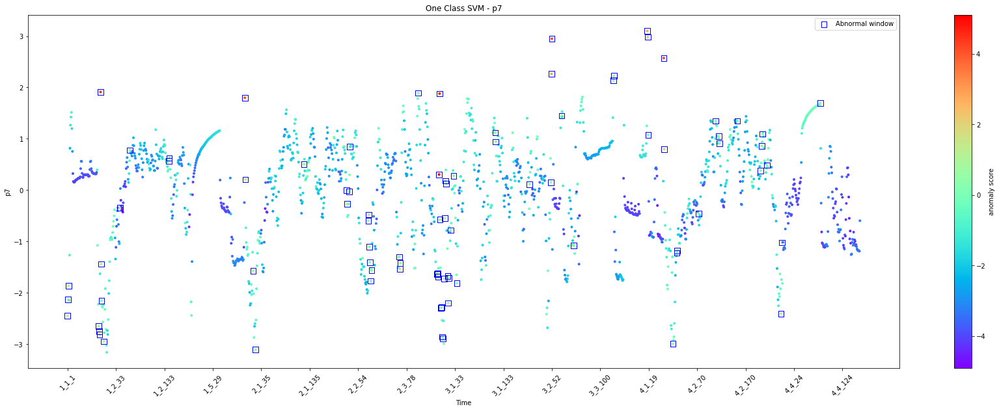

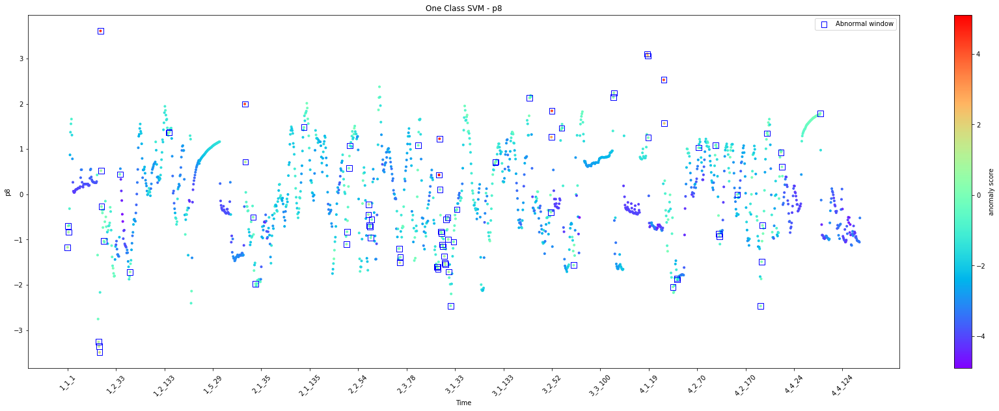

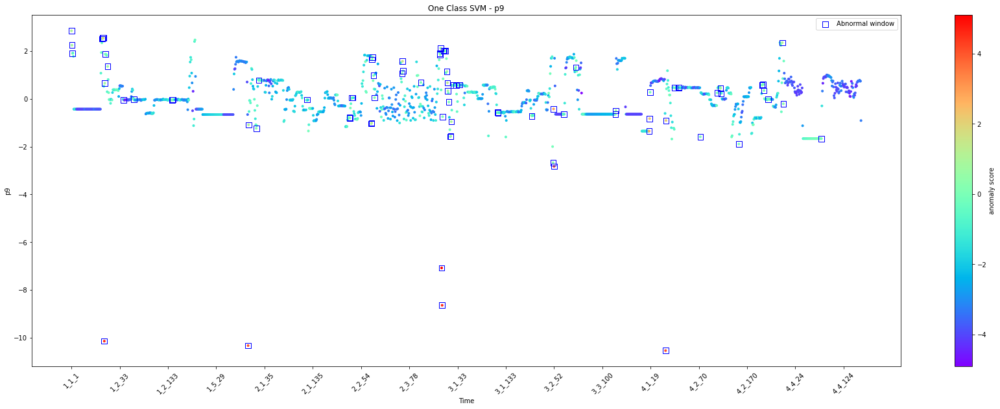

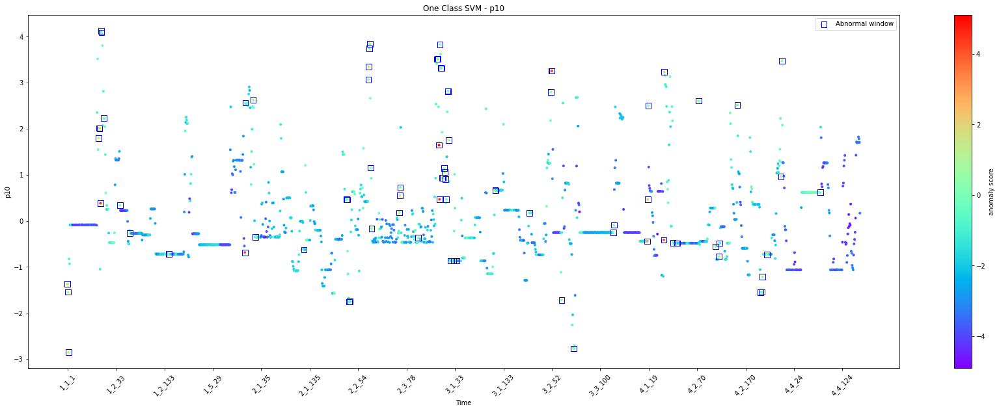

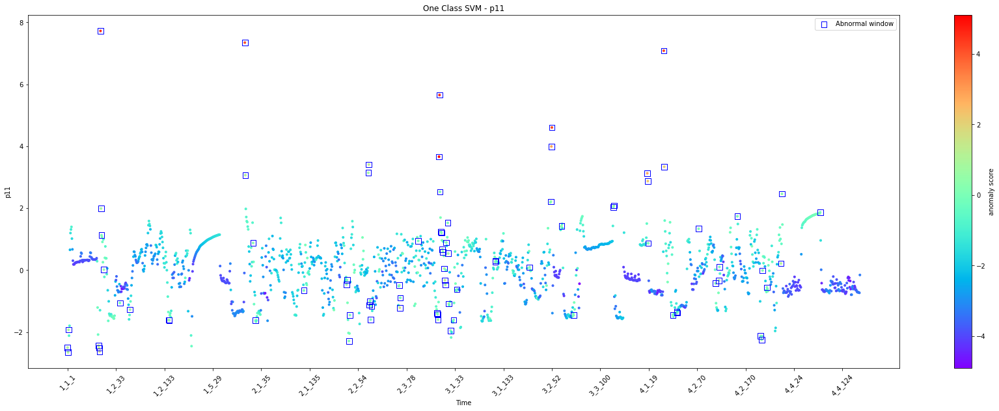

Detected abnormal windows: 83 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_65' '1_1_66' '1_1_67' '1_2_1' '1_2_2'
 '1_2_3' '1_2_8' '1_2_41' '1_2_62' '1_2_142' '1_2_143' '2_1_1' '2_1_2'
 '2_1_18' '2_1_23' '2_1_123' '2_2_30' '2_2_31' '2_2_35' '2_2_37' '2_2_75'
 '2_2_76' '2_3_1' '2_3_2' '2_3_4' '2_3_6' '2_3_63' '2_3_64' '2_3_65'
 '2_3_102' '2_3_141' '2_3_142' '2_3_143' '2_3_145' '3_1_1' '3_1_2' '3_1_4'
 '3_1_5' '3_1_7' '3_1_8' '3_1_11' '3_1_12' '3_1_13' '3_1_15' '3_1_18'
 '3_1_19' '3_1_20' '3_1_24' '3_1_30' '3_1_37' '3_1_116' '3_1_117' '3_2_6'
 '3_2_50' '3_2_51' '3_2_52' '3_3_20' '3_3_45' '3_3_127' '3_3_128' '4_1_16'
 '4_1_17' '4_1_18' '4_2_1' '4_2_2' '4_2_20' '4_2_28' '4_2_29' '4_2_73'
 '4_2_108' '4_2_115' '4_2_116' '4_2_153' '4_3_20' '4_3_22' '4_3_24'
 '4_3_33' '4_3_62' '4_3_64' '4_4_78']


DETECTING ANOMALIES WITH PCA...



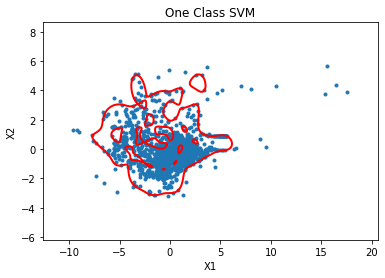

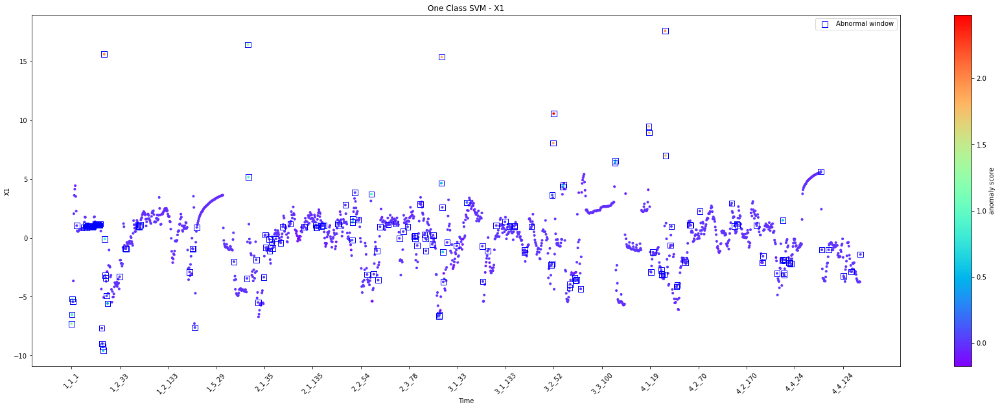

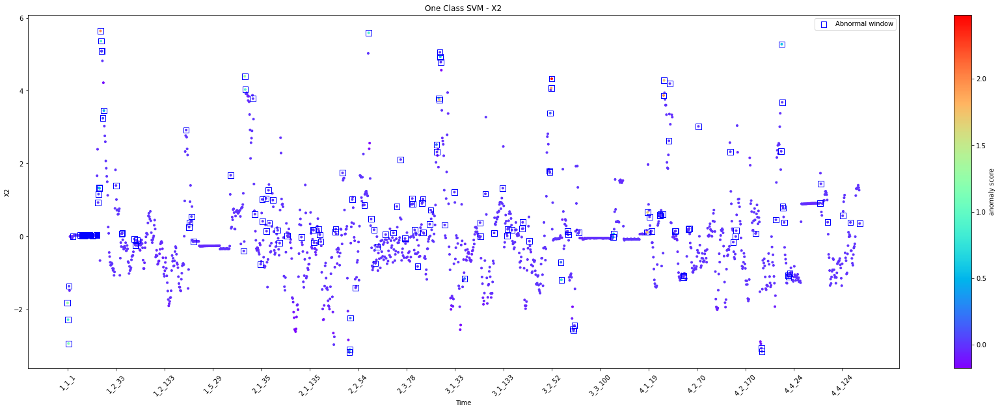

Detected abnormal windows: 185 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_4' '1_1_12' '1_1_27' '1_1_31' '1_1_32'
 '1_1_33' '1_1_34' '1_1_35' '1_1_36' '1_1_37' '1_1_38' '1_1_39' '1_1_40'
 '1_1_41' '1_1_42' '1_1_43' '1_1_44' '1_1_45' '1_1_46' '1_1_52' '1_1_53'
 '1_1_54' '1_1_55' '1_1_56' '1_1_57' '1_1_58' '1_1_59' '1_1_60' '1_1_61'
 '1_1_64' '1_1_65' '1_1_66' '1_1_67' '1_2_1' '1_2_2' '1_2_3' '1_2_4'
 '1_2_6' '1_2_8' '1_2_33' '1_2_45' '1_2_46' '1_2_71' '1_2_73' '1_2_74'
 '1_2_76' '1_2_178' '1_3_3' '1_3_4' '1_4_2' '1_4_6' '1_5_66' '1_5_93'
 '2_1_1' '2_1_2' '2_1_18' '2_1_22' '2_1_34' '2_1_37' '2_1_38' '2_1_45'
 '2_1_46' '2_1_50' '2_1_52' '2_1_59' '2_1_69' '2_1_73' '2_1_89' '2_1_118'
 '2_1_142' '2_1_143' '2_1_144' '2_1_153' '2_1_156' '2_1_158' '2_2_7'
 '2_2_8' '2_2_22' '2_2_36' '2_2_37' '2_2_38' '2_2_42' '2_2_49' '2_2_67'
 '2_2_76' '2_3_5' '2_3_11' '2_3_14' '2_3_18' '2_3_35' '2_3_51' '2_3_58'
 '2_3_66' '2_3_75' '2_3_89' '2_3_90' '2_3_91' '2_3_95' '2_3_101' '2_3_110'
 '2_3_112' '2_3_113' '2_3_126'

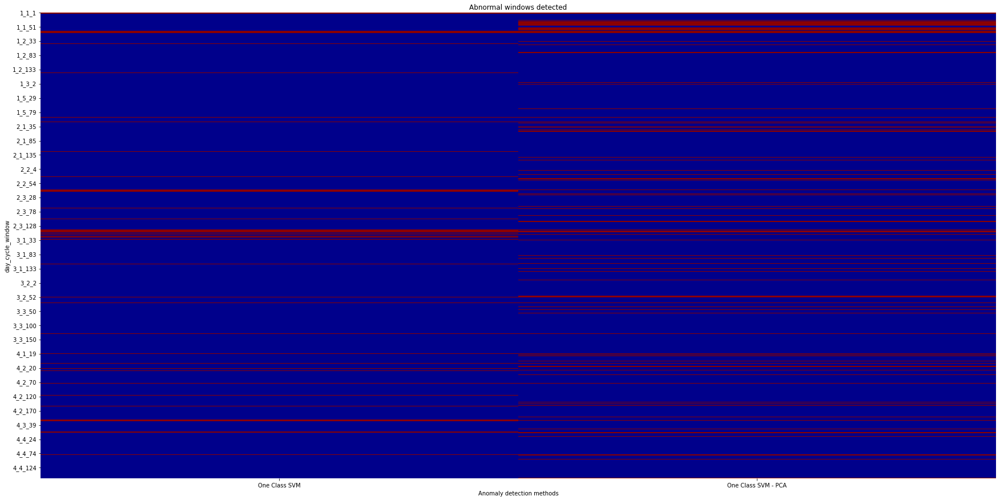

(array([-1, -1, -1, ...,  1,  1,  1]), array([-1, -1, -1, ...,  1,  1, -1]))

In [29]:
clf_name = 'One Class SVM'
clf = OneClassSVM(nu=0.05, kernel="rbf", gamma='auto')
pca_comparaison(clf_name,clf,df_means,parameters,df_pca,parameters_pca_means)

DETECTING ANOMALIES WITHOUT PCA...



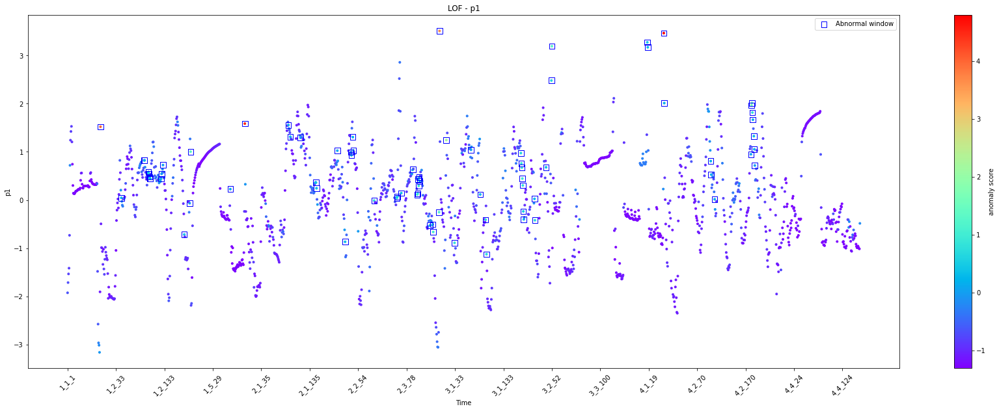

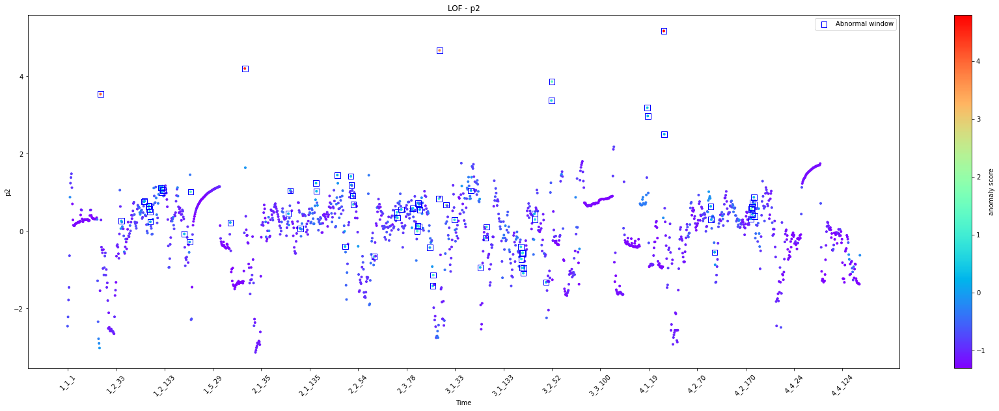

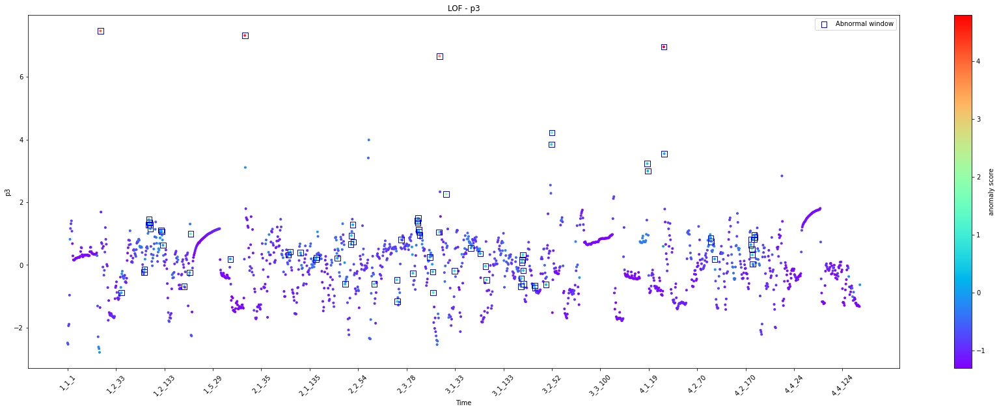

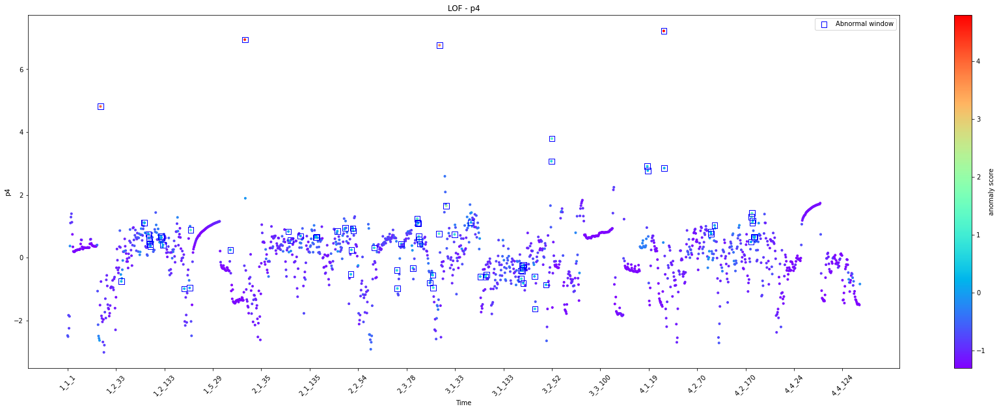

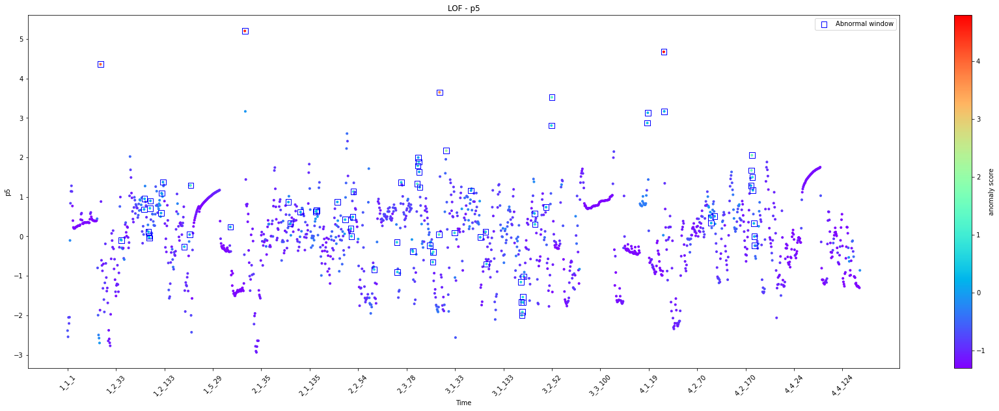

...

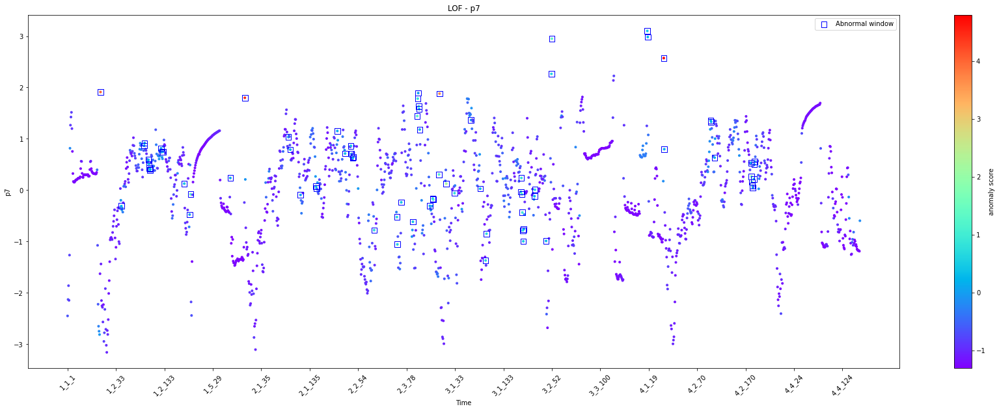

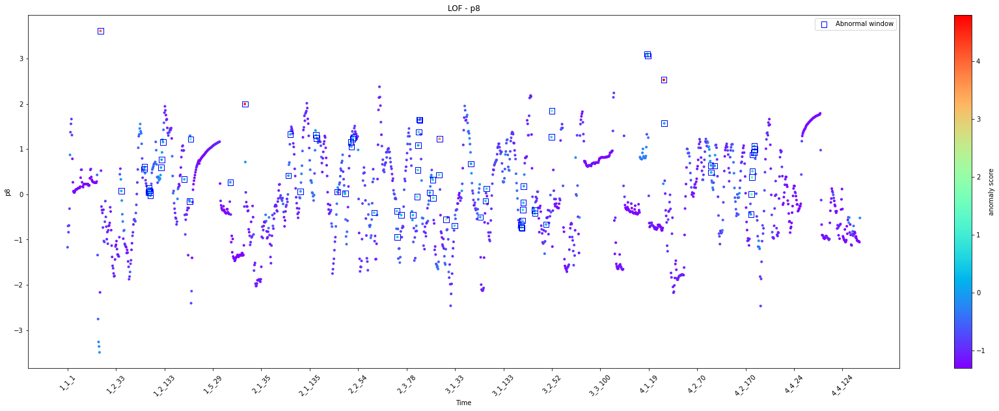

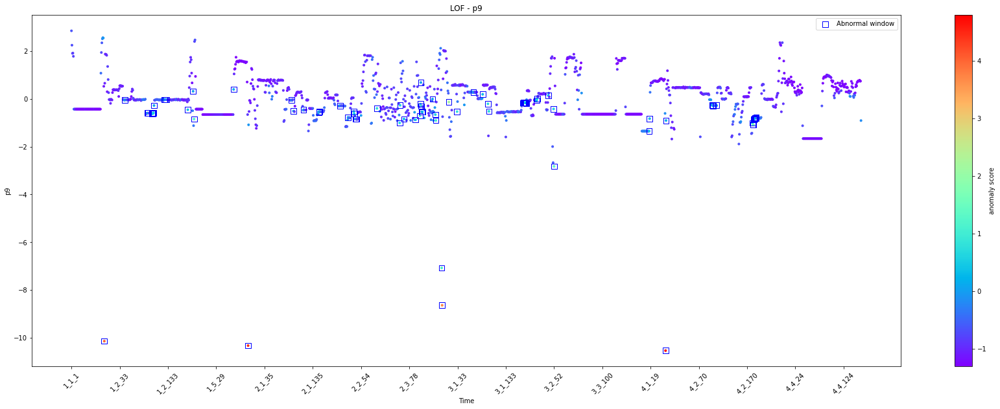

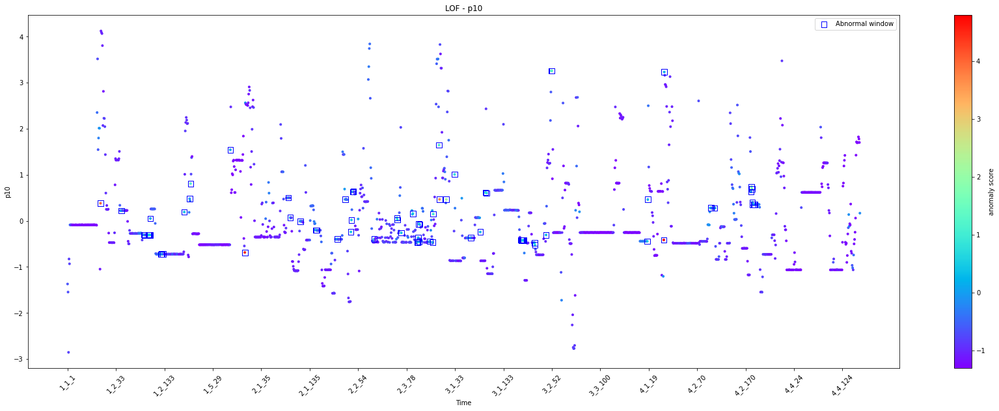

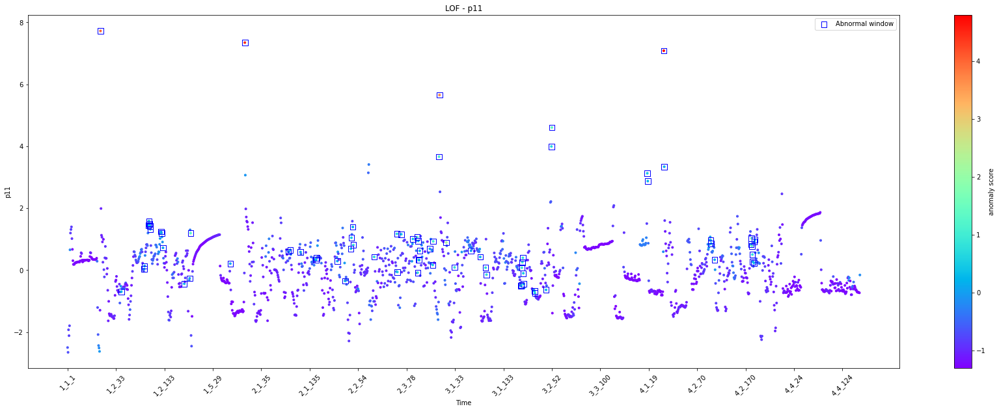

Detected abnormal windows: 77 / 1636

['1_2_1' '1_2_44' '1_2_91' '1_2_92' '1_2_100' '1_2_101' '1_2_102'
 '1_2_103' '1_2_104' '1_2_126' '1_2_127' '1_2_130' '1_2_174' '1_3_4'
 '1_3_6' '1_5_65' '2_1_1' '2_1_91' '2_1_95' '2_1_116' '2_1_148' '2_1_149'
 '2_2_11' '2_2_27' '2_2_39' '2_2_40' '2_2_43' '2_2_44' '2_3_11' '2_3_58'
 '2_3_59' '2_3_67' '2_3_91' '2_3_100' '2_3_101' '2_3_102' '2_3_103'
 '2_3_104' '2_3_105' '2_3_126' '2_3_132' '2_3_133' '2_3_145' '3_1_1'
 '3_1_15' '3_1_32' '3_1_66' '3_1_85' '3_1_96' '3_1_98' '3_1_169' '3_1_170'
 '3_1_171' '3_1_172' '3_1_173' '3_1_174' '3_1_175' '3_2_16' '3_2_17'
 '3_2_40' '3_2_51' '3_2_52' '4_1_16' '4_1_17' '4_2_1' '4_2_2' '4_2_98'
 '4_2_99' '4_2_106' '4_2_181' '4_3_1' '4_3_2' '4_3_3' '4_3_4' '4_3_6'
 '4_3_7' '4_3_8']


DETECTING ANOMALIES WITH PCA...



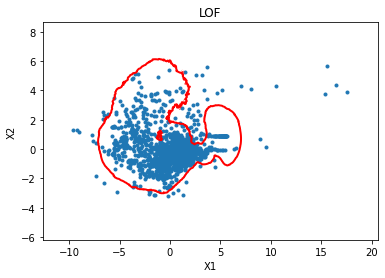

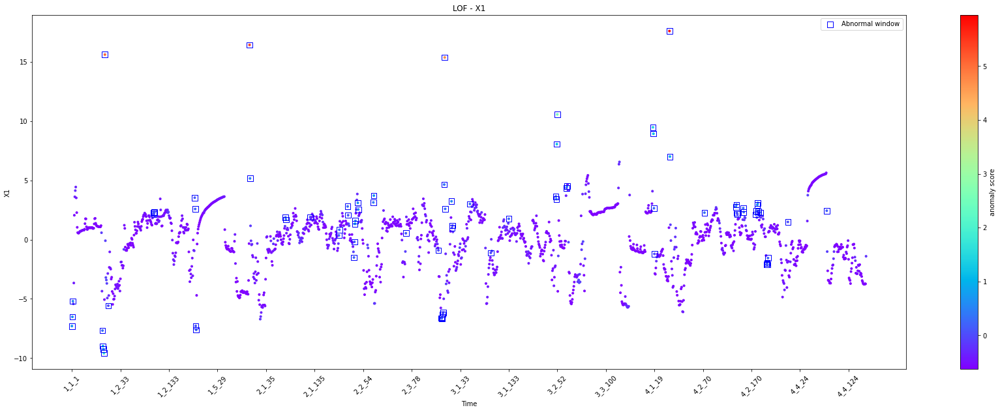

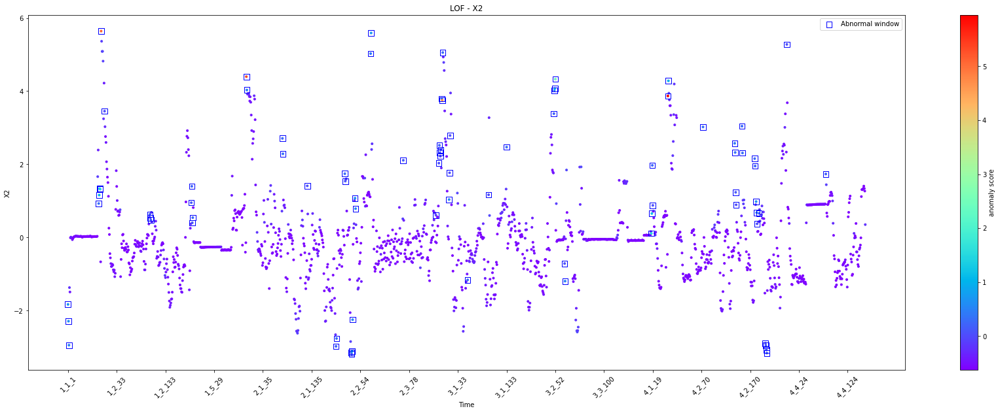

Detected abnormal windows: 80 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_64' '1_1_65' '1_1_66' '1_1_67' '1_2_1'
 '1_2_8' '1_2_101' '1_2_102' '1_2_103' '1_3_5' '1_3_6' '1_4_1' '1_4_2'
 '2_1_1' '2_1_2' '2_1_75' '2_1_76' '2_1_126' '2_2_4' '2_2_5' '2_2_22'
 '2_2_23' '2_2_35' '2_2_36' '2_2_37' '2_2_38' '2_2_43' '2_2_44' '2_2_75'
 '2_2_76' '2_3_66' '2_3_133' '2_3_139' '2_3_140' '2_3_141' '2_3_142'
 '2_3_143' '2_3_145' '3_1_1' '3_1_2' '3_1_15' '3_1_16' '3_1_17' '3_1_53'
 '3_1_96' '3_1_133' '3_2_49' '3_2_50' '3_2_51' '3_2_52' '3_3_19' '3_3_20'
 '4_1_16' '4_1_17' '4_1_18' '4_1_19' '4_2_1' '4_2_2' '4_2_73' '4_2_138'
 '4_2_139' '4_2_140' '4_2_141' '4_2_153' '4_2_154' '4_2_179' '4_2_180'
 '4_3_1' '4_3_2' '4_3_3' '4_3_7' '4_3_20' '4_3_21' '4_3_22' '4_3_23'
 '4_3_64' '4_4_79']


COMPARING THE METHODS...



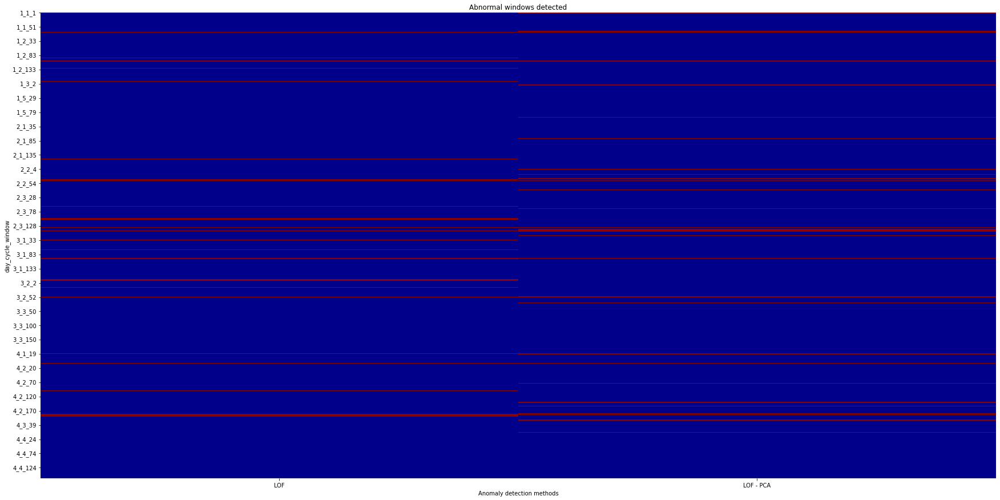

(array([1, 1, 1, ..., 1, 1, 1]), array([-1, -1, -1, ...,  1,  1,  1]))

In [30]:
clf_name = 'LOF'
clf = LocalOutlierFactor(n_neighbors=50, contamination=0.05, novelty=True)
pca_comparaison(clf_name,clf,df_means,parameters,df_pca,parameters_pca_means)

## What if we add other features ?

In [31]:
### Reading the dataset
df = pd.read_csv("dataset.csv")

# Séparer les colonnes 'day', 'cycle', et 'window' et les convertir en entier
df[['day', 'cycle', 'window']] = df['day_cycle_window'].str.split('_', expand=True)
df[['day', 'cycle', 'window']] = df[['day', 'cycle', 'window']].astype(int)

# Sélectionner uniquement les colonnes numériques pour le calcul des statistiques
numeric_columns = df.select_dtypes(include=['number']).columns.difference(['day', 'cycle', 'window'])

# Calculer la moyenne et l'écart-type pour chaque groupe 'day_cycle_window' sur les colonnes numériques seulement
df_features = df.groupby('day_cycle_window')[numeric_columns].agg(['mean', 'std','median','min','max']).reset_index()

# Aplatir les en-têtes multi-niveaux pour obtenir des noms de colonnes plus clairs
# Créer un nom de colonne au format 'param_mean' et 'param_std'
df_features.columns = [f"{col[0]}_{col[1]}" if col[1] else col[0] for col in df_features.columns]

# Filtrer les colonnes uniquement relatives aux paramètres (p1, p2, ..., p11)
param_columns = [col for col in df_features.columns if col.startswith('p')]

# Trier les colonnes paramétriques (p1, p2, ..., p11) dans l'ordre croissant
# Extraire le numéro de paramètre après 'p' et trier par ce numéro
param_columns_sorted = sorted(param_columns, key=lambda x: int(x.split('_')[0][1:]))

# Réorganiser df_features avec les colonnes triées et ajouter les autres colonnes non-paramétriques à la fin
df_features = df_features[param_columns_sorted + [col for col in df_features.columns if col not in param_columns_sorted]]

df_features[['day', 'cycle', 'window']] = df_features['day_cycle_window'].str.split('_', expand=True)
df_features[['day', 'cycle', 'window']] = df_features[['day', 'cycle', 'window']].astype(int)
df_features = df_features.sort_values(by=['day', 'cycle', 'window']).reset_index(drop=True)
df_features = df_features.drop(columns=['day', 'cycle', 'window'])

# Afficher les premières lignes pour vérifier
df_features.head()



,p1_mean,p1_std,p1_median,p1_min,p1_max,p2_mean,p2_std,p2_median,p2_min,p2_max,...,p10_std,p10_median,p10_min,p10_max,p11_mean,p11_std,p11_median,p11_min,p11_max,day_cycle_window
0,-1.926141,0.591155,-1.849016,-3.107670,-0.805191,-2.456284,0.739638,-2.565392,-3.395387,-1.112276,...,0.673869,-1.748105,-2.283434,0.495528,-2.500060,0.724468,-2.857906,-3.183571,-1.244472,1_1_1
1,-1.714067,0.197499,-1.798110,-1.953996,-1.330915,-2.217161,0.109149,-2.198342,-2.471116,-2.029273,...,0.497962,-1.687537,-2.099826,-0.772787,-2.654753,0.262073,-2.575661,-3.132542,-2.302767,1_1_2
2,-1.534357,0.458886,-1.448777,-2.442716,-0.987386,-1.779994,0.463978,-1.754517,-2.501740,-1.150615,...,0.459387,-3.054871,-3.308274,-1.781047,-1.926807,0.474839,-2.080907,-2.526851,-1.222144,1_1_3
3,-1.415197,0.177273,-1.398369,-2.165870,-1.217565,-1.453962,0.215131,-1.369965,-2.130489,-1.282602,...,0.398511,-0.720180,-1.590155,-0.347429,-2.117340,0.107617,-2.083121,-2.371545,-1.989938,1_1_4
4,-0.732715,0.386954,-0.874543,-1.287800,0.064758,-0.634379,0.536726,-0.808077,-1.439102,0.426946,...,1.219066,-1.245751,-2.082270,3.565082,-1.796746,0.803952,-2.371545,-2.520195,-0.250517,1_1_5


In [32]:
def plot_time_series_feature(df,param,feature_to_plot):
    """
    Plot the time series of the parameter param (str : 'p1','p2',...,'p11')
    """
    fig, ax = plt.subplots()
    ax.scatter(df['day_cycle_window'],df[f'{param}_{feature_to_plot}'],marker='.',c=colors[int(param[1:])-1])
    ax.set_xlabel('day_cycle_window')
    ax.set_ylabel(f"{param}_{feature_to_plot} by window")
    ax.set_xticks(df['day_cycle_window'][::100])
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

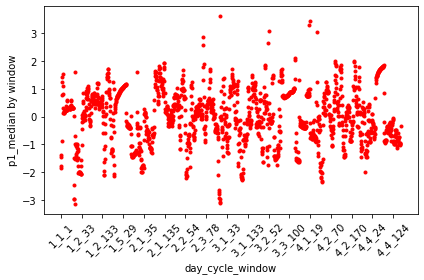

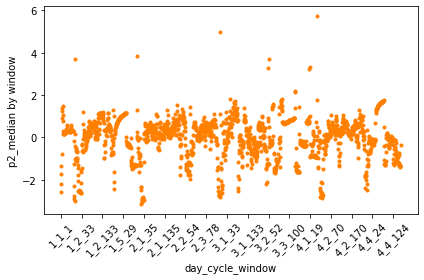

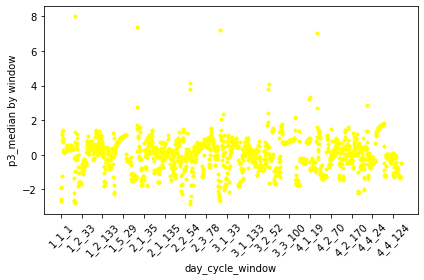

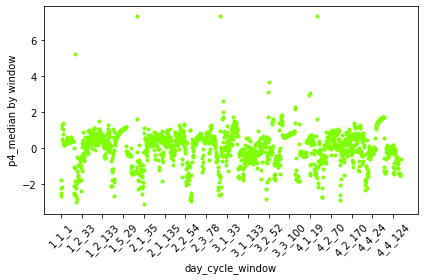

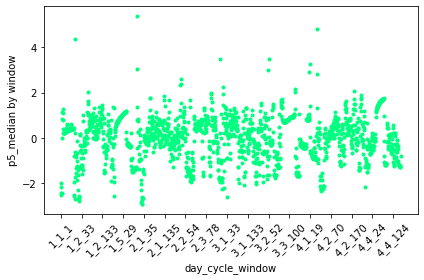

...

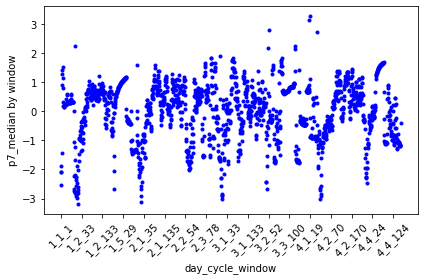

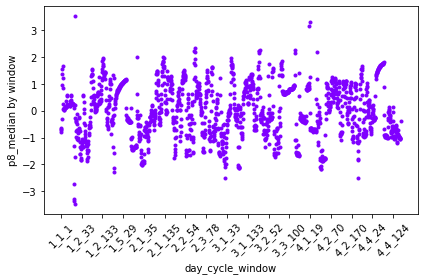

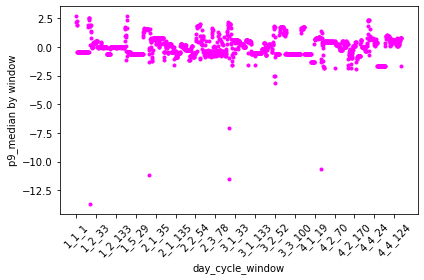

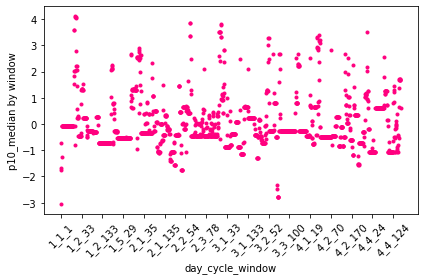

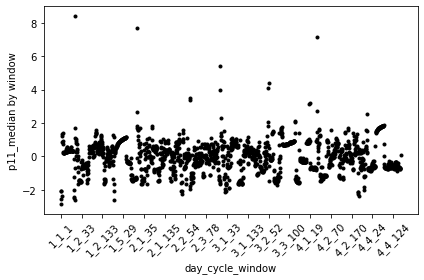

In [33]:
# Visualize the time series of the means by window for each parameter
for k in range(1,12):
    plot_time_series_feature(df_features,f'p{k}','median')

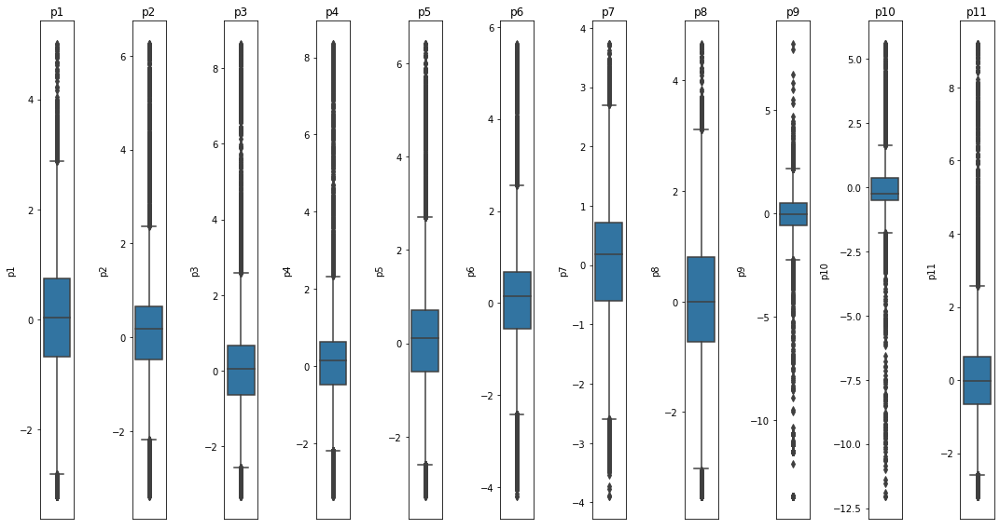

In [34]:
# Supposons que df_features contient les colonnes p1, p2, ..., p11
parameters = ['p1', 'p2', 'p3', 'p4', 'p5', 'p6', 'p7', 'p8', 'p9', 'p10', 'p11']

# Créer une figure et des sous-graphiques (subplots) pour chaque paramètre
plt.figure(figsize=(15, 8))  # Ajuster la taille en fonction du nombre de paramètres

# Boucle pour créer un boxplot pour chaque paramètre
for i, param in enumerate(parameters):
    plt.subplot(1, len(parameters), i + 1)
    sns.boxplot(y=df[param])
    plt.title(param)
    plt.xticks([])  # Enlever les labels de l'axe x pour chaque boxplot

plt.tight_layout()  # Ajuster les espacements entre les sous-graphiques
plt.show()

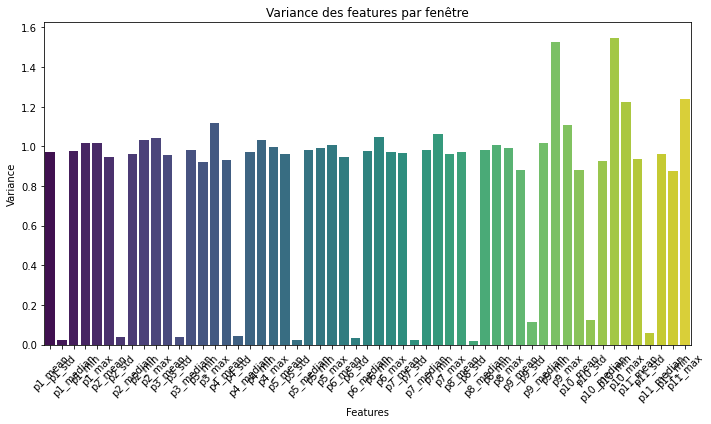

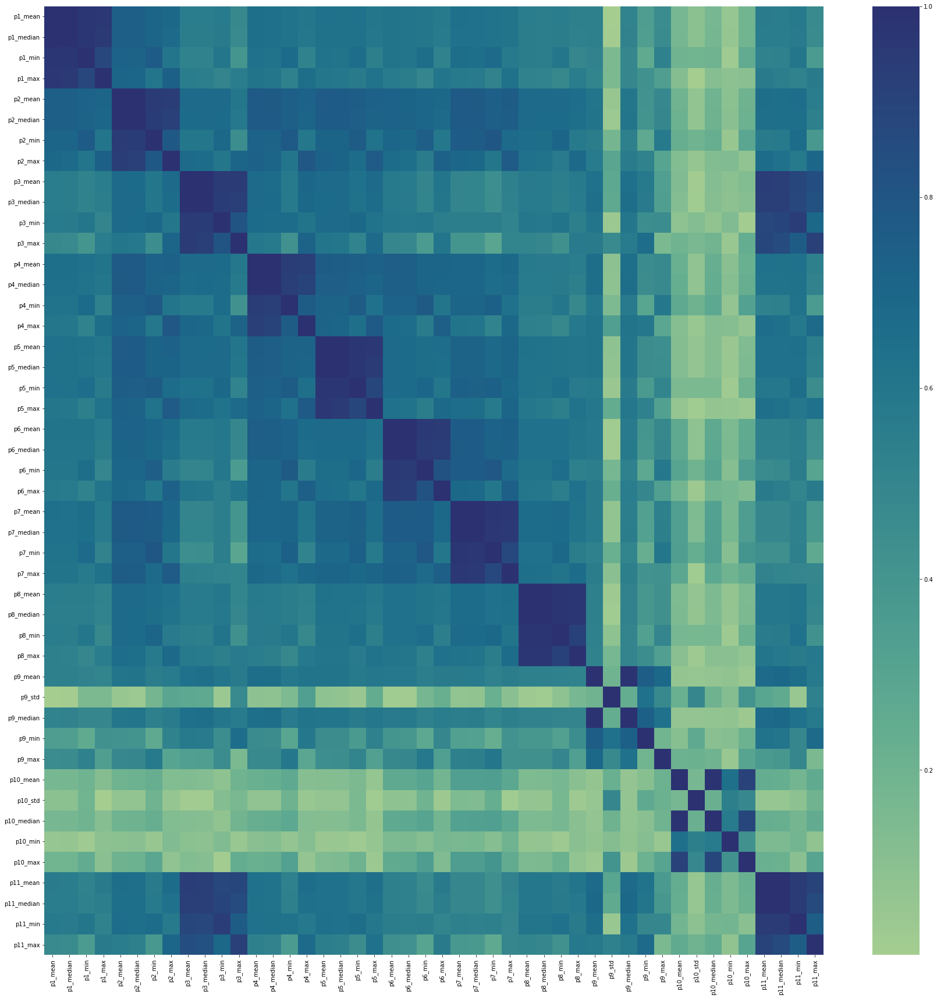

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


['p1_median', 'p2_median', 'p3_median', 'p4_median', 'p5_median', 'p6_median', 'p7_median', 'p8_median', 'p11_median']


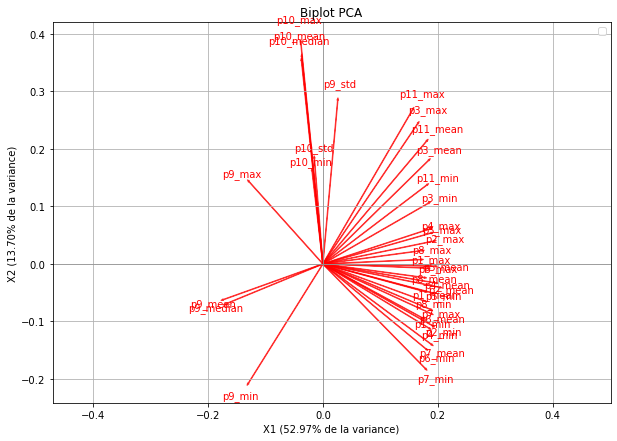

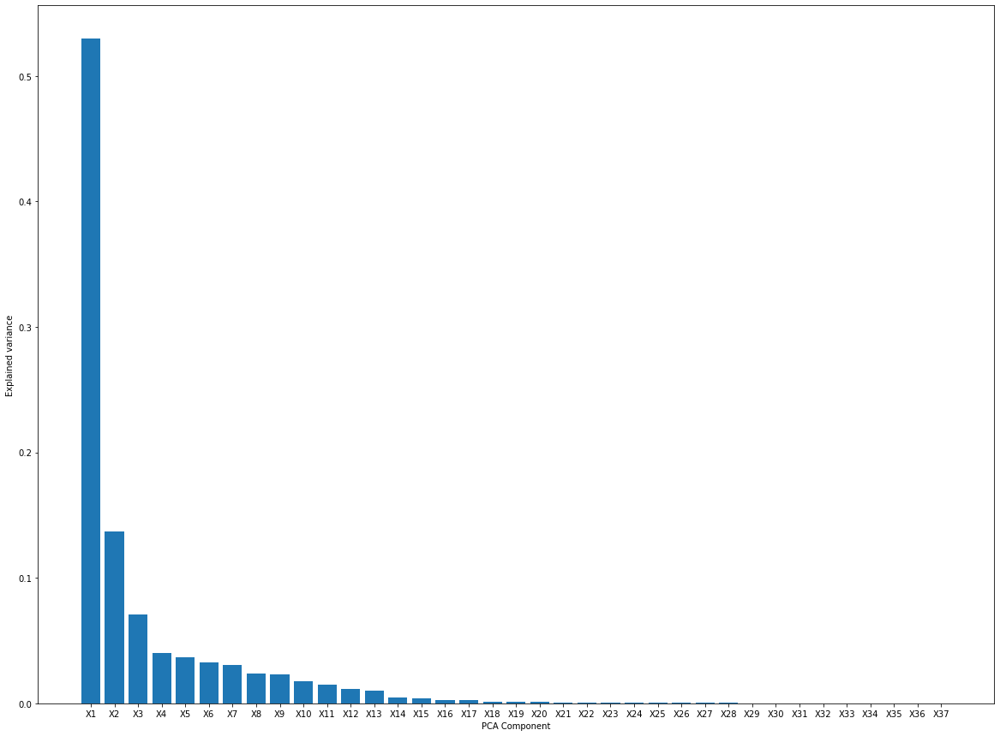

Explained variance by component : [5.29653201e-01 1.36989523e-01 7.06355468e-02 4.00926475e-02
 3.64900880e-02 3.23714262e-02 3.07129828e-02 2.39028898e-02
 2.28245722e-02 1.73541580e-02 1.51264739e-02 1.17912850e-02
 1.00921974e-02 4.79982089e-03 4.23690625e-03 2.60376765e-03
 2.38760188e-03 1.43020587e-03 1.08735156e-03 9.03505683e-04
 8.20002723e-04 6.59925731e-04 6.16709117e-04 4.98304925e-04
 3.96917020e-04 3.27346014e-04 2.61098206e-04 2.11792733e-04
 1.42718975e-04 1.20810600e-04 1.01918292e-04 9.25647914e-05
 7.88237010e-05 6.25969396e-05 4.78957940e-05 4.22317027e-05
 3.21910687e-05]
Cumulated explained variance : [0.5296532  0.66664272 0.73727827 0.77737092 0.81386101 0.84623243
 0.87694542 0.90084831 0.92367288 0.94102704 0.95615351 0.96794479
 0.97803699 0.98283681 0.98707372 0.98967749 0.99206509 0.99349529
 0.99458265 0.99548615 0.99630615 0.99696608 0.99758279 0.99808109
 0.99847801 0.99880536 0.99906646 0.99927825 0.99942097 0.99954178
 0.9996437  0.99973626 0.99981508 

,X1,X2,X3,X4,X5,X6,X7,X8,X9,X10,...,X29,X30,X31,X32,X33,X34,X35,X36,X37,day_cycle_window
0,-12.303596,-0.955507,4.376034,-2.222642,-0.856844,0.067257,-1.351655,0.245755,-0.072718,-0.363544,...,-0.111948,0.162547,-0.044291,-0.033375,-0.101448,-0.054192,-0.007751,-0.320581,-0.131021,1_1_1
1,-11.253901,-3.108320,2.820723,-0.941468,-2.010830,0.685893,-1.106210,-0.065475,-1.295811,-0.991123,...,-0.006587,-0.027614,0.097246,0.042946,-0.051691,0.059295,-0.014763,0.121403,0.005392,1_1_2
2,-9.091116,-3.432163,4.854588,-0.433840,-0.915586,-0.345406,-2.395416,0.168079,-0.924956,-0.466770,...,-0.028081,0.084798,0.011837,-0.061242,0.010525,0.011885,-0.000457,-0.104254,0.054741,1_1_3
3,-9.794412,-1.757115,1.875780,-0.760423,-1.453632,0.483369,-0.820885,0.167829,-1.231058,-0.909386,...,-0.035608,0.110659,-0.033510,-0.102687,0.139193,-0.014223,0.003504,-0.086506,0.043253,1_1_4
4,-5.712511,1.711599,5.364697,-2.853033,-1.542269,1.133139,0.350816,0.129568,-2.171056,0.013155,...,0.234628,-0.120607,-0.534732,-0.144021,0.126010,-0.029960,0.026005,-0.014903,-0.070953,1_1_5


In [35]:
parameters_features = [col for col in df_features.columns if col.startswith('p')]

# Supposons que 'df' est votre DataFrame original et que 'parameters' est la liste des colonnes de paramètres
X = df_features[parameters_features]  # Sélection des colonnes de paramètres

# Standardiser les données
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled,columns=parameters_features)

# Calculer les variances des features
variances = X.var(axis=0)  # Calcule la variance pour chaque feature
#print(variances)

# Plot des variances par feature
plt.figure(figsize=(10, 6))
sns.barplot(x=variances.index, y=variances.values, palette='viridis')

# Personnaliser le graphique
plt.title("Variance des features par fenêtre")
plt.xlabel("Features")
plt.ylabel("Variance")
plt.xticks(rotation=45)
plt.tight_layout()

plt.show(block=True)

# Définir le seuil de variance
seuil_variance = 0.1

# Sélectionner les colonnes où la variance est supérieure au seuil
colonnes_selecionnees = variances[variances > seuil_variance].index

# Filtrer le DataFrame pour ne conserver que les colonnes sélectionnées
X_scaled = X_scaled[colonnes_selecionnees]

# Calcul de la matrice de corrélation
corr_matrix = X_scaled.corr().abs()
plt.figure(figsize=(30,30))
sns.heatmap(corr_matrix, cmap="crest")
plt.show(block=True)

# Suppression des features corrélées
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
to_drop = [column for column in upper.columns if any(upper[column] > 0.99)]
print(to_drop)
X_reduced_corr = X_scaled.drop(columns=to_drop)

# Appliquer la PCA pour obtenir les deux premières composantes
pca = PCA()
X_pca = pca.fit_transform(X_reduced_corr)

# Créer un DataFrame pour les composantes principales
parameters_pca_kept = [col for col in colonnes_selecionnees if col not in to_drop]
pca_components = [f'X{i}' for i in range(1, len(parameters_pca_kept)+1)]
df_pca = pd.DataFrame(X_pca,columns=pca_components)

# Création du biplot
plt.figure(figsize=(10, 7))

# Ajouter les points projetés sur les composantes principales
#plt.scatter(df_pca['X1'], df_pca['X2'], alpha=0.7, c='gray', edgecolor='k', label="Projections des données")


# Ajouter le cercle unité
circle = plt.Circle((0, 0), 1, color='b', fill=False, linestyle='--', linewidth=1)
plt.gca().add_artist(circle)    

# Ajouter les vecteurs des composantes
for i, (comp1, comp2) in enumerate(zip(pca.components_[0], pca.components_[1])):
    plt.arrow(0, 0, comp1, comp2,color='r', alpha=0.7)
    plt.text(comp1 * 1.1, comp2 * 1.1,
             parameters_pca_kept[i], color='r', ha='center', va='center')


# Étiquettes et légende
plt.xlabel(f"X1 ({pca.explained_variance_ratio_[0]*100:.2f}% de la variance)")
plt.ylabel(f"X2 ({pca.explained_variance_ratio_[1]*100:.2f}% de la variance)")
plt.title("Biplot PCA")
plt.axhline(0, color='grey', lw=0.5)
plt.axvline(0, color='grey', lw=0.5)
plt.legend()
plt.grid(True)
plt.axis('equal')
plt.show(block=True)


df_pca['day_cycle_window']=df_means['day_cycle_window']

# Displaying results
plt.figure(figsize=(20,15))
plt.bar(np.arange(1, len(parameters_pca_kept)+1),pca.explained_variance_ratio_)
plt.xticks(np.arange(1, len(parameters_pca_kept)+1),pca_components)
plt.xlabel('PCA Component')
plt.ylabel('Explained variance')
plt.show()
print("Explained variance by component :", pca.explained_variance_ratio_)
print("Cumulated explained variance :", pca.explained_variance_ratio_.cumsum())

# Component selection
pca_components_kept = [f'X{i}' for i in range(1, np.argmax(pca.explained_variance_ratio_.cumsum() > 0.95)+2)]
print("\n====================================================\n")
print(f"Components kept : {pca_components_kept} \n\t Cumulated explained variance = {pca.explained_variance_ratio_.cumsum()[len(pca_components_kept)-1]}")

df_pca.head()

In [36]:
# Elliptic envelope (MCD)

# Hyperparameters tuning
contamination = [0.01, 0.05, 0.1]

for c in contamination:
    # Initializing model with current values of tested hyperparameters
    model = EllipticEnvelope(contamination=c,random_state=42)

    # Model fitting and anomaly prediction
    predictions = model.fit_predict(df_pca[pca_components_kept])

    # Displaying results
    print(f"contamination={c}")
    print(f"Anomalies détectées: {np.sum(predictions == -1)} / {df_means.shape[0]-1}\n")

contamination=0.01
Anomalies détectées: 17 / 1636

contamination=0.05
Anomalies détectées: 82 / 1636

contamination=0.1
Anomalies détectées: 164 / 1636



DETECTING ANOMALIES WITHOUT PCA...



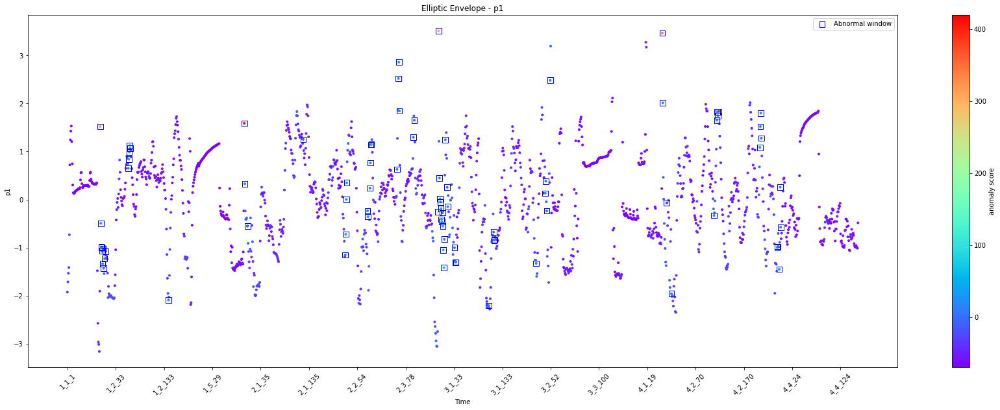

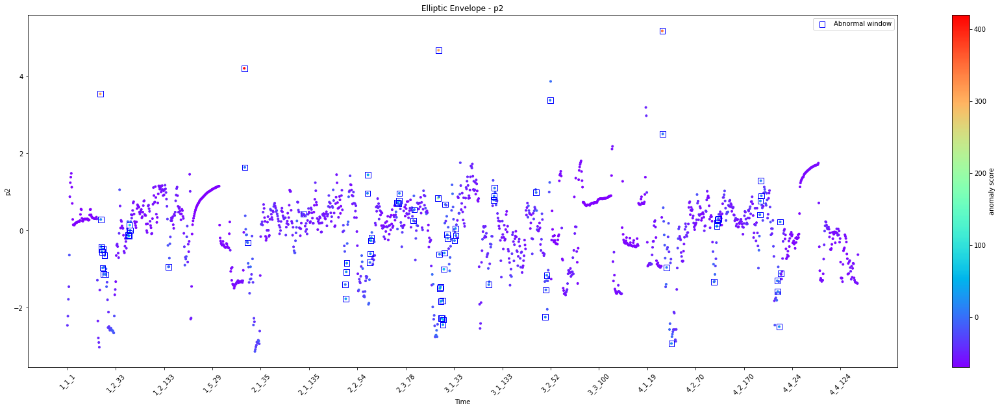

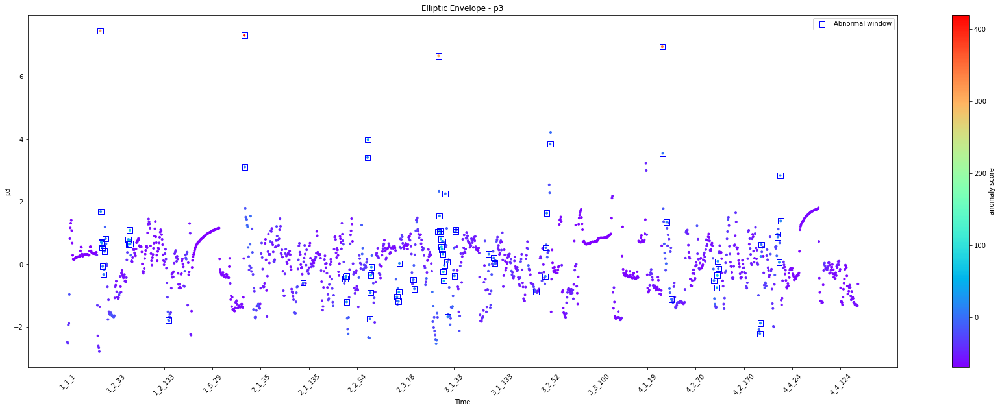

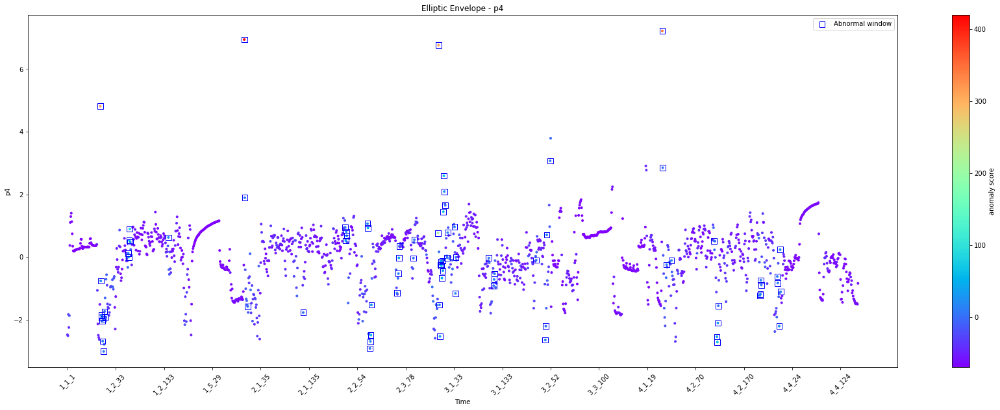

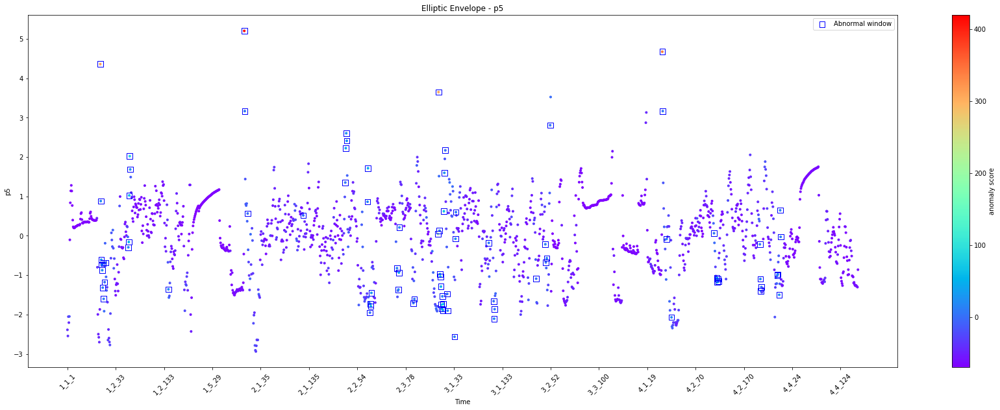

...

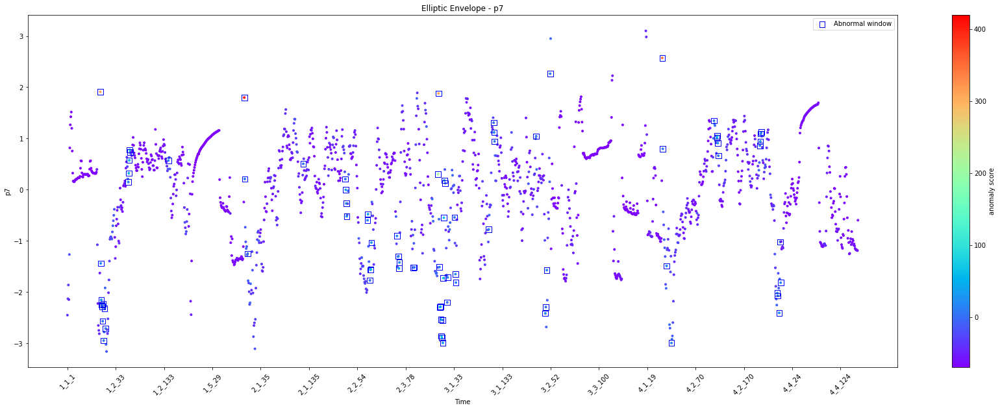

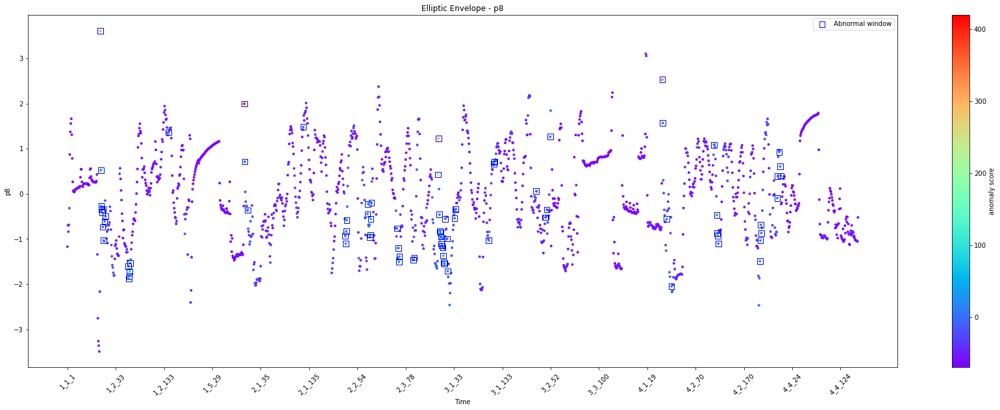

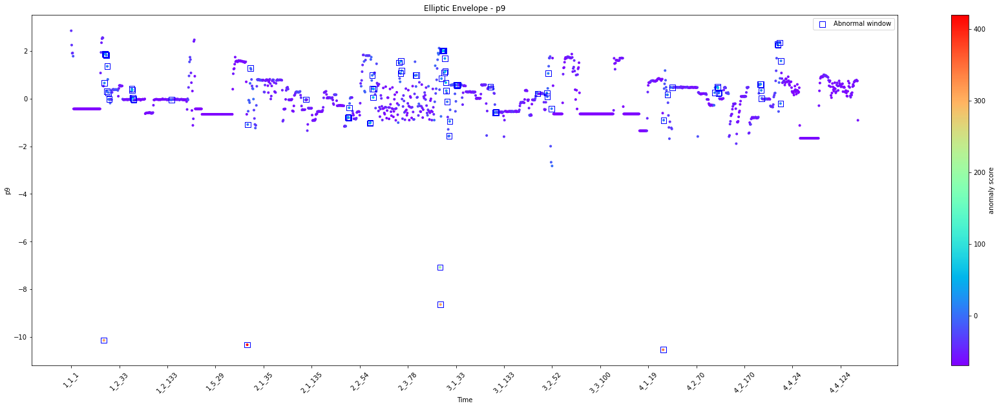

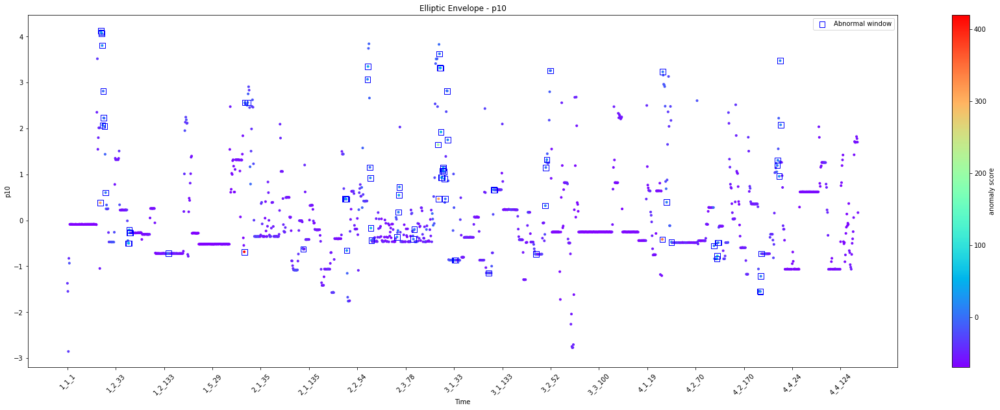

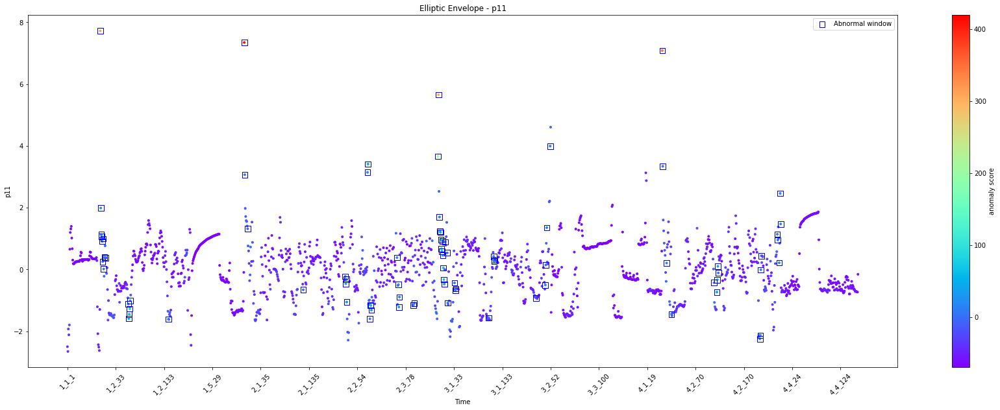

Detected abnormal windows: 82 / 1636

['1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_10'
 '1_2_12' '1_2_59' '1_2_60' '1_2_61' '1_2_62' '1_2_63' '1_2_142' '2_1_1'
 '2_1_2' '2_1_8' '2_1_123' '2_2_29' '2_2_30' '2_2_31' '2_2_32' '2_2_75'
 '2_2_76' '2_3_4' '2_3_5' '2_3_6' '2_3_7' '2_3_60' '2_3_63' '2_3_64'
 '2_3_65' '2_3_94' '2_3_96' '2_3_145' '3_1_1' '3_1_3' '3_1_4' '3_1_5'
 '3_1_6' '3_1_7' '3_1_8' '3_1_9' '3_1_10' '3_1_11' '3_1_12' '3_1_13'
 '3_1_15' '3_1_19' '3_1_20' '3_1_34' '3_1_36' '3_1_37' '3_1_105' '3_1_115'
 '3_1_116' '3_1_117' '3_2_22' '3_2_41' '3_2_42' '3_2_44' '3_2_51' '4_2_1'
 '4_2_2' '4_2_10' '4_2_20' '4_2_108' '4_2_114' '4_2_115' '4_2_116'
 '4_2_117' '4_3_22' '4_3_23' '4_3_24' '4_3_25' '4_3_58' '4_3_59' '4_3_62'
 '4_3_64' '4_3_65']


DETECTING ANOMALIES WITH PCA...



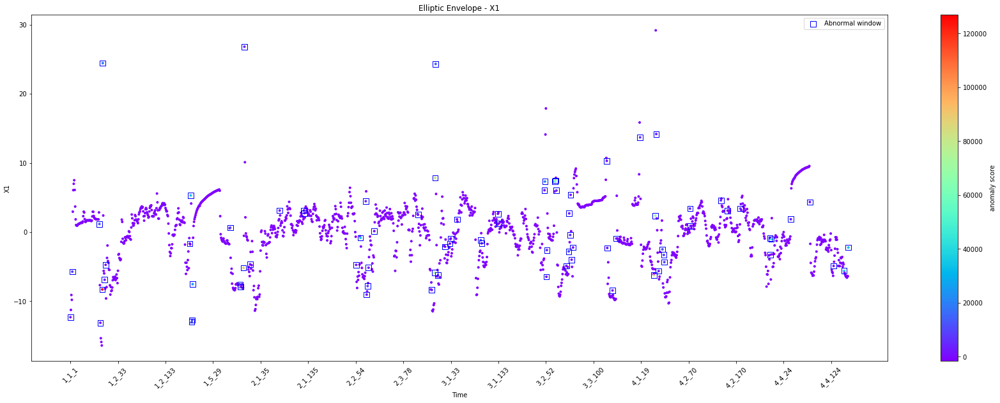

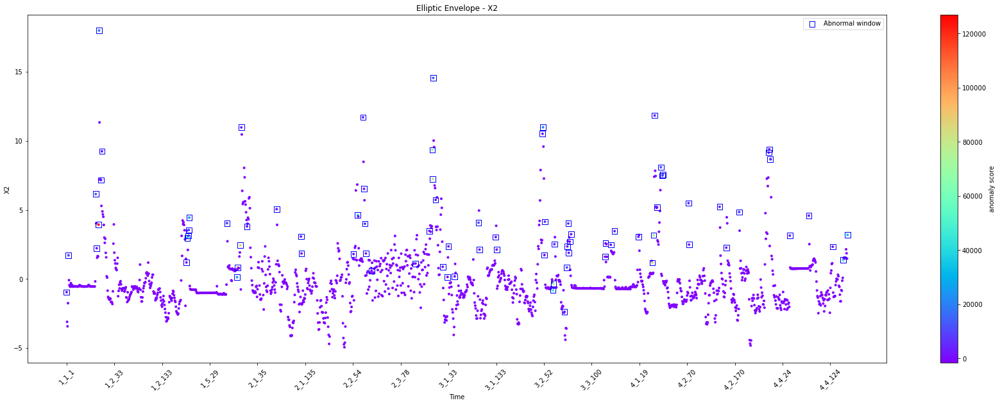

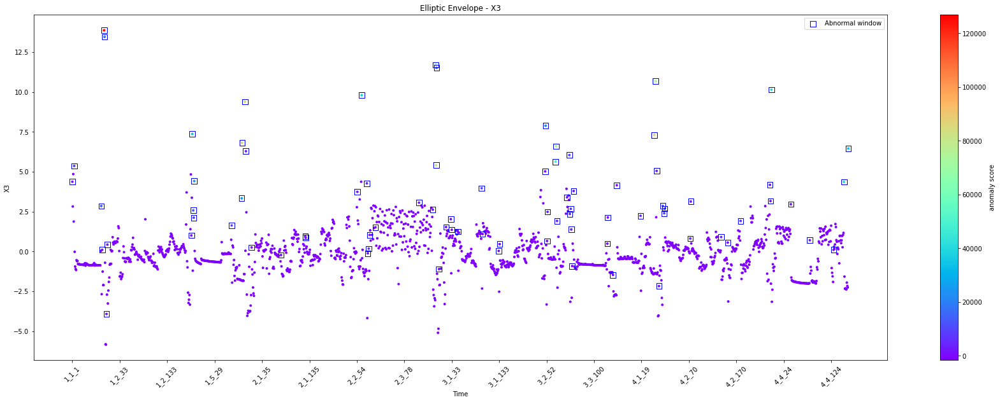

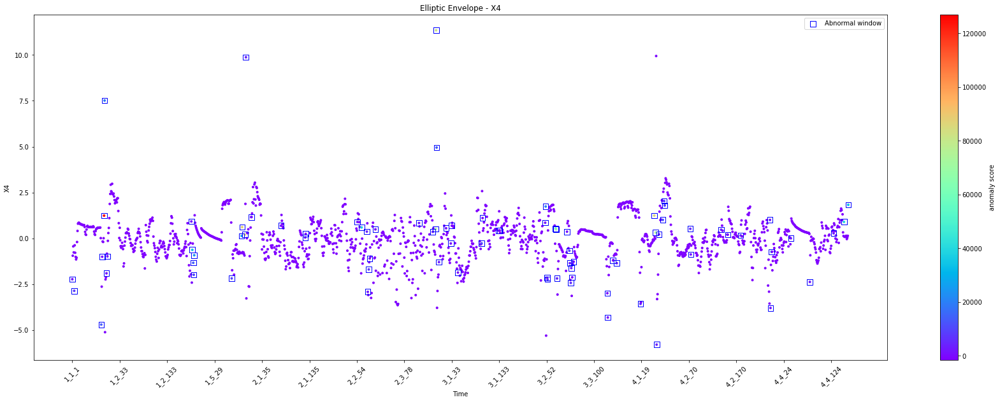

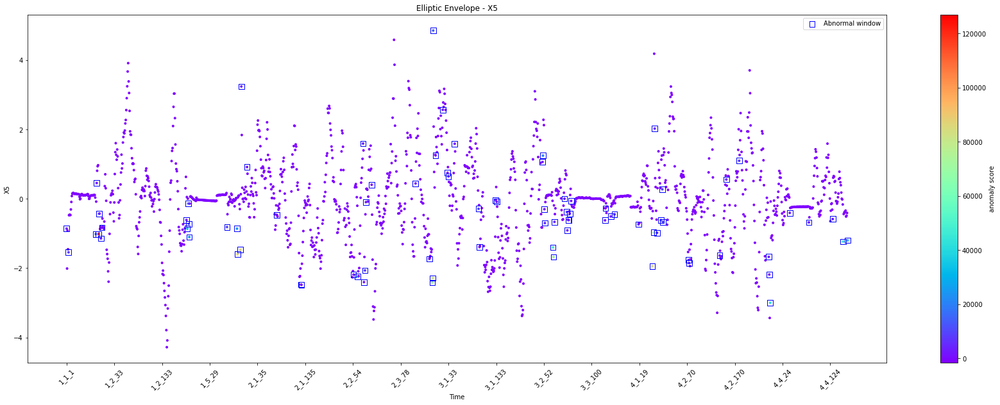

...

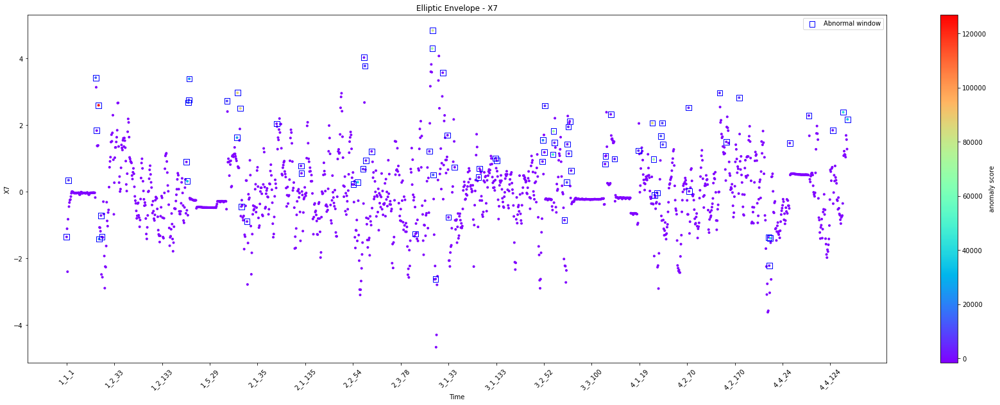

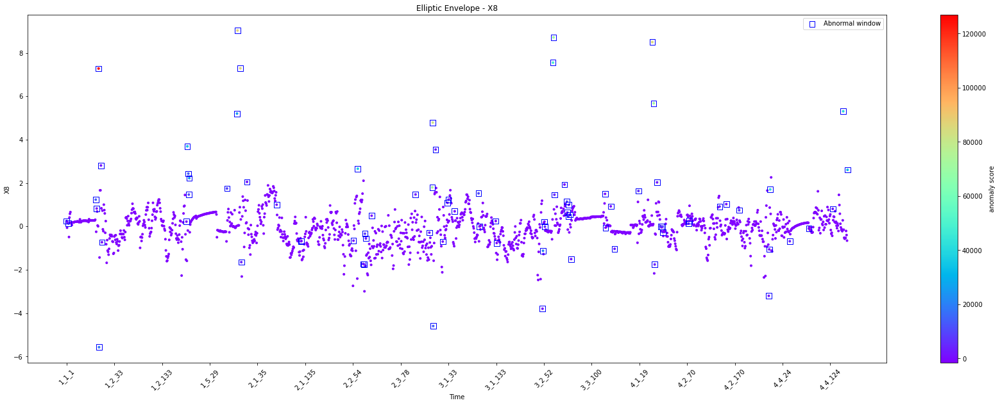

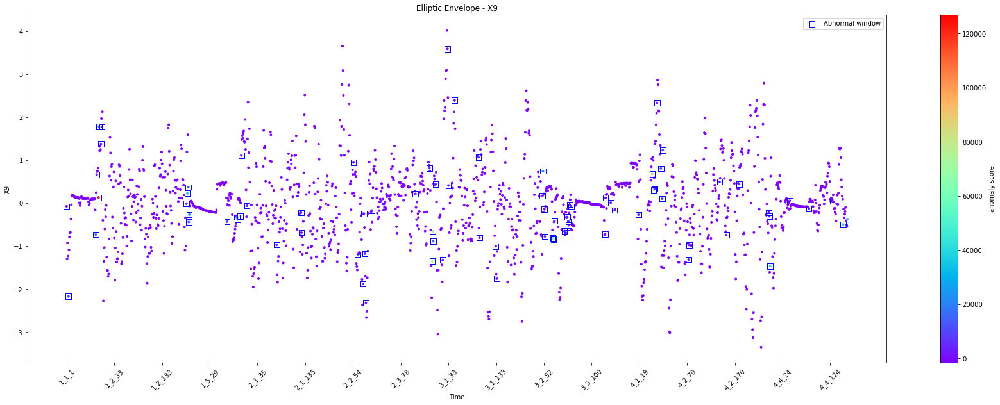

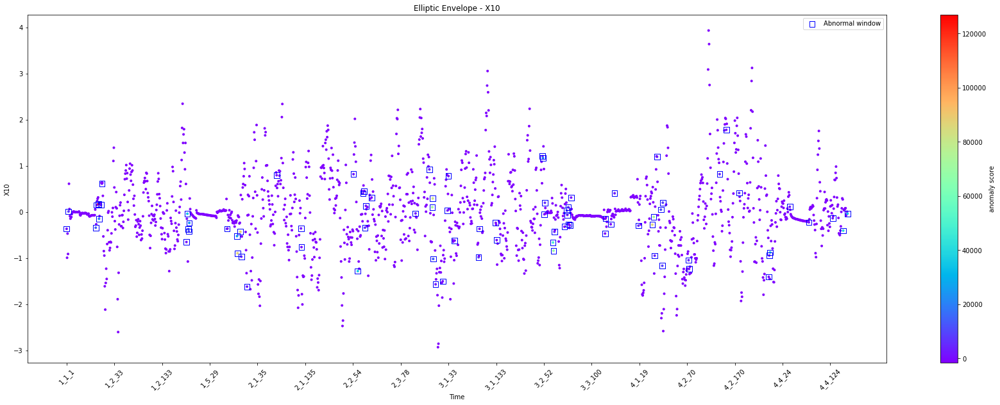

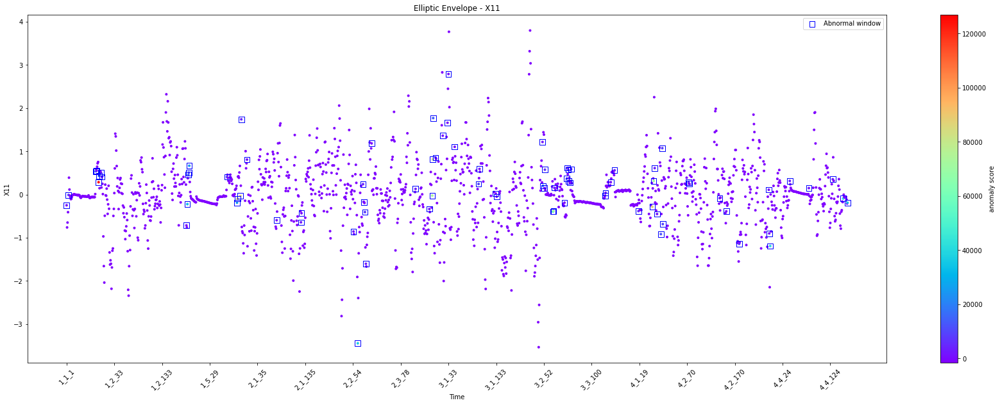

Detected abnormal windows: 82 / 1636

['1_1_1' '1_1_5' '1_1_62' '1_1_64' '1_1_68' '1_2_1' '1_2_5' '1_2_7'
 '1_3_3' '1_3_5' '1_4_1' '1_4_2' '1_4_3' '1_5_65' '1_5_86' '1_5_87'
 '1_5_93' '2_1_1' '2_1_13' '2_1_75' '2_1_126' '2_1_127' '2_2_55' '2_2_64'
 '2_2_75' '2_3_1' '2_3_3' '2_3_5' '2_3_17' '2_3_109' '2_3_138' '2_3_144'
 '2_3_145' '3_1_1' '3_1_6' '3_1_21' '3_1_31' '3_1_33' '3_1_46' '3_1_96'
 '3_1_98' '3_1_132' '3_1_134' '3_2_49' '3_2_50' '3_3_1' '3_3_2' '3_3_19'
 '3_3_20' '3_3_22' '3_3_43' '3_3_48' '3_3_49' '3_3_51' '3_3_52' '3_3_54'
 '3_3_57' '3_3_128' '3_3_129' '3_3_140' '3_3_148' '4_1_17' '4_1_46'
 '4_1_49' '4_2_2' '4_2_7' '4_2_15' '4_2_18' '4_2_19' '4_2_73' '4_2_74'
 '4_2_138' '4_2_152' '4_2_179' '4_3_60' '4_3_61' '4_3_63' '4_4_39'
 '4_4_79' '4_4_129' '4_4_151' '4_4_160']


COMPARING THE METHODS...



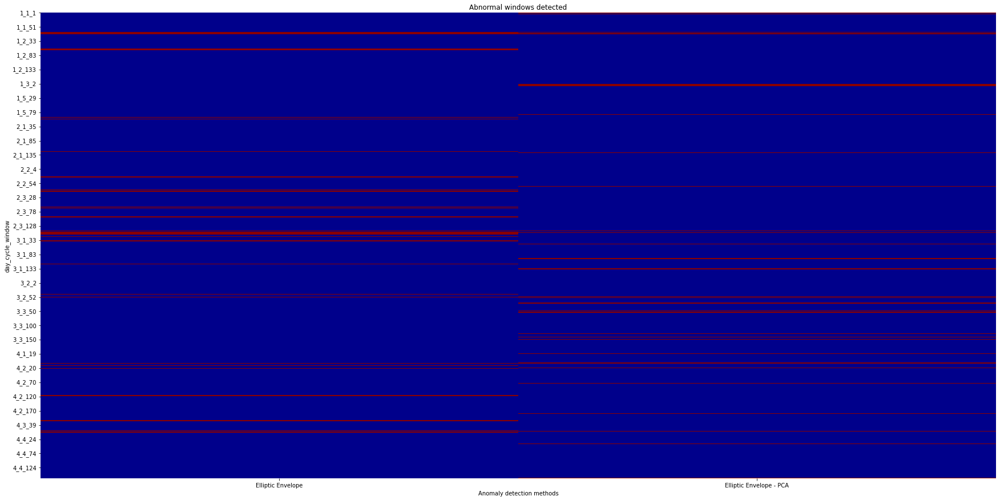

In [37]:
clf_name = 'Elliptic Envelope'
clf = EllipticEnvelope(contamination=0.05,random_state=42)
is_anomaly_elliptic, is_anomaly_elliptic_pca = pca_comparaison(clf_name,clf,df_means,parameters,df_pca,pca_components_kept)

DETECTING ANOMALIES WITHOUT PCA...



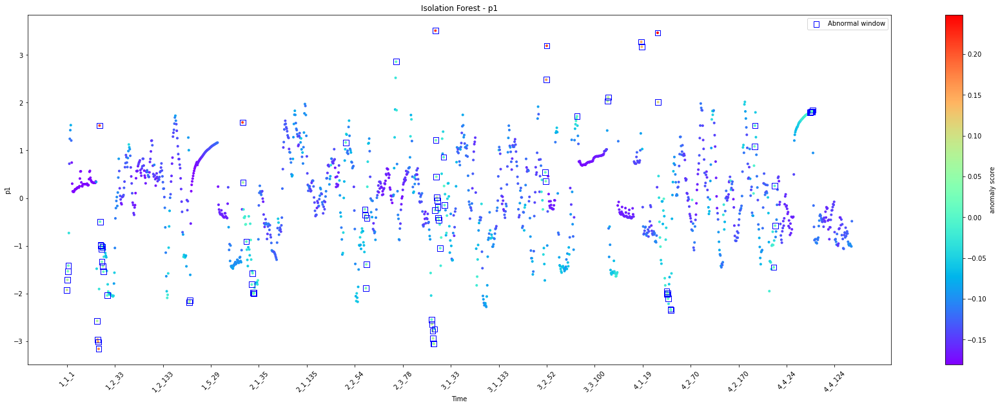

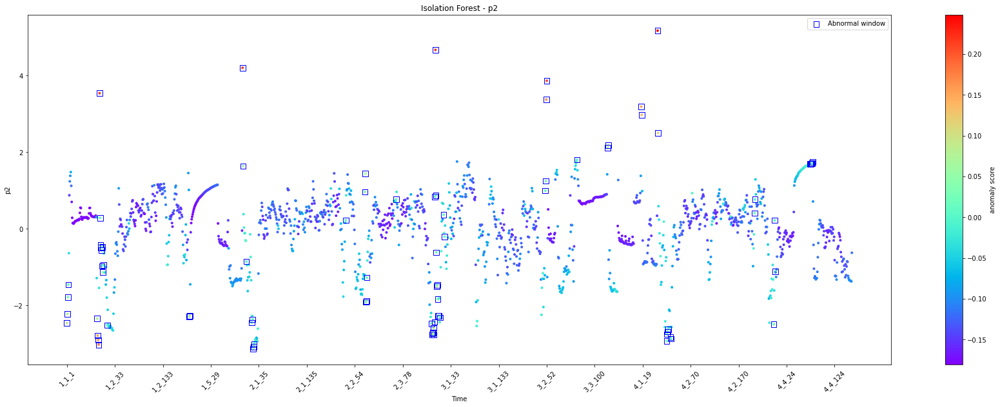

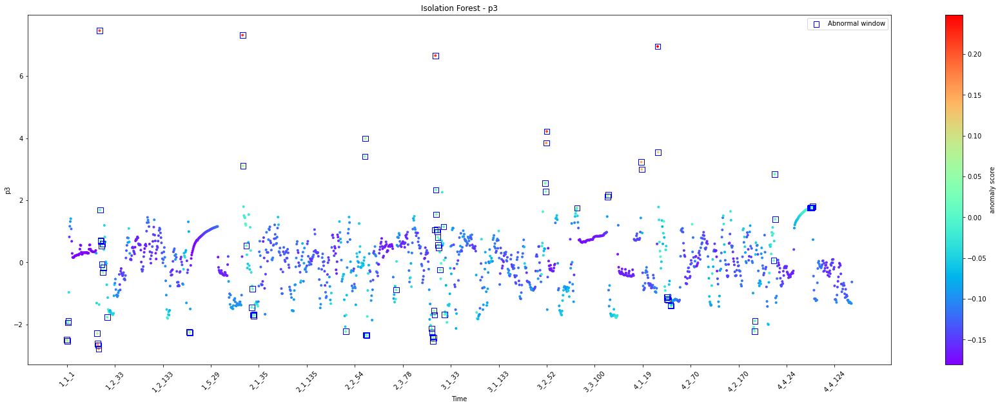

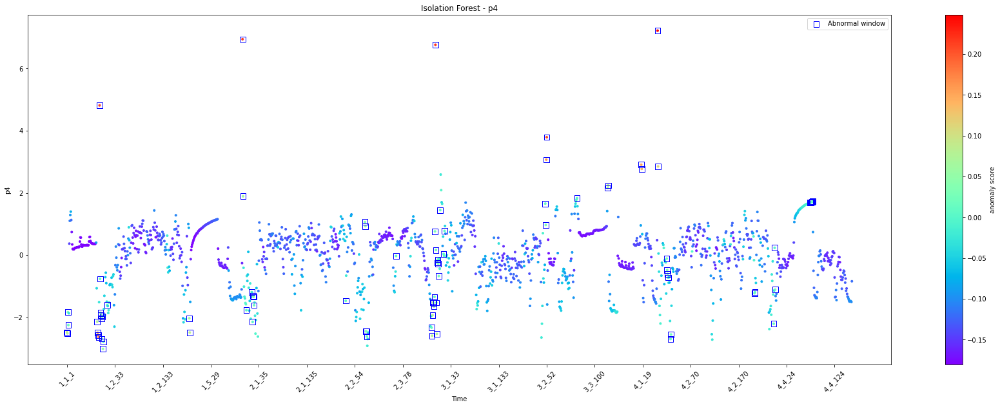

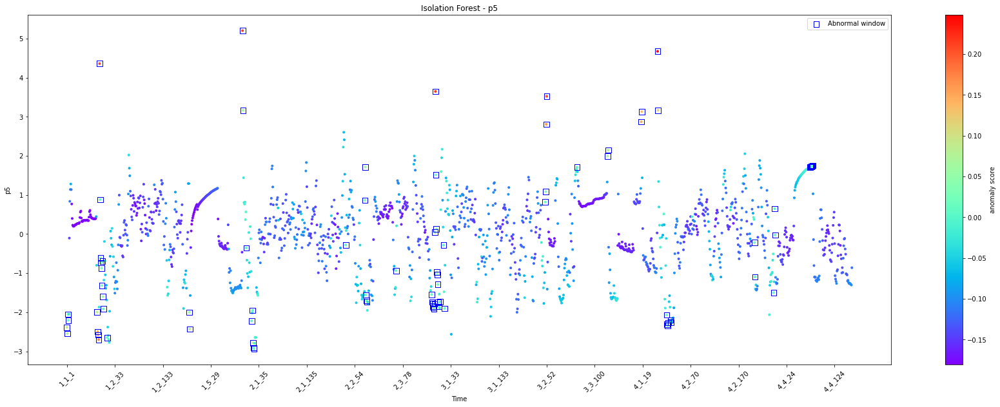

...

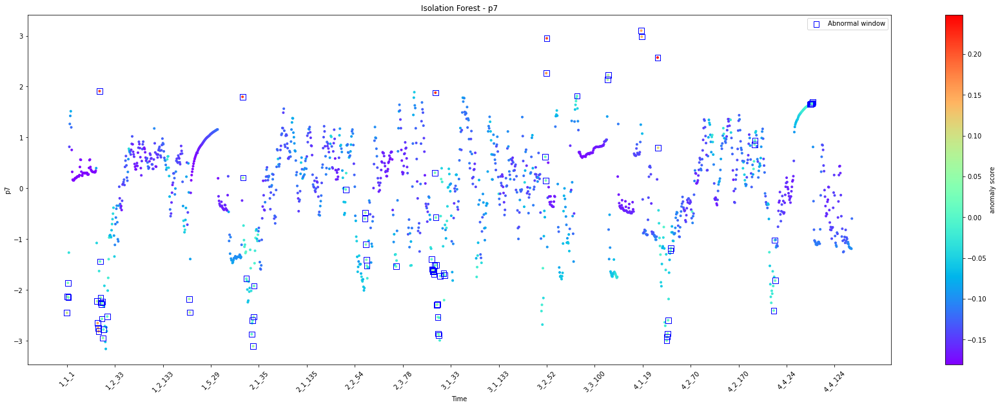

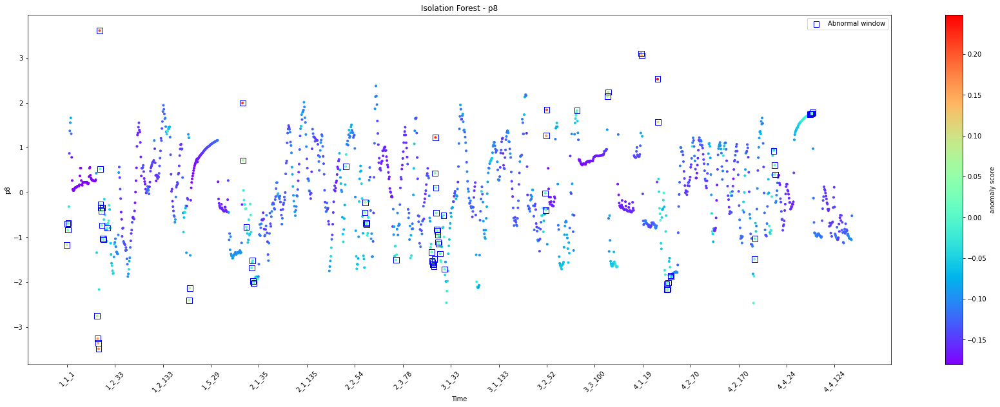

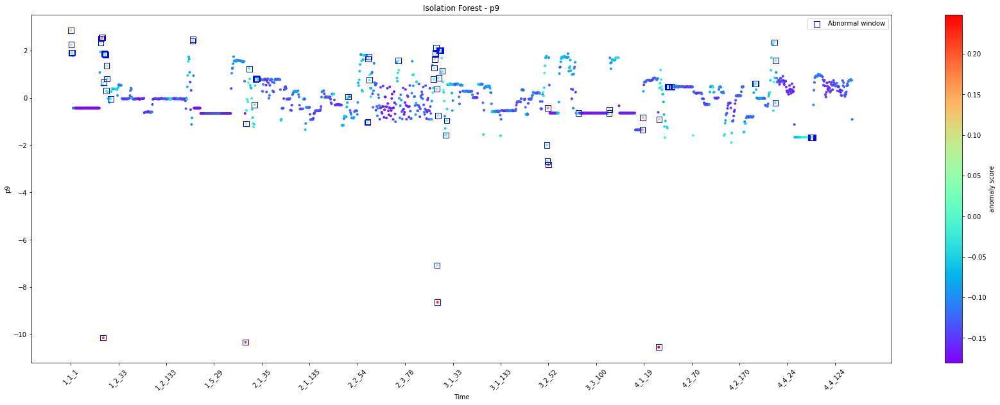

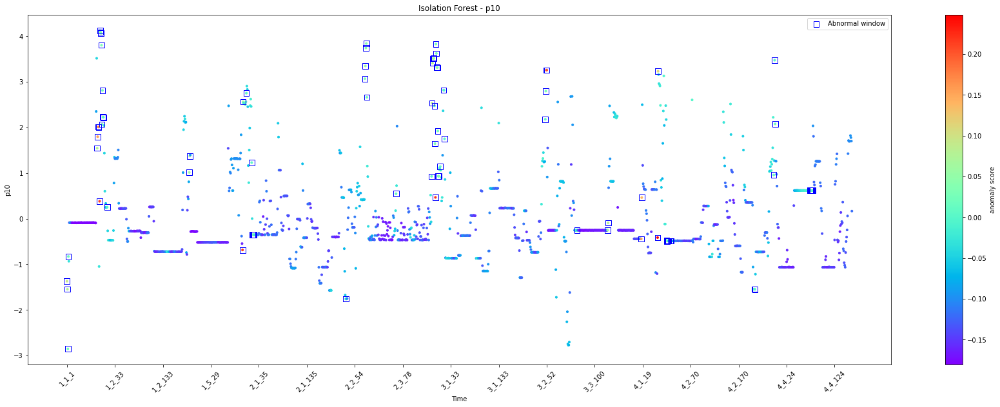

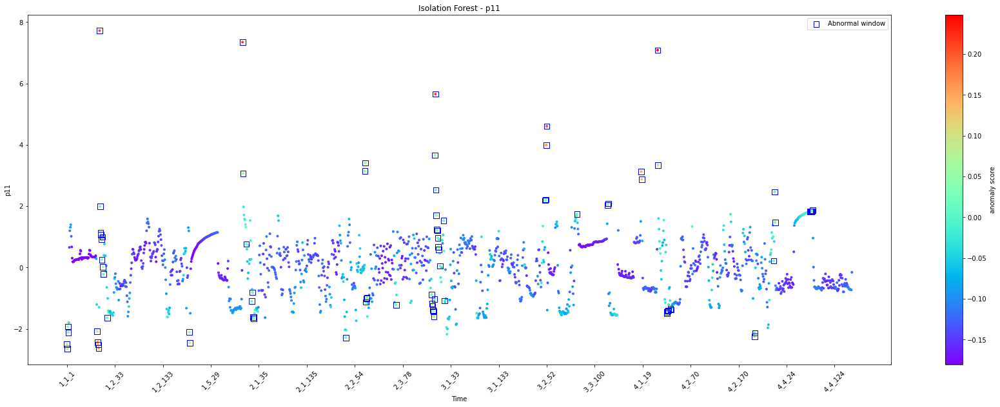

Detected abnormal windows: 82 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_4' '1_1_64' '1_1_65' '1_1_66' '1_1_67'
 '1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_6' '1_2_7' '1_2_8' '1_2_9'
 '1_2_17' '1_4_1' '1_4_2' '2_1_1' '2_1_2' '2_1_9' '2_1_20' '2_1_22'
 '2_1_23' '2_1_24' '2_1_25' '2_2_35' '2_2_75' '2_2_76' '2_3_1' '2_3_2'
 '2_3_3' '2_3_64' '2_3_138' '2_3_139' '2_3_140' '2_3_141' '2_3_142'
 '2_3_143' '2_3_144' '2_3_145' '3_1_1' '3_1_2' '3_1_3' '3_1_4' '3_1_5'
 '3_1_6' '3_1_7' '3_1_8' '3_1_11' '3_1_18' '3_1_20' '3_2_49' '3_2_50'
 '3_2_51' '3_2_52' '3_3_63' '3_3_127' '3_3_128' '4_1_16' '4_1_17' '4_2_1'
 '4_2_2' '4_2_20' '4_2_21' '4_2_22' '4_2_23' '4_2_28' '4_2_29' '4_3_22'
 '4_3_23' '4_3_62' '4_3_64' '4_3_65' '4_4_73' '4_4_74' '4_4_75' '4_4_76'
 '4_4_77' '4_4_78']


DETECTING ANOMALIES WITH PCA...



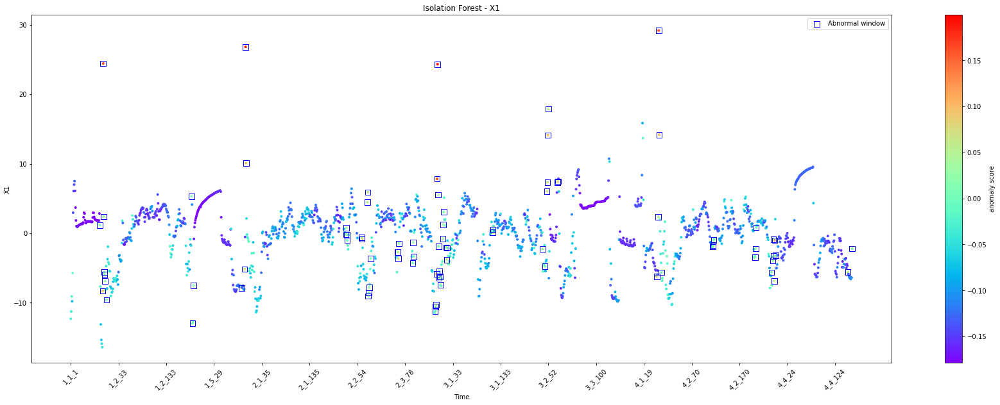

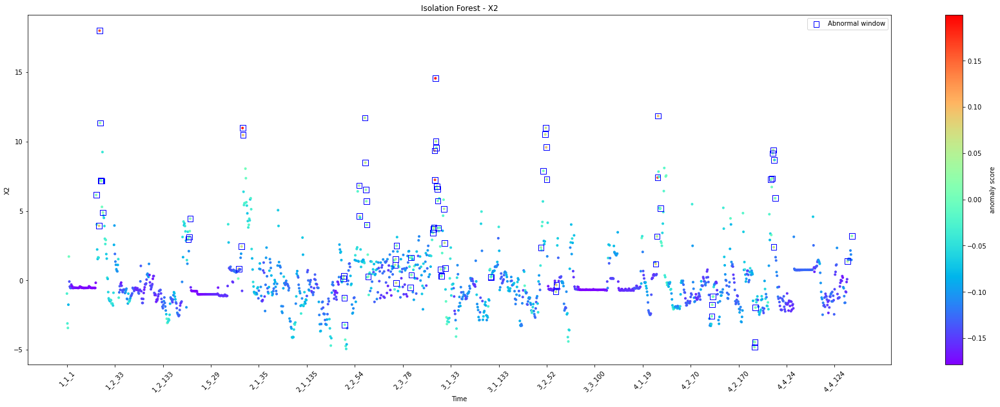

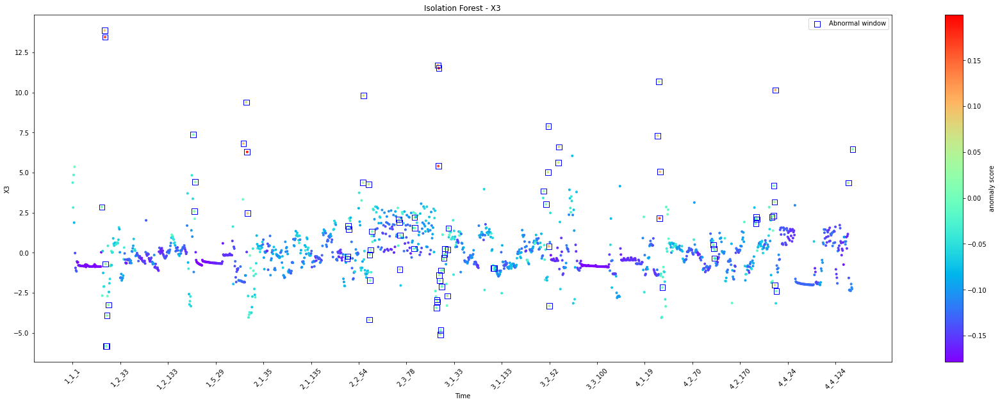

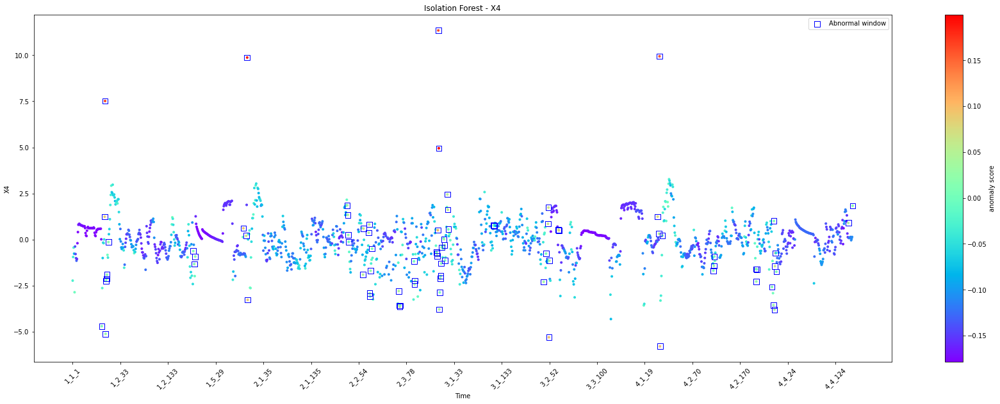

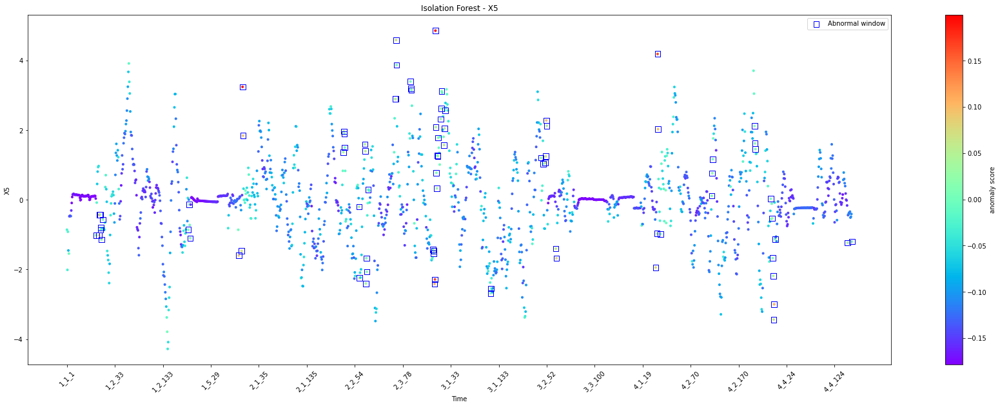

...

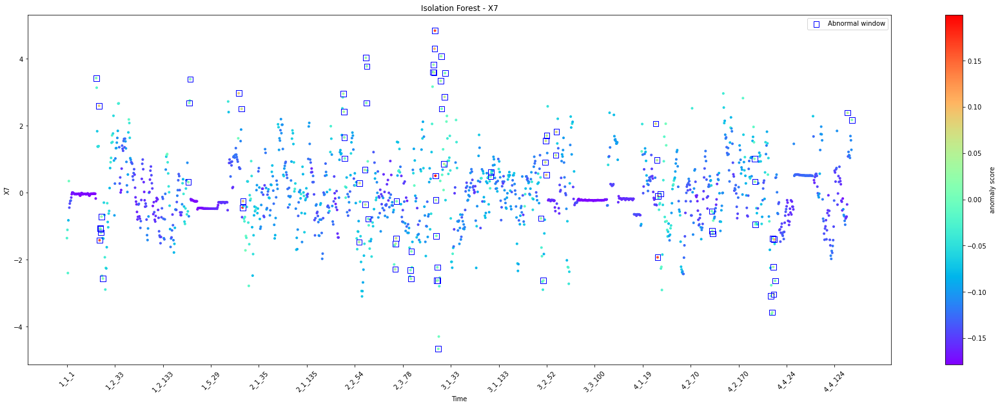

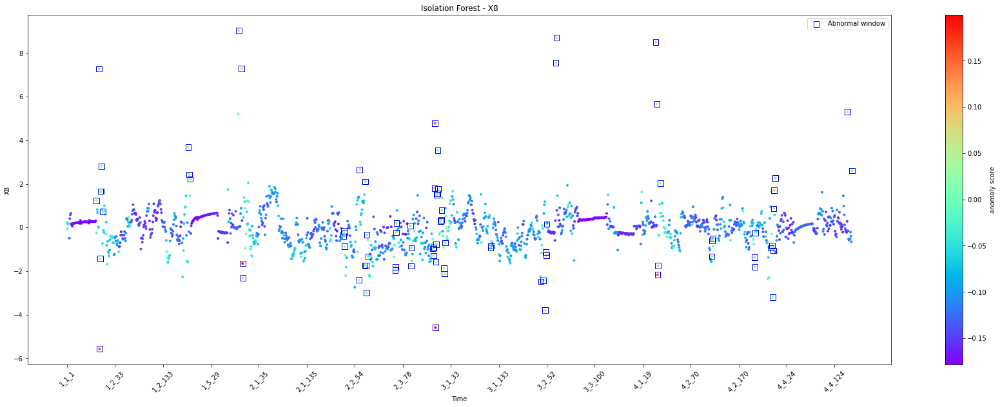

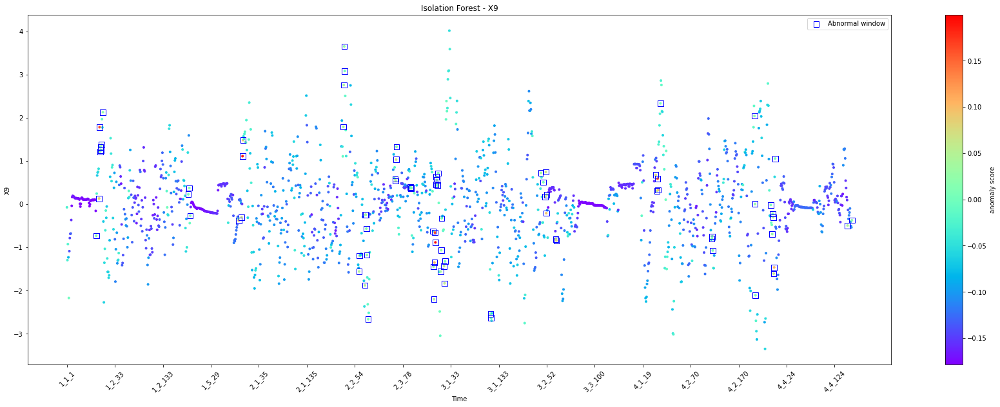

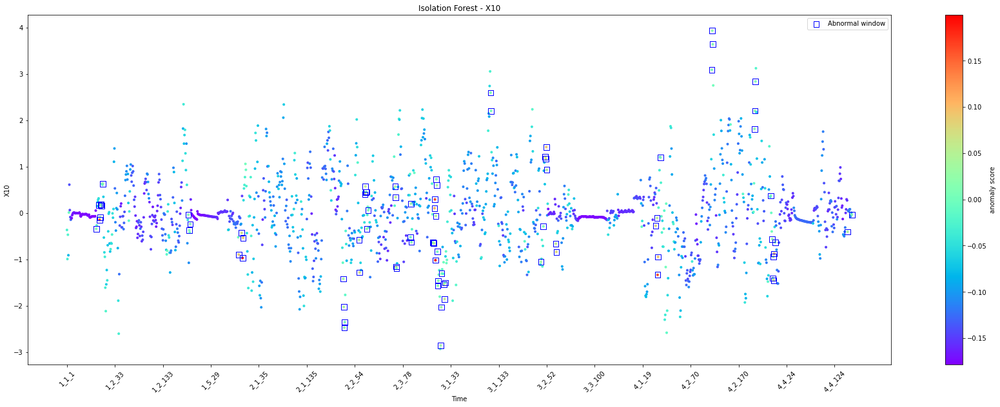

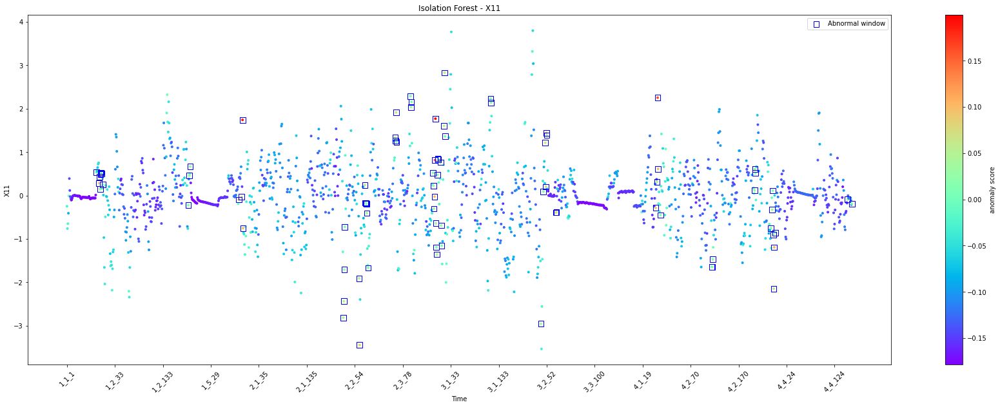

Detected abnormal windows: 82 / 1636

['1_1_62' '1_1_68' '1_2_1' '1_2_2' '1_2_3' '1_2_4' '1_2_5' '1_2_8' '1_3_5'
 '1_4_1' '1_4_3' '1_5_87' '1_5_93' '2_1_1' '2_1_2' '2_2_30' '2_2_31'
 '2_2_32' '2_2_33' '2_2_63' '2_2_64' '2_2_75' '2_2_76' '2_3_1' '2_3_2'
 '2_3_3' '2_3_6' '2_3_62' '2_3_63' '2_3_64' '2_3_65' '2_3_94' '2_3_95'
 '2_3_96' '2_3_141' '2_3_142' '2_3_143' '2_3_144' '2_3_145' '3_1_1'
 '3_1_2' '3_1_3' '3_1_4' '3_1_5' '3_1_6' '3_1_7' '3_1_12' '3_1_13'
 '3_1_14' '3_1_19' '3_1_20' '3_1_21' '3_1_116' '3_1_117' '3_2_40' '3_2_45'
 '3_2_49' '3_2_50' '3_2_51' '3_2_52' '3_3_19' '3_3_20' '4_1_46' '4_1_49'
 '4_2_1' '4_2_2' '4_2_7' '4_2_114' '4_2_115' '4_2_116' '4_3_22' '4_3_23'
 '4_3_24' '4_3_56' '4_3_59' '4_3_60' '4_3_61' '4_3_62' '4_3_63' '4_3_65'
 '4_4_151' '4_4_160']


COMPARING THE METHODS...



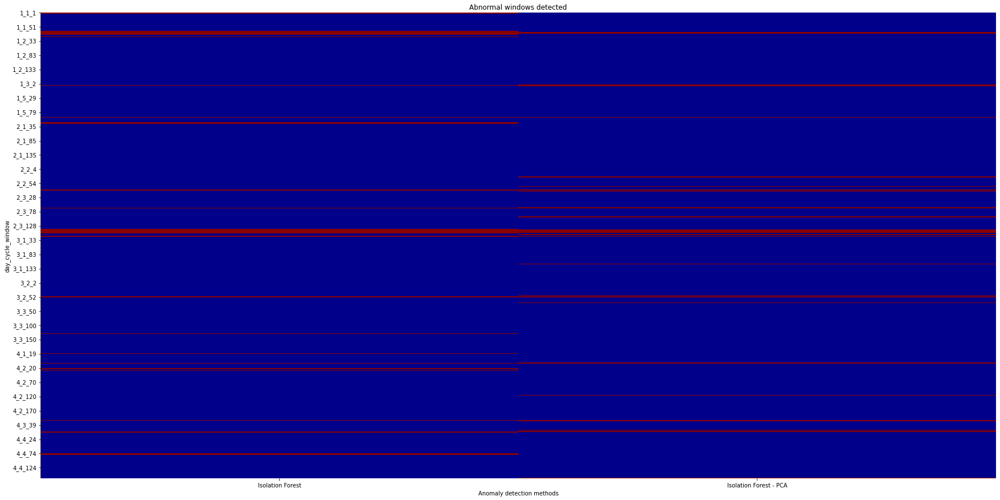

In [38]:
clf_name = 'Isolation Forest'
clf = IsolationForest(n_estimators=100, contamination=0.05,random_state=42)
is_anomaly_isoforest, is_anomaly_isoforest_pca = pca_comparaison(clf_name,clf,df_means,parameters,df_pca,pca_components_kept)

DETECTING ANOMALIES WITHOUT PCA...



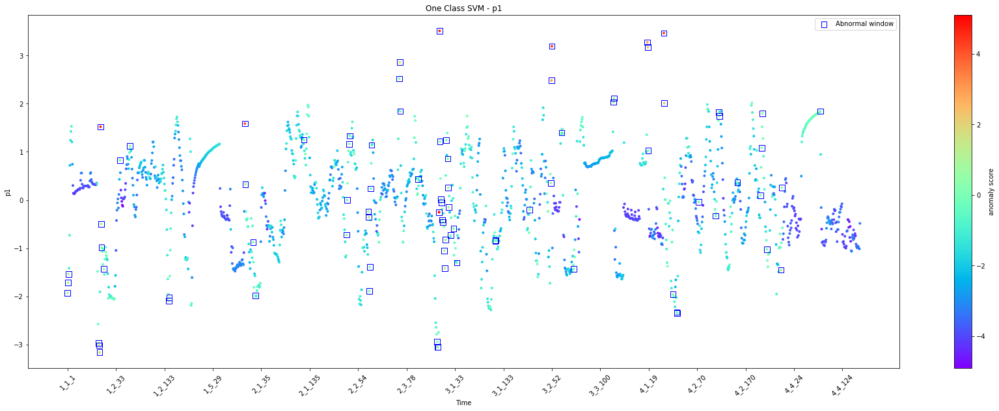

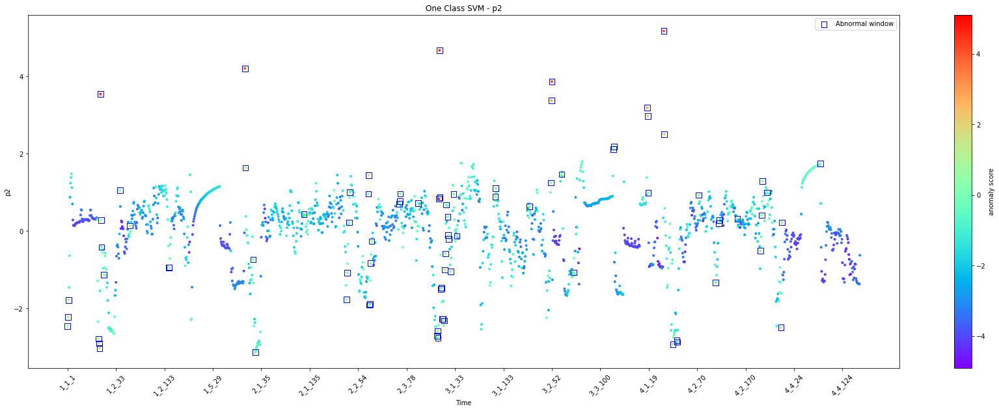

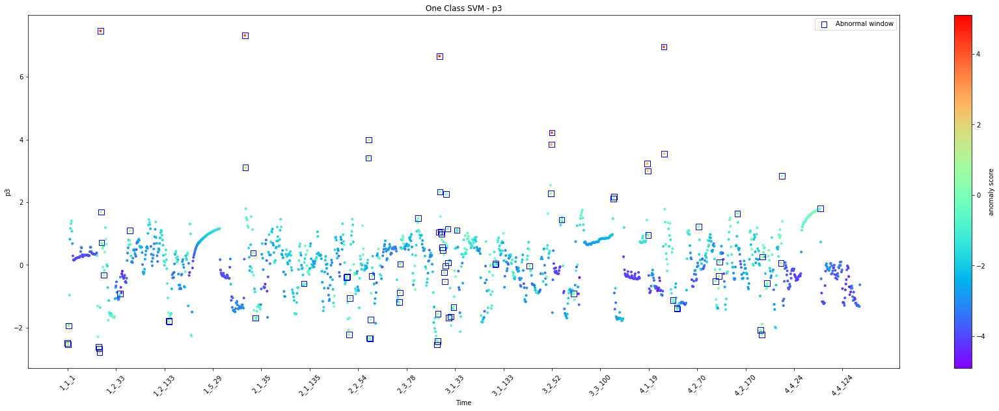

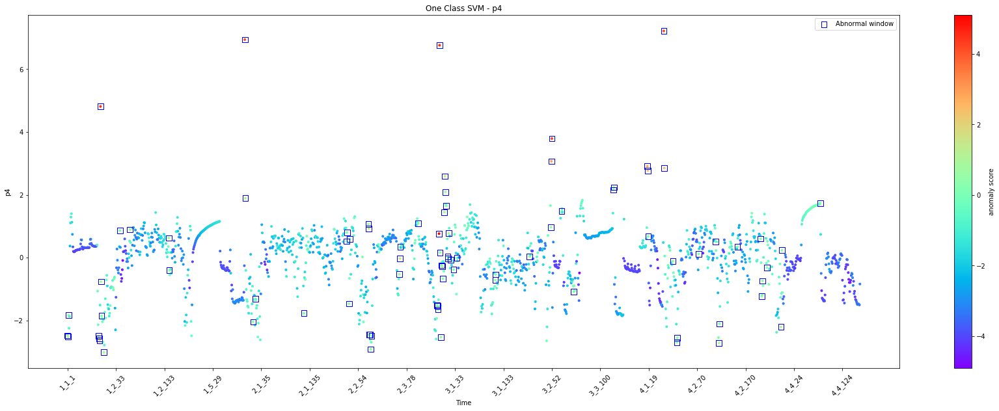

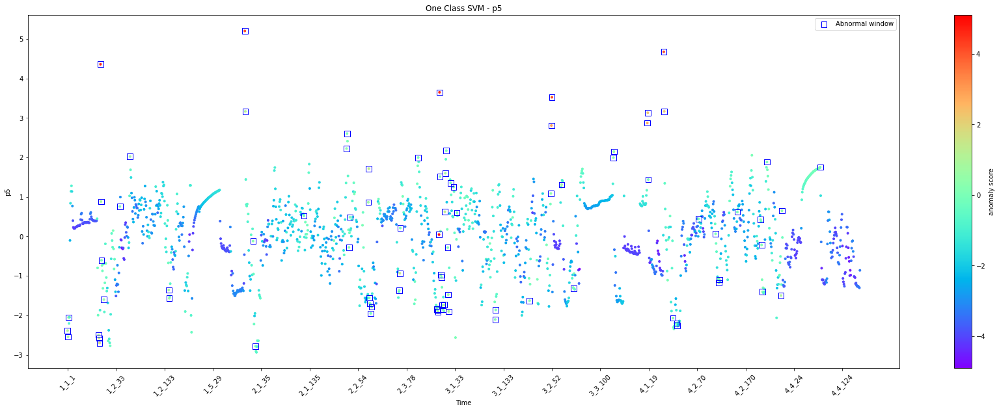

...

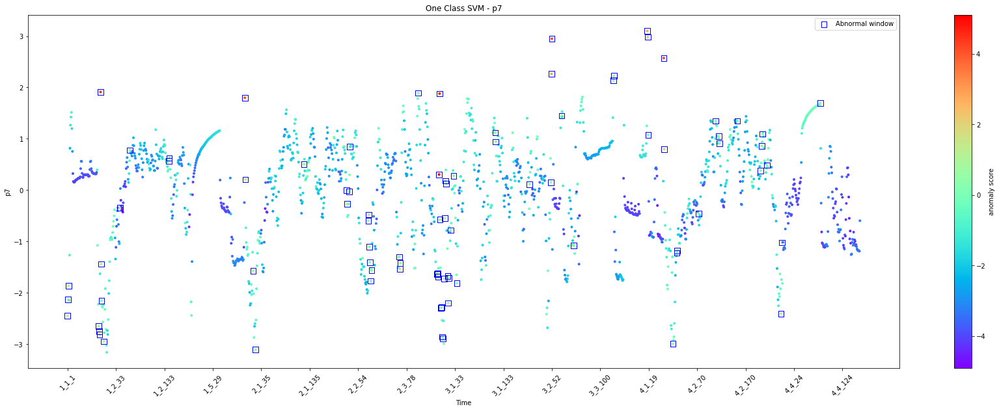

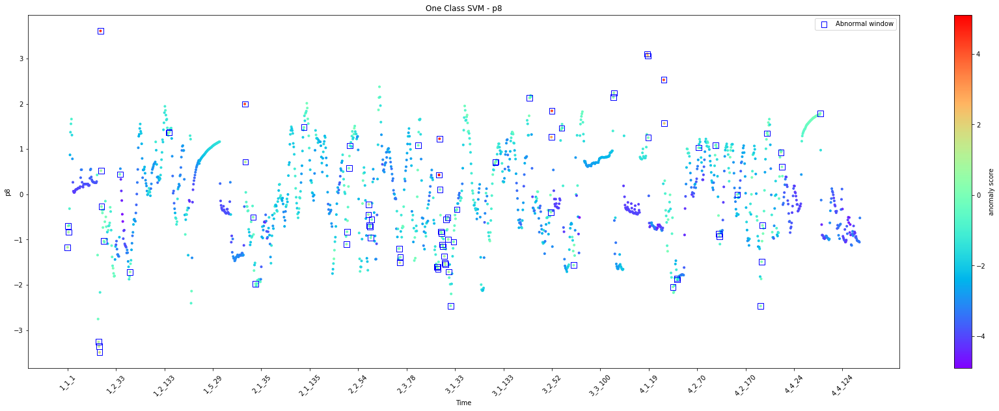

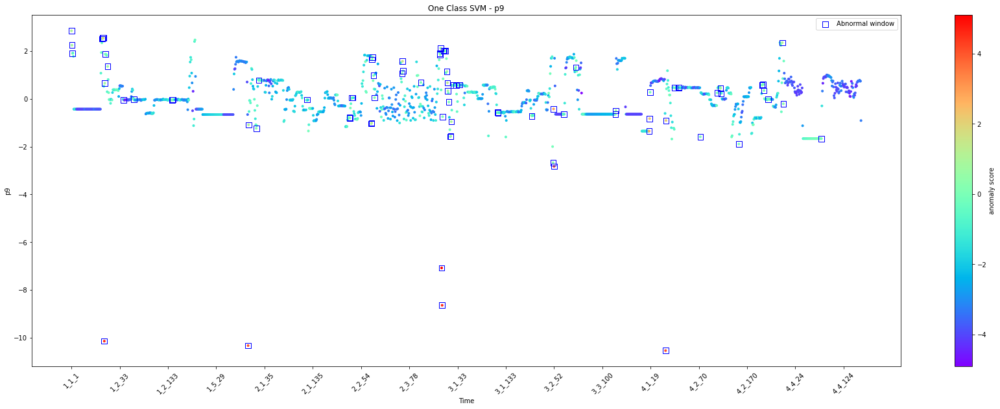

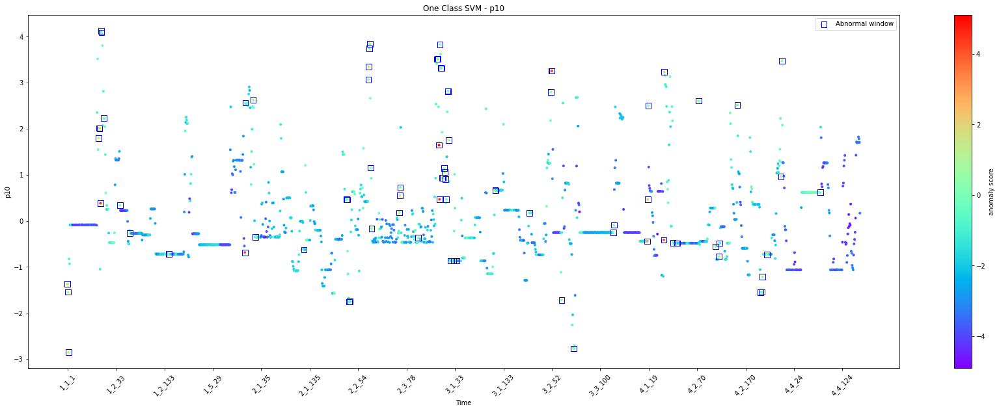

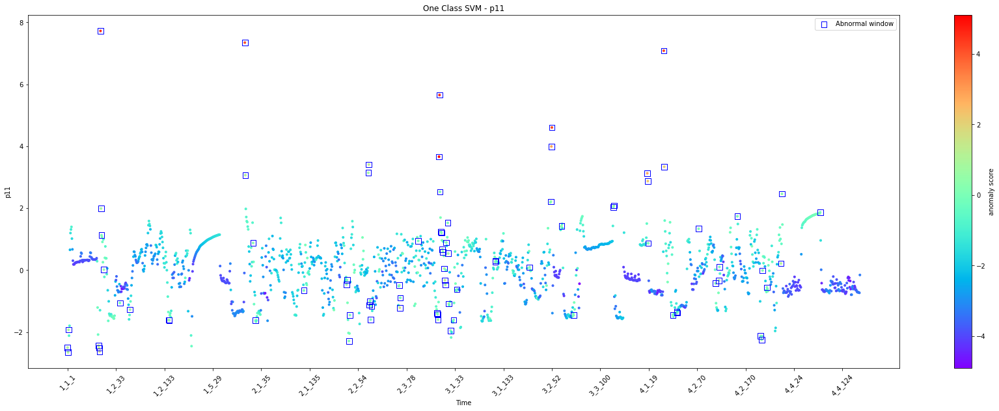

Detected abnormal windows: 83 / 1636

['1_1_1' '1_1_2' '1_1_3' '1_1_65' '1_1_66' '1_1_67' '1_2_1' '1_2_2'
 '1_2_3' '1_2_8' '1_2_41' '1_2_62' '1_2_142' '1_2_143' '2_1_1' '2_1_2'
 '2_1_18' '2_1_23' '2_1_123' '2_2_30' '2_2_31' '2_2_35' '2_2_37' '2_2_75'
 '2_2_76' '2_3_1' '2_3_2' '2_3_4' '2_3_6' '2_3_63' '2_3_64' '2_3_65'
 '2_3_102' '2_3_141' '2_3_142' '2_3_143' '2_3_145' '3_1_1' '3_1_2' '3_1_4'
 '3_1_5' '3_1_7' '3_1_8' '3_1_11' '3_1_12' '3_1_13' '3_1_15' '3_1_18'
 '3_1_19' '3_1_20' '3_1_24' '3_1_30' '3_1_37' '3_1_116' '3_1_117' '3_2_6'
 '3_2_50' '3_2_51' '3_2_52' '3_3_20' '3_3_45' '3_3_127' '3_3_128' '4_1_16'
 '4_1_17' '4_1_18' '4_2_1' '4_2_2' '4_2_20' '4_2_28' '4_2_29' '4_2_73'
 '4_2_108' '4_2_115' '4_2_116' '4_2_153' '4_3_20' '4_3_22' '4_3_24'
 '4_3_33' '4_3_62' '4_3_64' '4_4_78']


DETECTING ANOMALIES WITH PCA...



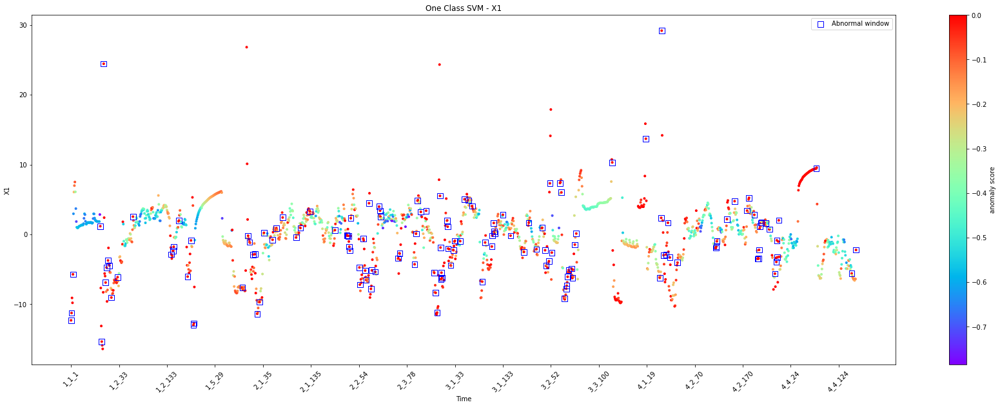

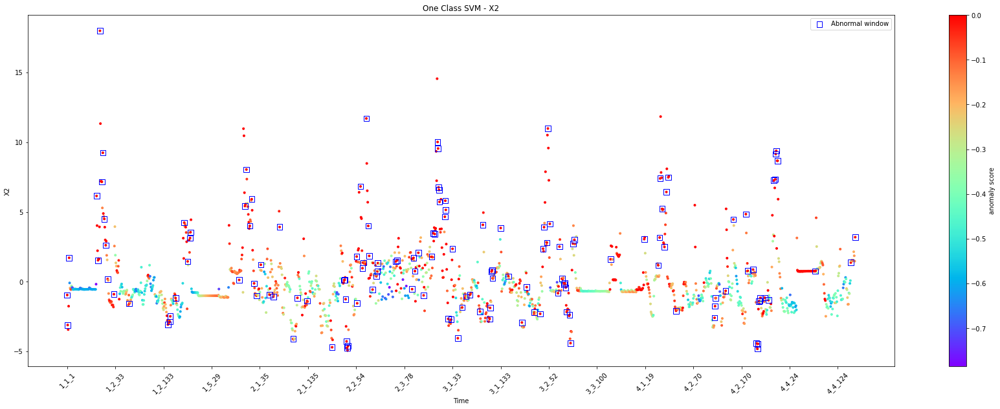

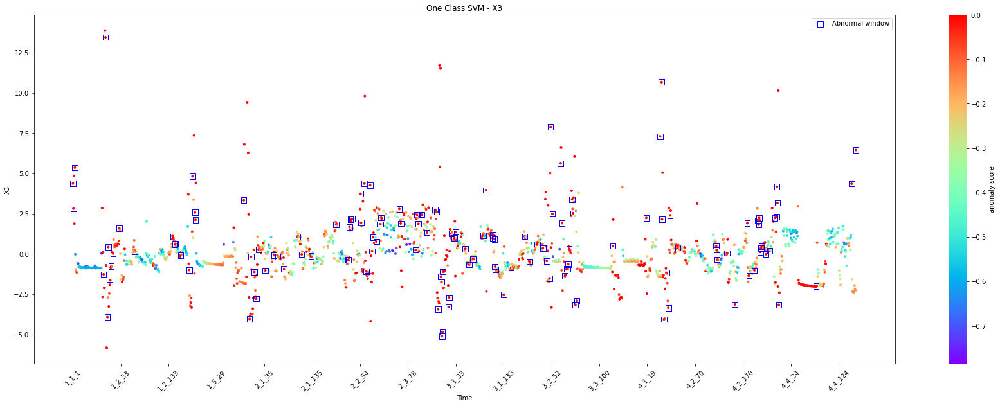

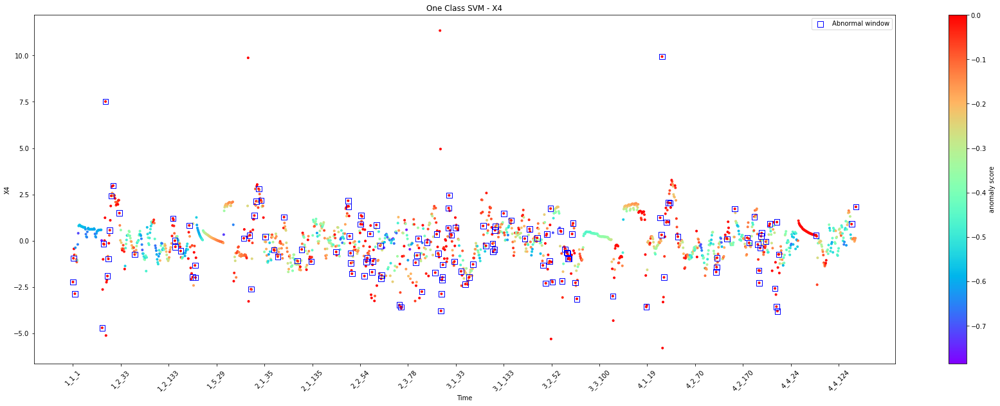

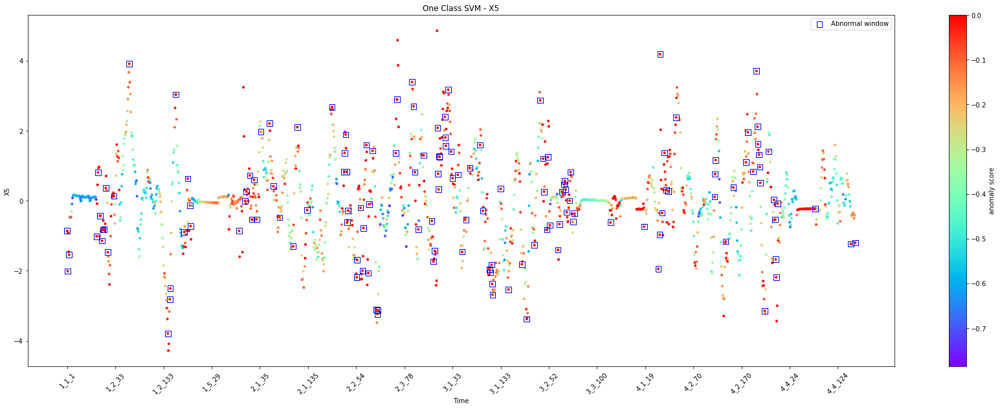

...

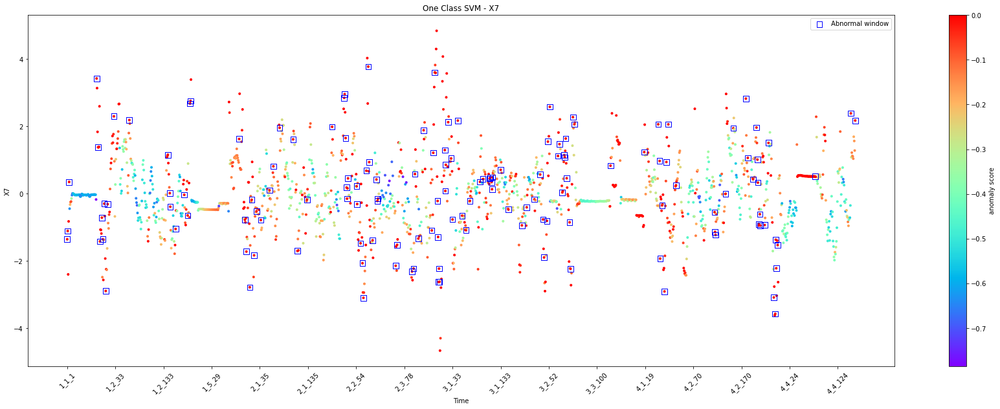

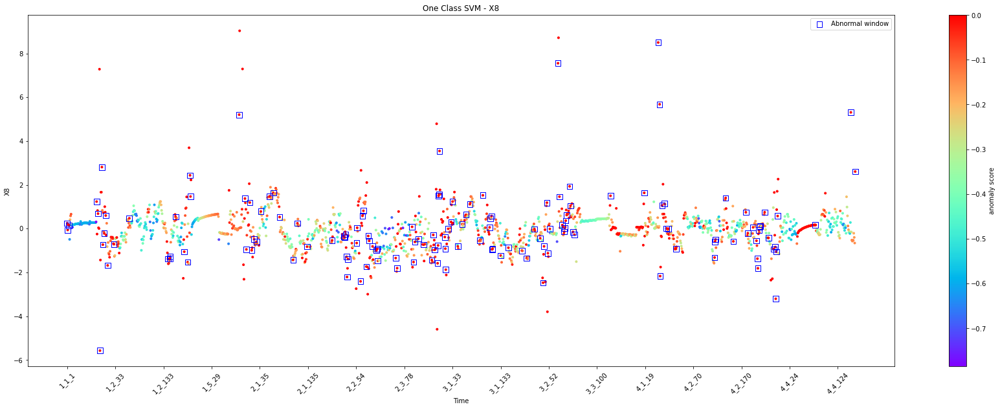

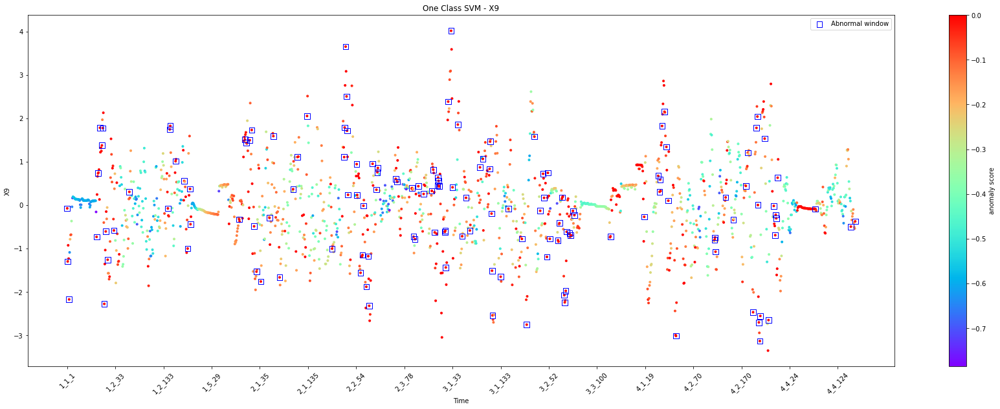

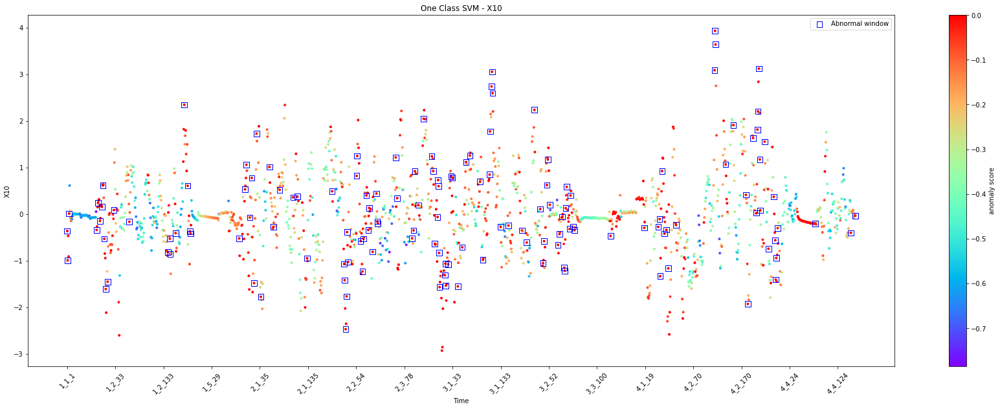

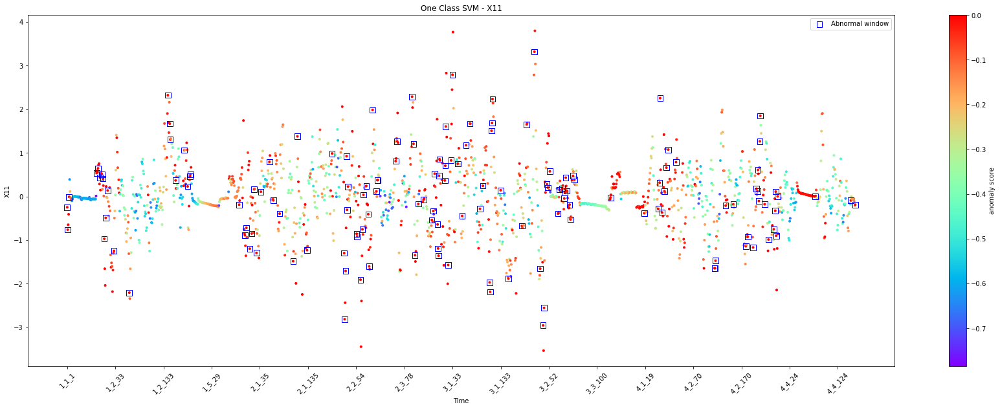

Detected abnormal windows: 142 / 1636

['1_1_1' '1_1_2' '1_1_5' '1_1_62' '1_1_65' '1_2_1' '1_2_5' '1_2_7'
 '1_2_10' '1_2_13' '1_2_17' '1_2_30' '1_2_62' '1_2_142' '1_2_146'
 '1_2_147' '1_2_158' '1_2_176' '1_3_2' '1_4_1' '1_4_2' '1_5_86' '2_1_4'
 '2_1_7' '2_1_14' '2_1_18' '2_1_23' '2_1_28' '2_1_37' '2_1_55' '2_1_63'
 '2_1_76' '2_1_104' '2_1_113' '2_1_133' '2_2_4' '2_2_29' '2_2_30' '2_2_32'
 '2_2_34' '2_2_35' '2_2_37' '2_2_55' '2_2_56' '2_2_63' '2_2_67' '2_2_69'
 '2_2_75' '2_3_3' '2_3_5' '2_3_12' '2_3_20' '2_3_22' '2_3_23' '2_3_60'
 '2_3_63' '2_3_94' '2_3_97' '2_3_100' '2_3_107' '2_3_118' '2_3_135'
 '2_3_138' '2_3_141' '3_1_2' '3_1_3' '3_1_4' '3_1_5' '3_1_6' '3_1_17'
 '3_1_18' '3_1_19' '3_1_24' '3_1_30' '3_1_33' '3_1_44' '3_1_53' '3_1_61'
 '3_1_69' '3_1_90' '3_1_96' '3_1_110' '3_1_111' '3_1_114' '3_1_115'
 '3_1_116' '3_1_133' '3_1_149' '3_1_177' '3_2_6' '3_2_22' '3_2_34'
 '3_2_40' '3_2_42' '3_2_48' '3_2_50' '3_3_2' '3_3_19' '3_3_22' '3_3_28'
 '3_3_32' '3_3_33' '3_3_35' '3_3_37' '3_3_43' '

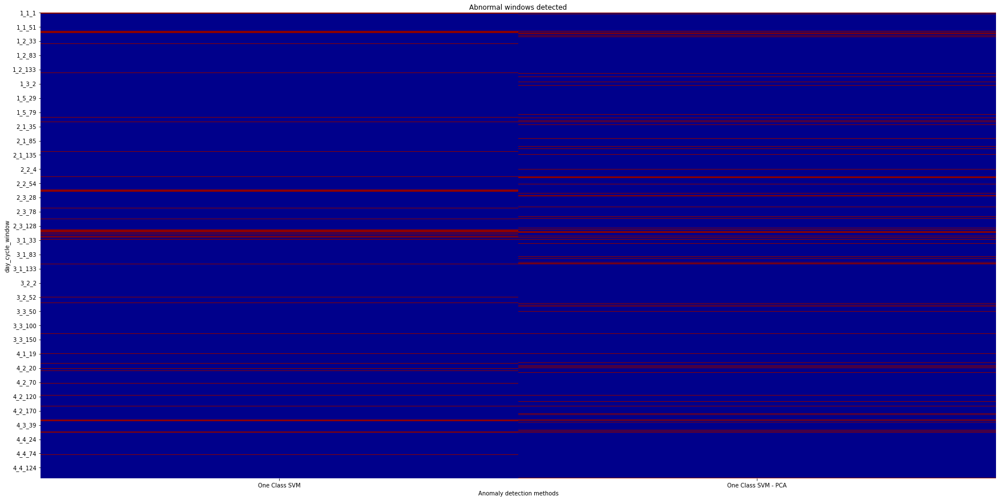

In [39]:
clf_name = 'One Class SVM'
clf = OneClassSVM(nu=0.05, kernel="rbf", gamma='auto')
is_anomaly_oneclasssvm, is_anomaly_oneclasssvm_pca = pca_comparaison(clf_name,clf,df_means,parameters,df_pca,pca_components_kept)

DETECTING ANOMALIES WITHOUT PCA...



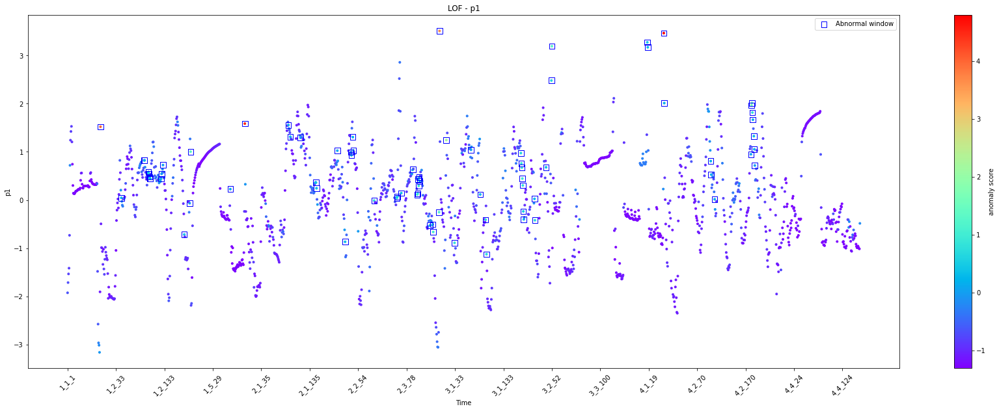

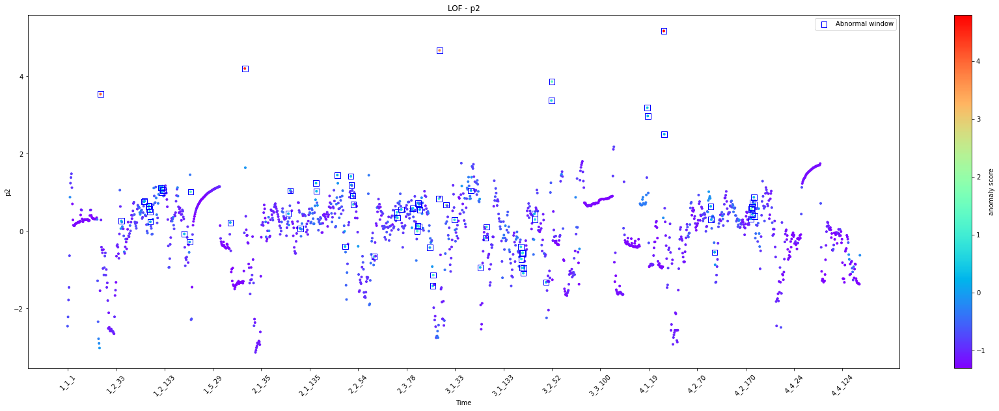

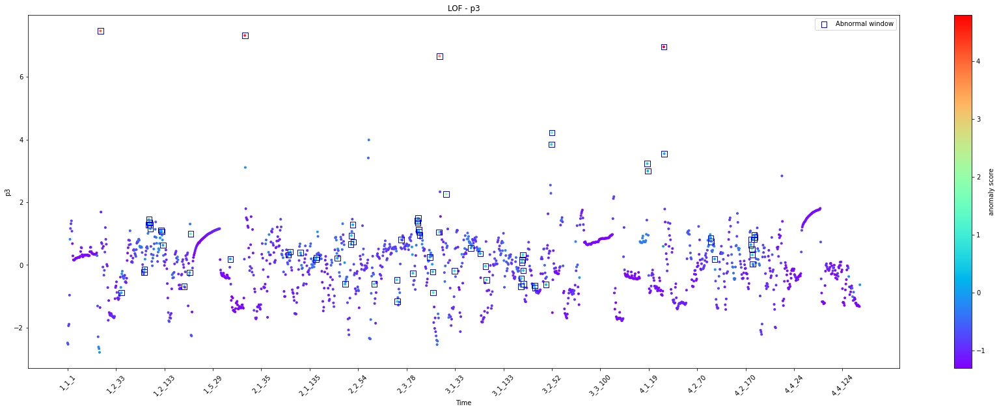

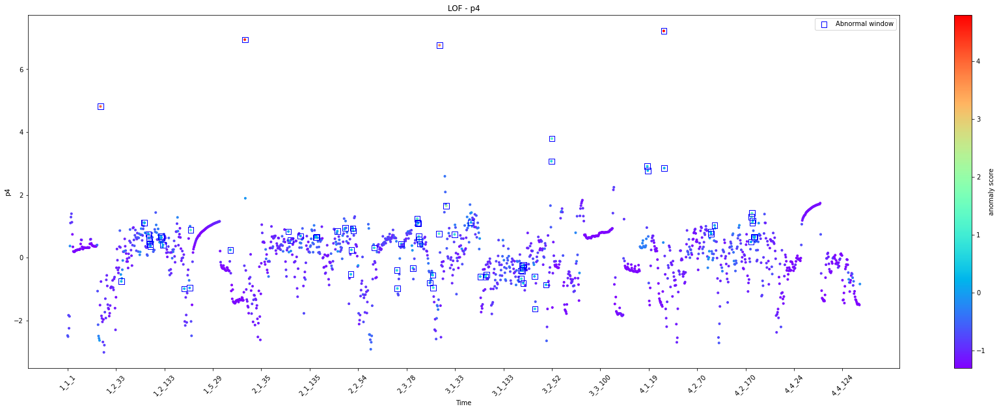

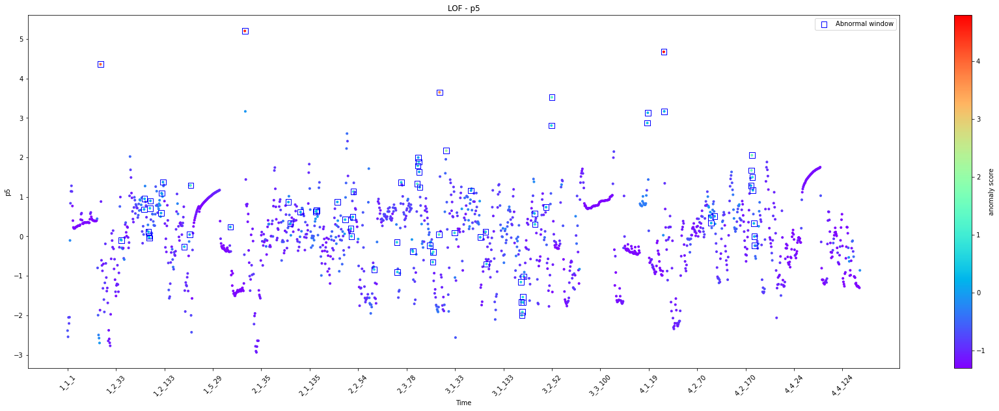

...

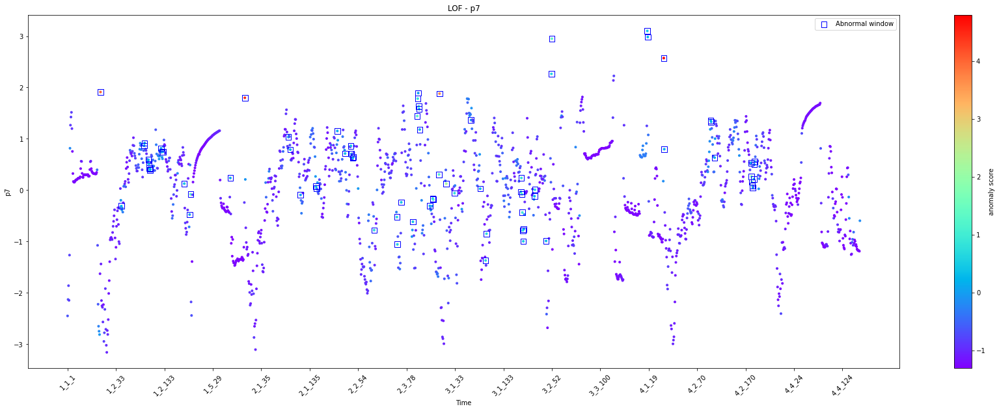

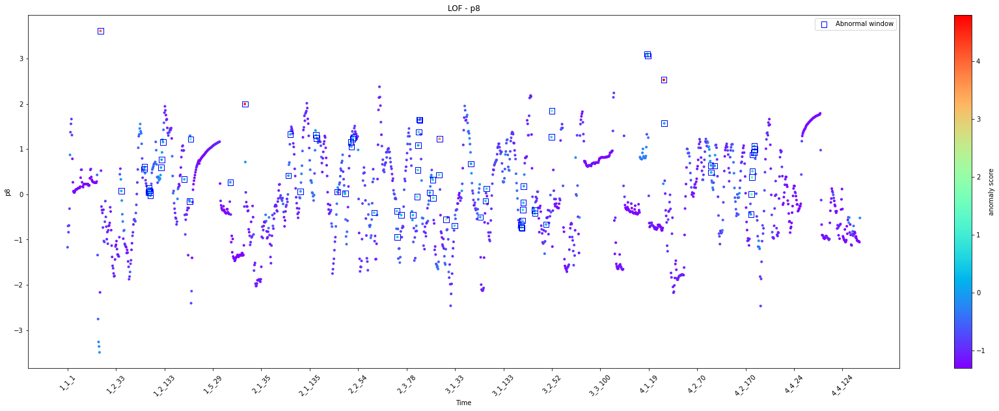

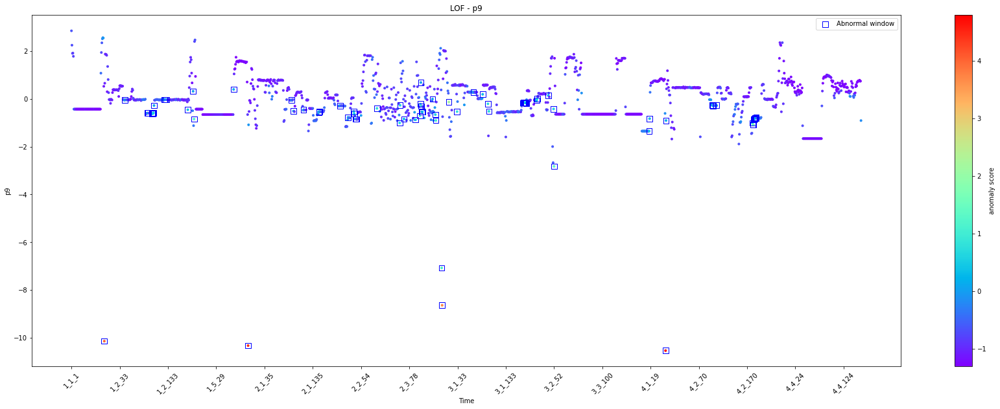

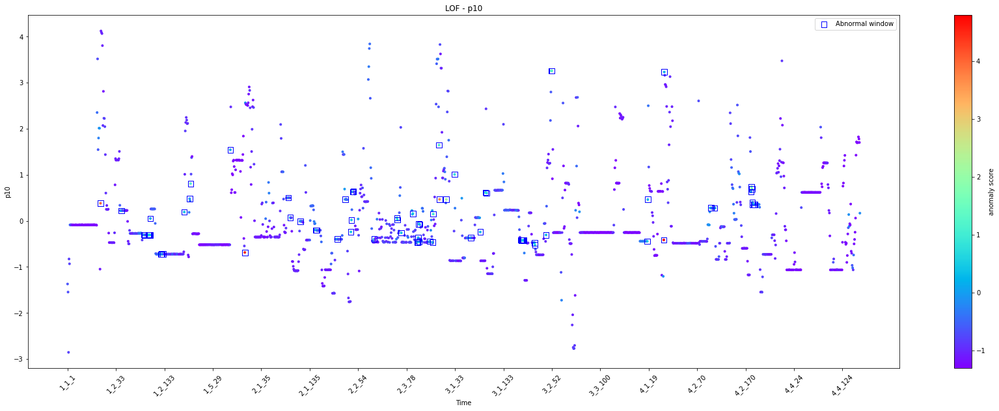

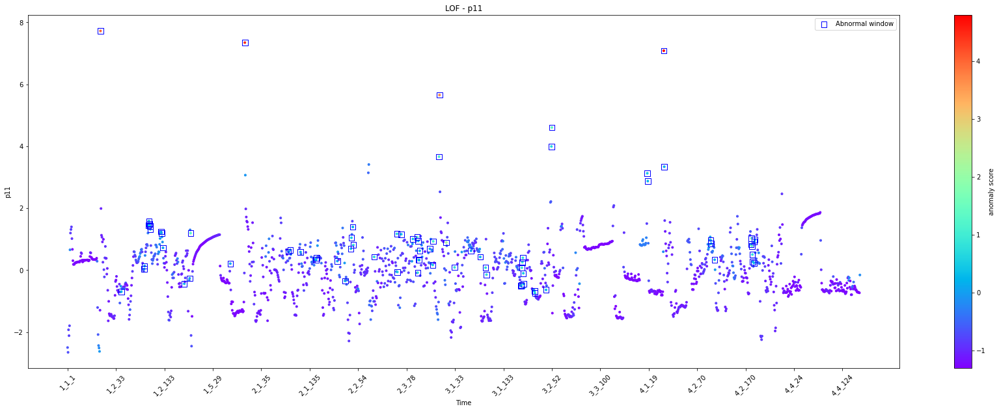

Detected abnormal windows: 77 / 1636

['1_2_1' '1_2_44' '1_2_91' '1_2_92' '1_2_100' '1_2_101' '1_2_102'
 '1_2_103' '1_2_104' '1_2_126' '1_2_127' '1_2_130' '1_2_174' '1_3_4'
 '1_3_6' '1_5_65' '2_1_1' '2_1_91' '2_1_95' '2_1_116' '2_1_148' '2_1_149'
 '2_2_11' '2_2_27' '2_2_39' '2_2_40' '2_2_43' '2_2_44' '2_3_11' '2_3_58'
 '2_3_59' '2_3_67' '2_3_91' '2_3_100' '2_3_101' '2_3_102' '2_3_103'
 '2_3_104' '2_3_105' '2_3_126' '2_3_132' '2_3_133' '2_3_145' '3_1_1'
 '3_1_15' '3_1_32' '3_1_66' '3_1_85' '3_1_96' '3_1_98' '3_1_169' '3_1_170'
 '3_1_171' '3_1_172' '3_1_173' '3_1_174' '3_1_175' '3_2_16' '3_2_17'
 '3_2_40' '3_2_51' '3_2_52' '4_1_16' '4_1_17' '4_2_1' '4_2_2' '4_2_98'
 '4_2_99' '4_2_106' '4_2_181' '4_3_1' '4_3_2' '4_3_3' '4_3_4' '4_3_6'
 '4_3_7' '4_3_8']


DETECTING ANOMALIES WITH PCA...



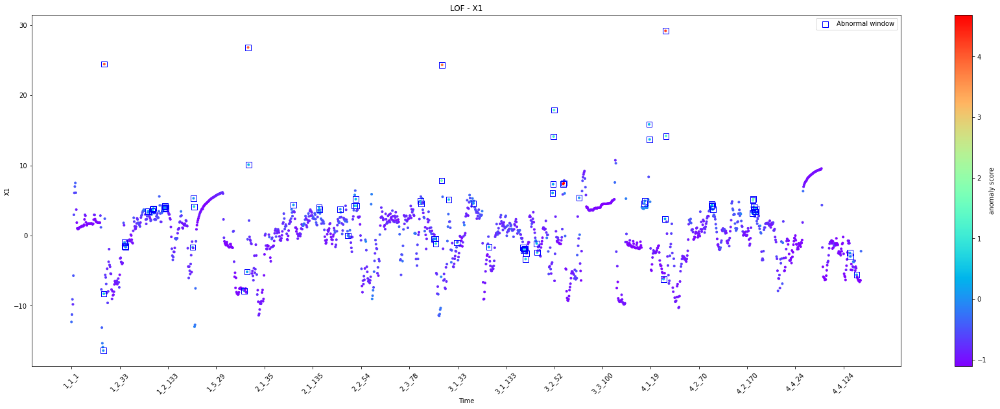

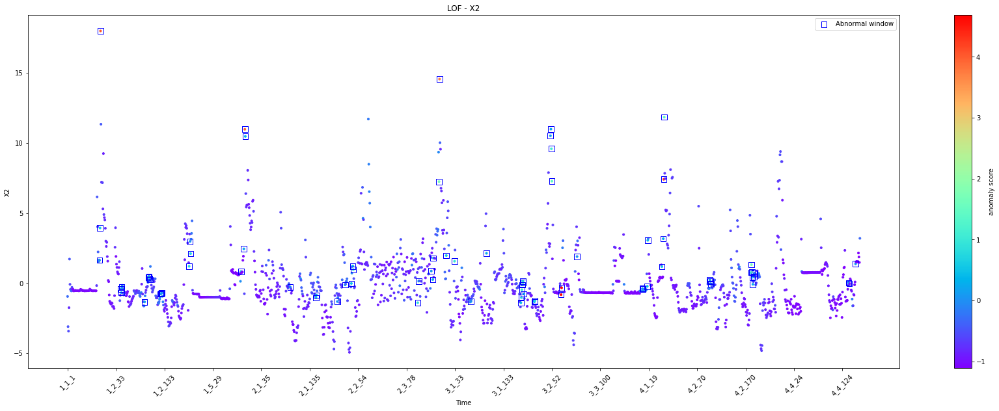

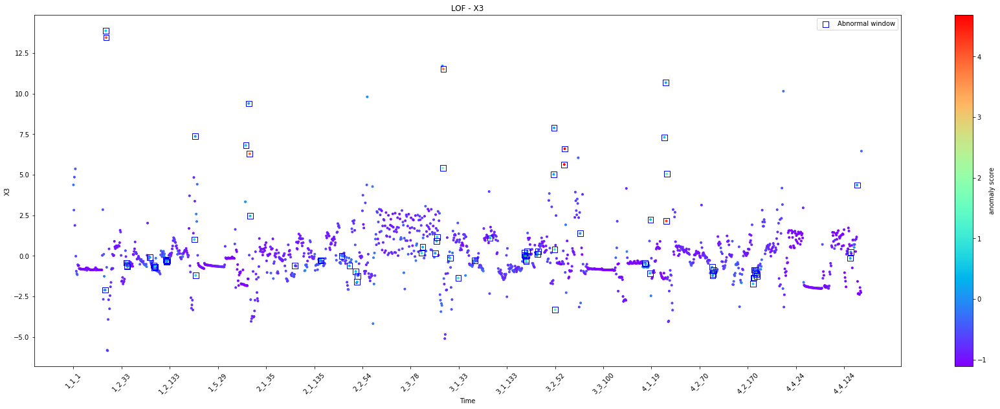

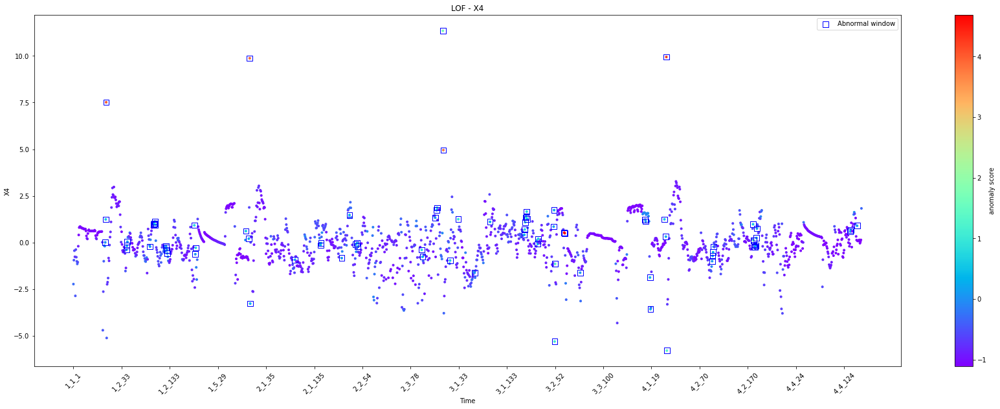

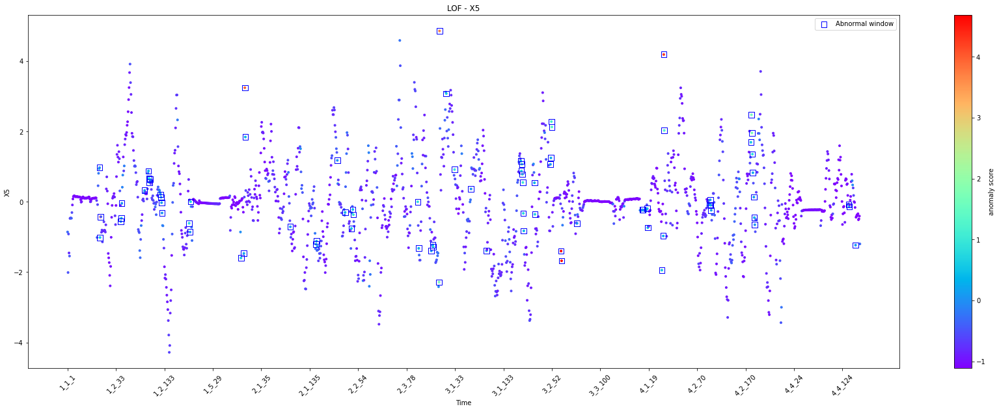

...

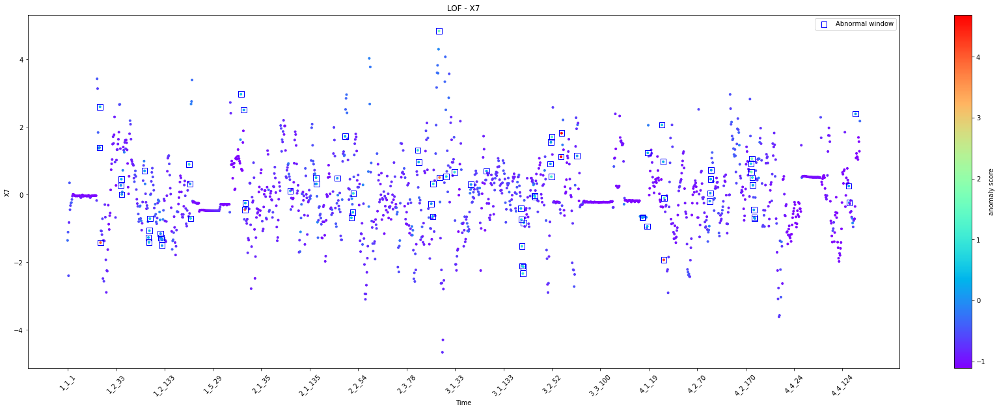

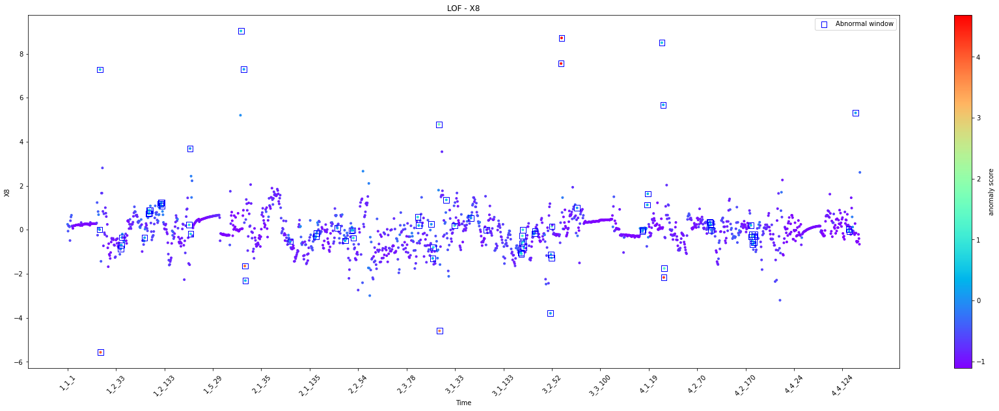

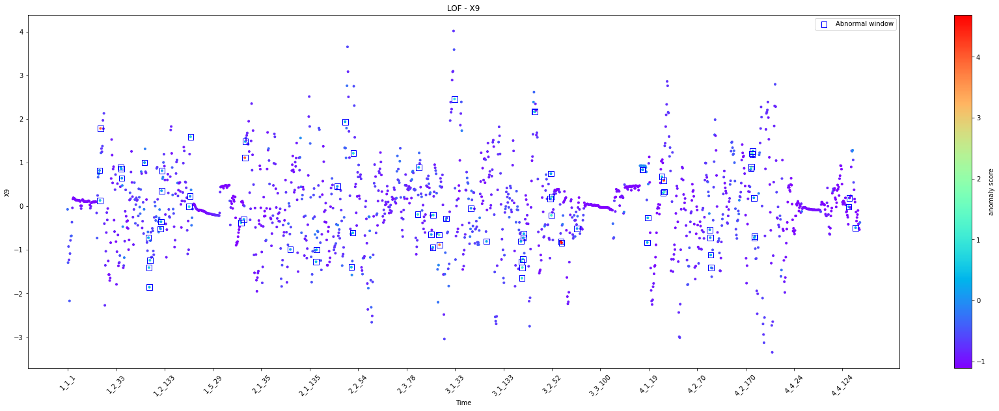

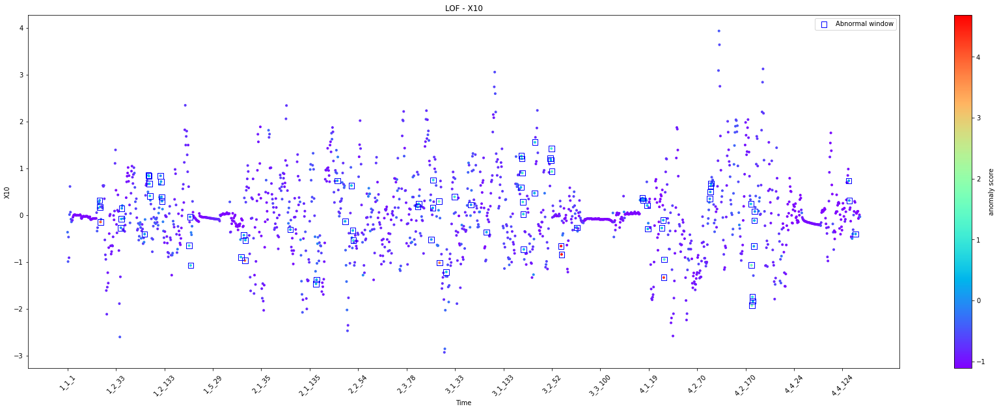

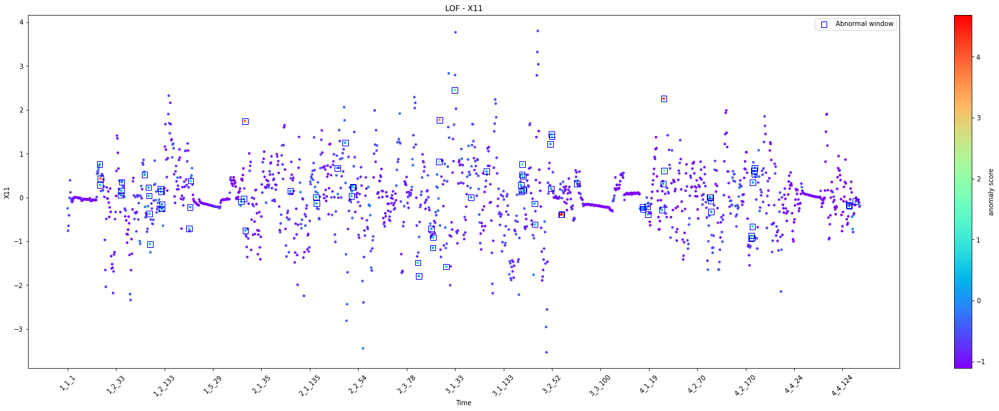

Detected abnormal windows: 80 / 1636

['1_1_67' '1_1_68' '1_2_1' '1_2_43' '1_2_44' '1_2_45' '1_2_92' '1_2_100'
 '1_2_101' '1_2_102' '1_2_103' '1_2_125' '1_2_126' '1_2_127' '1_2_128'
 '1_3_3' '1_3_5' '1_3_6' '1_5_87' '1_5_93' '2_1_1' '2_1_2' '2_1_95'
 '2_1_148' '2_1_149' '2_2_11' '2_2_27' '2_2_40' '2_2_43' '2_2_44'
 '2_3_101' '2_3_103' '2_3_129' '2_3_132' '2_3_133' '2_3_145' '3_1_1'
 '3_1_15' '3_1_32' '3_1_66' '3_1_98' '3_1_169' '3_1_170' '3_1_171'
 '3_1_172' '3_1_173' '3_1_174' '3_1_175' '3_2_16' '3_2_17' '3_2_49'
 '3_2_50' '3_2_51' '3_2_52' '3_3_19' '3_3_20' '3_3_52' '4_1_6' '4_1_7'
 '4_1_16' '4_1_17' '4_1_46' '4_1_49' '4_2_1' '4_2_2' '4_2_96' '4_2_97'
 '4_2_98' '4_2_99' '4_2_181' '4_3_1' '4_3_2' '4_3_3' '4_3_4' '4_3_6'
 '4_3_7' '4_3_8' '4_4_137' '4_4_138' '4_4_151']


COMPARING THE METHODS...



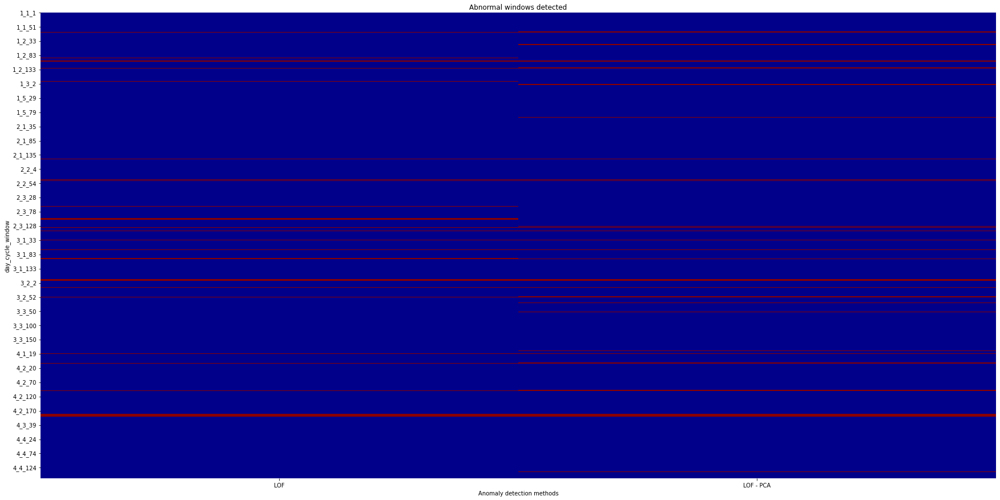

In [40]:
clf_name = 'LOF'
clf = LocalOutlierFactor(n_neighbors=50, contamination=0.05, novelty=True)
is_anomaly_lof, is_anomaly_lof_pca = pca_comparaison(clf_name,clf,df_means,parameters,df_pca,pca_components_kept)

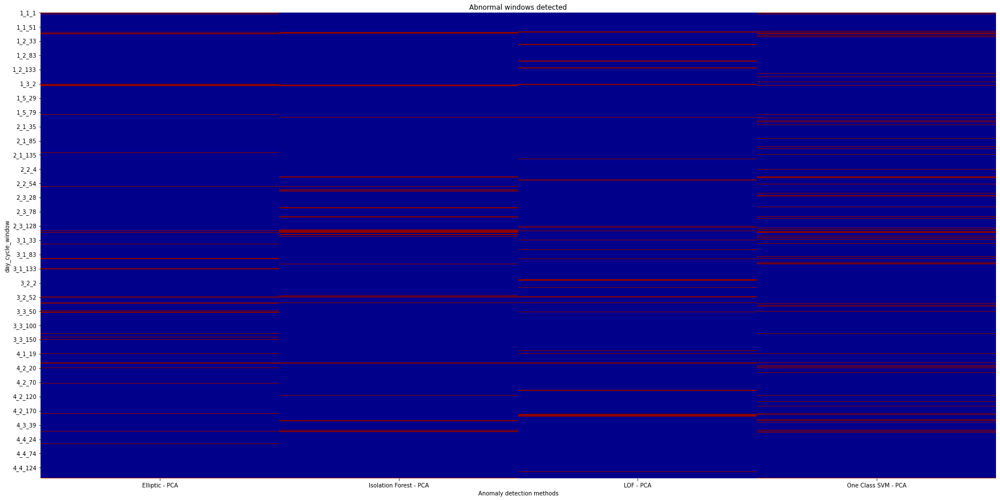

In [42]:
from matplotlib.colors import ListedColormap

# Tested methods
detected_anomalies_by_method = {
    'Elliptic - PCA': is_anomaly_elliptic_pca,
    'Isolation Forest - PCA': is_anomaly_isoforest_pca,
    'LOF - PCA': is_anomaly_lof_pca,
    'One Class SVM - PCA': is_anomaly_oneclasssvm_pca,
}

# Creating dataframe with the results
df_anomalies = pd.DataFrame(detected_anomalies_by_method)

# Displaying method comparaison with a heat map (red line = outlier detected)
plt.figure(figsize=(30, 15))
cmap = ListedColormap(['darkred', 'darkblue'])
sns.heatmap(df_anomalies, cmap=cmap, cbar=False)
plt.title("Abnormal windows detected")
step = 50
ticks_to_display = range(0, len(df_anomalies), step)
labels_to_display = df_means['day_cycle_window'][ticks_to_display]
plt.yticks(ticks=ticks_to_display, labels=labels_to_display, rotation=0)
plt.xlabel("Anomaly detection methods")
plt.ylabel("day_cycle_window")
plt.show()

In [48]:
print(np.intersect1d(np.where(is_anomaly_elliptic_pca==-1),np.intersect1d(np.where(is_anomaly_isoforest_pca==-1),np.intersect1d(np.where(is_anomaly_lof_pca==-1),np.where(is_anomaly_oneclasssvm_pca==-1)))))

[  68  998 1019 1227 1230 1627]
